## Reinforcement Learning Approach
__Policy Gradient__

In [1]:
# Imports 
import json    
import os
import datetime
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import math

import ai.rl_functions as rl
from ai.agents.pg import PG
from ai.stock_trader import StockTrader
print("Imports Complete!")







Imports Complete!


In [2]:
# Attempt number. Used to save the result
attempt_num = 4

### Variables and configuration

In [3]:
# Read config
with open('ai/config.json') as f:
    config = json.load(f)

# Variables
start_date = config['start_date']
end_date = config['end_date']
features = config['features']
codes = config['codes']

# Params
window_length = int(config['window_length'])
epochs = int(config['epochs'])
trainable = config['trainable']
fixed_transaction_cost = float(config['transaction_cost'])
learning_rate = float(config['learning_rate'])

nn_name = "PG-" + str(window_length) + "-" + str(learning_rate) + "-" + str(fixed_transaction_cost)

initial_investment = 1
record_flag = 'True'
plot_flag = 'True'

print("*--------------------Variables-------------------*")
print("Dates: From ", start_date, ' To ', end_date)
print("Codes:", codes)
print('Features:', features)
print("Window_length:", window_length)
print("Epochs:", epochs)
print("Trainable:", trainable)
print("Fixed Transaction Cost: ", fixed_transaction_cost)
print("Learning Rate: ", learning_rate)

*--------------------Variables-------------------*
Dates: From  2017-01-01  To  2020-01-01
Codes: ['BA', 'KO', 'F', 'IBM', 'GE', 'JPM', 'MSFT', 'NKE', 'WMT', 'XOM']
Features: ['Adj Close']
Window_length: 3
Epochs: 1000
Trainable: True
Fixed Transaction Cost:  0.005
Learning Rate:  0.001


## Setup Environment

In [4]:
stocktrader = StockTrader()
PATH_prefix = "result/ai/PG/" + str(attempt_num) + '/'

# Check if number of previous attempt
reload_flag = 'False'
if os.path.exists(PATH_prefix):
    # Reload previous model
    reload_flag = 'True'

In [5]:
# Initialize Environment
from environment import Environment
env = Environment()

# Set Fixed Transaction Cost
env.set_transaction_cost(fixed_transaction_cost)

In [6]:
# Check if config exists for current attempt number
if reload_flag == 'False':
    # Create config
    os.makedirs(PATH_prefix)
    
    # Set up Environment
    train_start_date, train_end_date, test_start_date, test_end_date, codes = env.get_repo(start_date, end_date, len(codes))
    # Get Train Data
    env.get_data(train_start_date, train_end_date, codes, features, window_length = window_length)
    
    # Write
    with open(PATH_prefix + 'config.json', 'w') as json_file:
        json.dump({"train_start_date": train_start_date.strftime('%Y-%m-%d'),
                   "train_end_date": train_end_date.strftime('%Y-%m-%d'),
                   "test_start_date": test_start_date.strftime('%Y-%m-%d'),
                   "test_end_date": test_end_date.strftime('%Y-%m-%d'), "codes": codes}, json_file)
        print("Finished writing config for attempt: ", str(attempt_num))
else:
    # Read/Load previous config
    with open("result/ai/PG/" + str(attempt_num) + '/config.json', 'r') as json_file:
        dict_data = json.load(json_file)
        print("successfully load attempt: ", str(attempt_num), " config")
        
    # Set up Environment based on config
    train_start_date = datetime.datetime.strptime(dict_data['train_start_date'], '%Y-%m-%d')
    train_end_date = datetime.datetime.strptime(dict_data['train_end_date'], '%Y-%m-%d')
    codes = dict_data['codes']
    
    # Get Train Data
    env.get_data(train_start_date, train_end_date, codes, features, window_length = window_length)

Date set count: 502
Finished writing config for attempt:  4


## Train Agent

In [7]:
# Setup Policy Gradient Agent
# M, L, N, name, load_weights, trainable, type, number
agent = PG(len(codes) + 1, int(window_length), len(features), nn_name, reload_flag,
           trainable, attempt_num, lr=learning_rate)




Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Use tf.initializers.variance_scaling instead with distribution=uniform to get equivalent behavior.
Instructions for updating:
Use keras.layers.flatten instead.
Instructions for updating:
Please use `layer.__call__` method instead.
Instructions for updating:
Use keras.layers.Dense instead.







Training with 1000


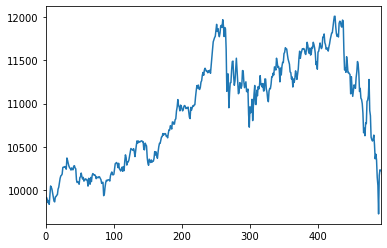

*-----Episode: 0, Reward:102.286258%-----*


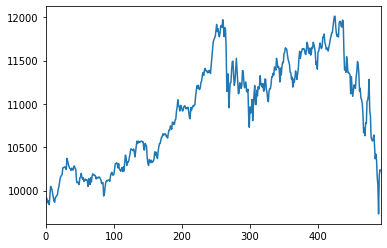

*-----Episode: 1, Reward:102.328540%-----*


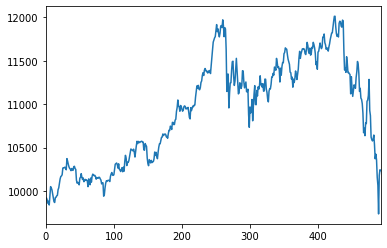

*-----Episode: 2, Reward:102.365991%-----*


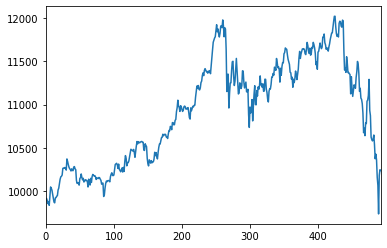

*-----Episode: 3, Reward:102.407979%-----*


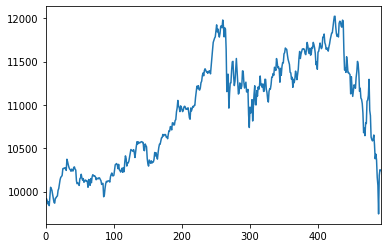

*-----Episode: 4, Reward:102.448107%-----*


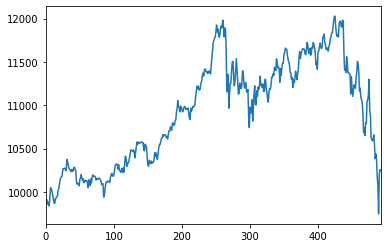

*-----Episode: 5, Reward:102.494273%-----*


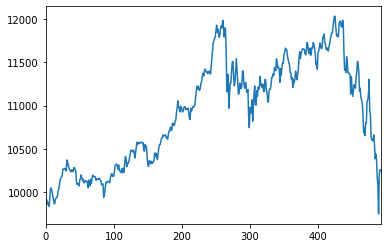

*-----Episode: 6, Reward:102.532547%-----*


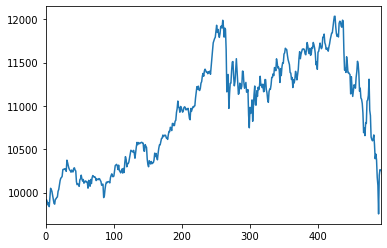

*-----Episode: 7, Reward:102.572716%-----*


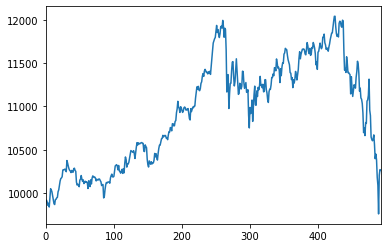

*-----Episode: 8, Reward:102.623064%-----*


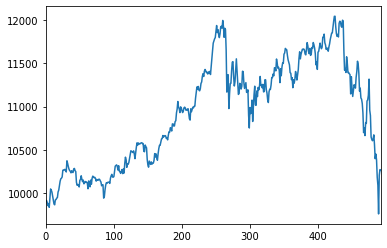

*-----Episode: 9, Reward:102.656458%-----*


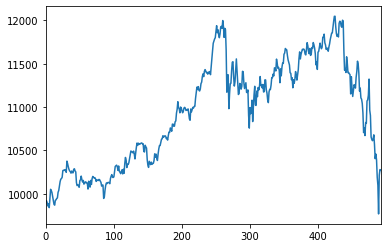

*-----Episode: 10, Reward:102.700417%-----*
Instructions for updating:
Use standard file APIs to delete files with this prefix.


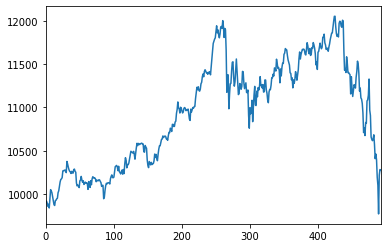

*-----Episode: 11, Reward:102.743251%-----*


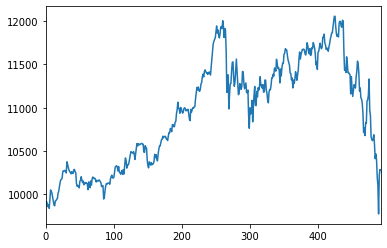

*-----Episode: 12, Reward:102.787605%-----*


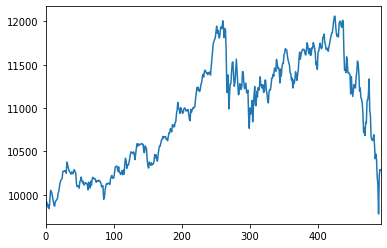

*-----Episode: 13, Reward:102.828191%-----*


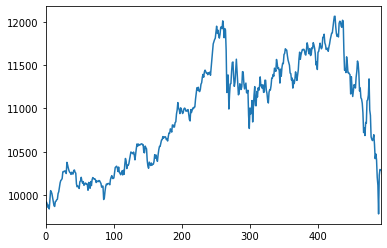

*-----Episode: 14, Reward:102.864628%-----*


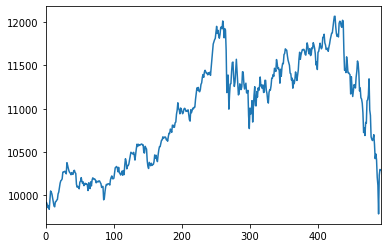

*-----Episode: 15, Reward:102.908626%-----*


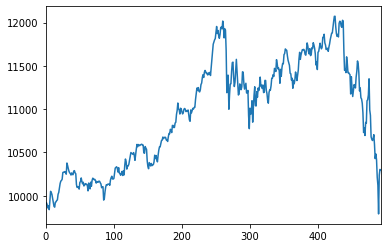

*-----Episode: 16, Reward:102.952633%-----*


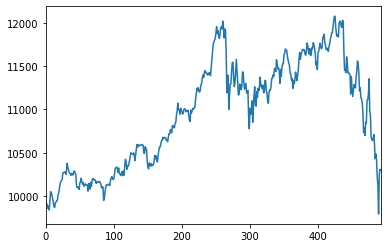

*-----Episode: 17, Reward:102.993242%-----*


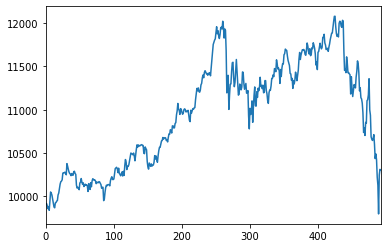

*-----Episode: 18, Reward:103.033856%-----*


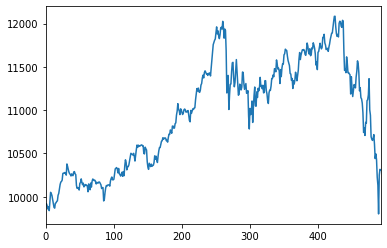

*-----Episode: 19, Reward:103.077882%-----*


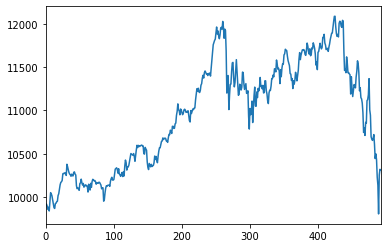

*-----Episode: 20, Reward:103.118506%-----*


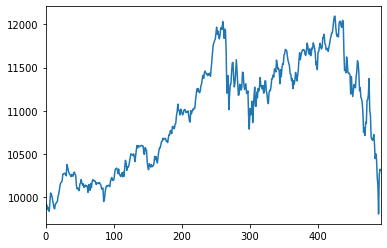

*-----Episode: 21, Reward:103.161407%-----*


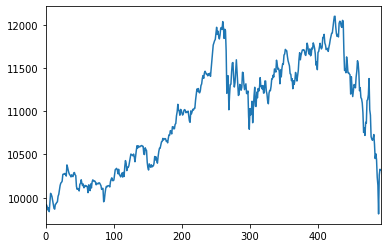

*-----Episode: 22, Reward:103.203935%-----*


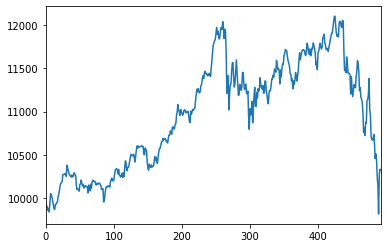

*-----Episode: 23, Reward:103.242675%-----*


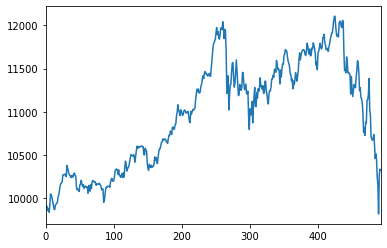

*-----Episode: 24, Reward:103.285211%-----*


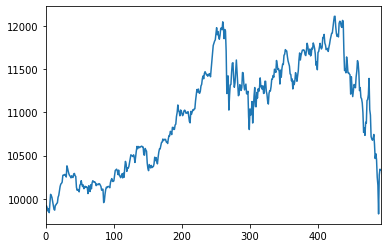

*-----Episode: 25, Reward:103.330028%-----*


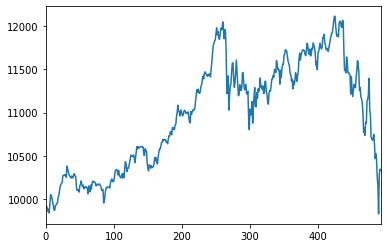

*-----Episode: 26, Reward:103.367257%-----*


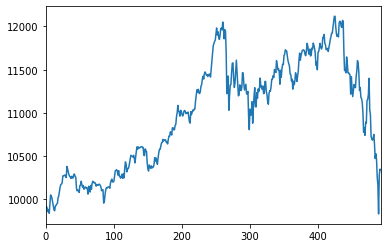

*-----Episode: 27, Reward:103.410184%-----*


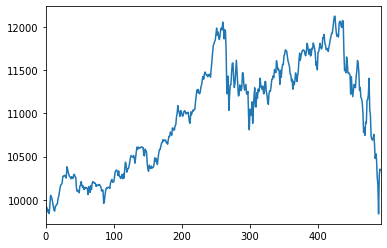

*-----Episode: 28, Reward:103.454631%-----*


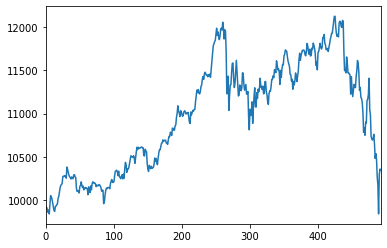

*-----Episode: 29, Reward:103.495279%-----*


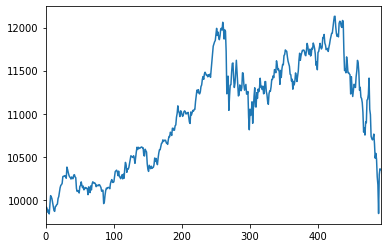

*-----Episode: 30, Reward:103.536308%-----*


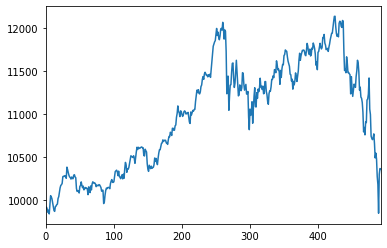

*-----Episode: 31, Reward:103.575819%-----*


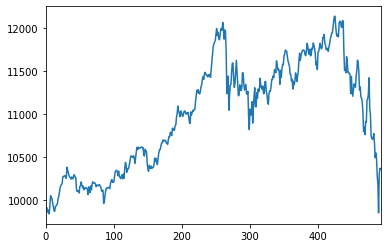

*-----Episode: 32, Reward:103.619134%-----*


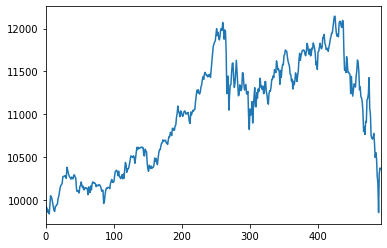

*-----Episode: 33, Reward:103.659788%-----*


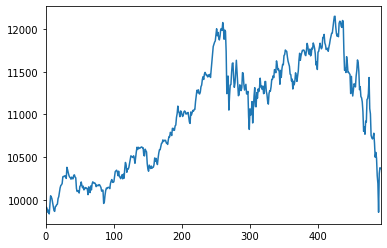

*-----Episode: 34, Reward:103.701205%-----*


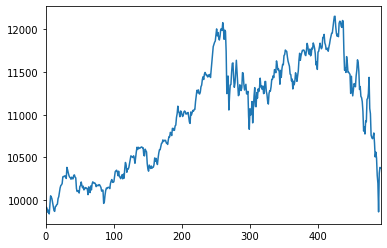

*-----Episode: 35, Reward:103.747577%-----*


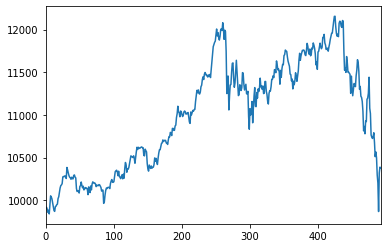

*-----Episode: 36, Reward:103.788997%-----*


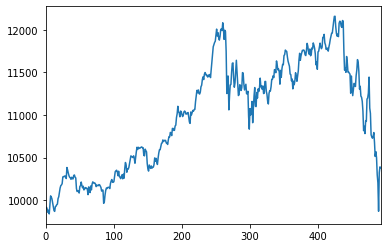

*-----Episode: 37, Reward:103.827751%-----*


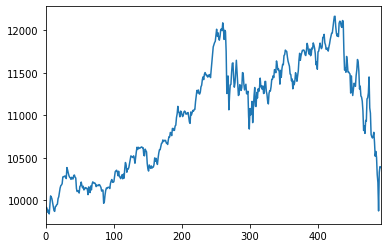

*-----Episode: 38, Reward:103.871081%-----*


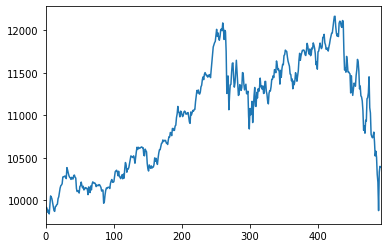

*-----Episode: 39, Reward:103.910980%-----*


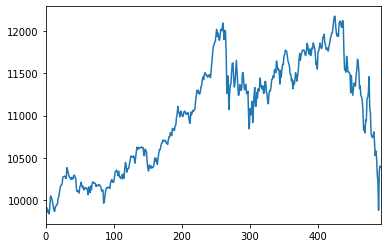

*-----Episode: 40, Reward:103.952405%-----*


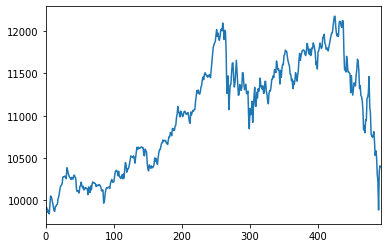

*-----Episode: 41, Reward:103.991539%-----*


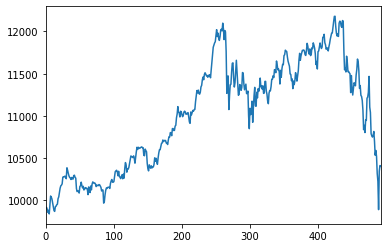

*-----Episode: 42, Reward:104.037931%-----*


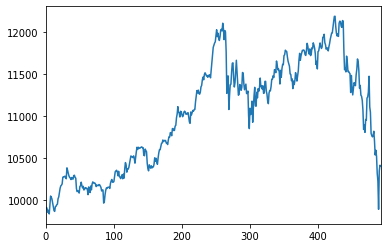

*-----Episode: 43, Reward:104.078213%-----*


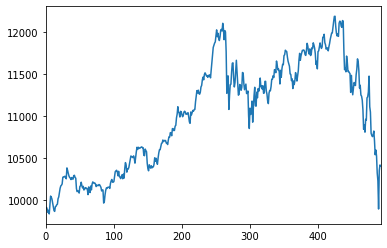

*-----Episode: 44, Reward:104.121553%-----*


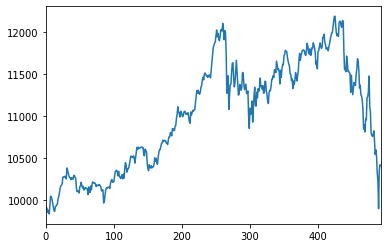

*-----Episode: 45, Reward:104.160687%-----*


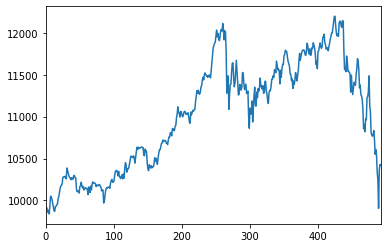

*-----Episode: 46, Reward:104.204795%-----*


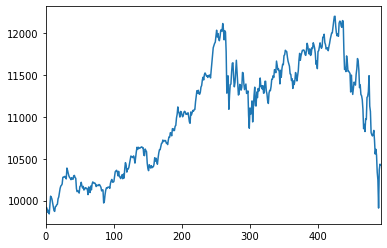

*-----Episode: 47, Reward:104.248905%-----*


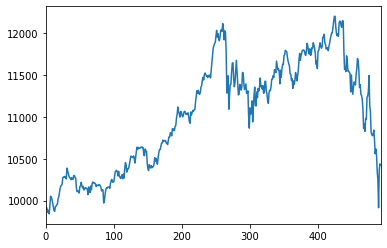

*-----Episode: 48, Reward:104.292252%-----*


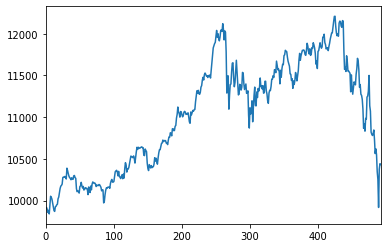

*-----Episode: 49, Reward:104.331001%-----*


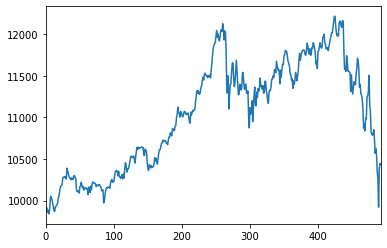

*-----Episode: 50, Reward:104.374731%-----*


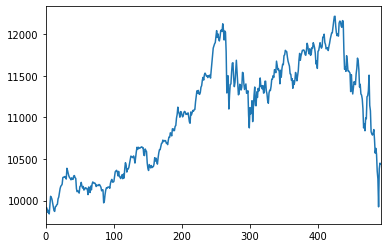

*-----Episode: 51, Reward:104.414243%-----*


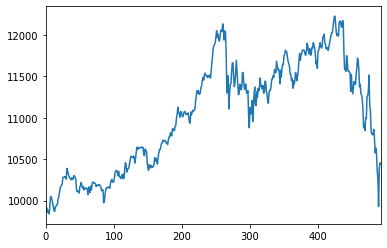

*-----Episode: 52, Reward:104.455668%-----*


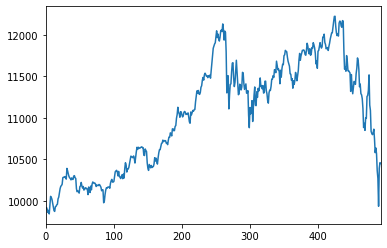

*-----Episode: 53, Reward:104.494789%-----*


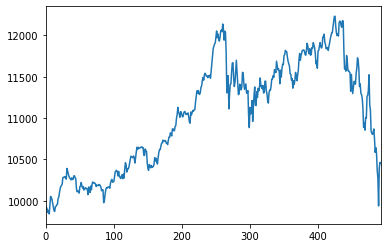

*-----Episode: 54, Reward:104.539666%-----*


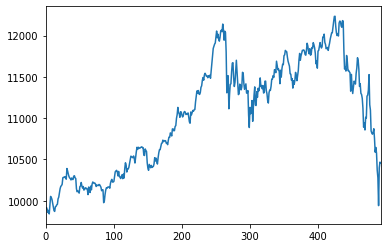

*-----Episode: 55, Reward:104.580702%-----*


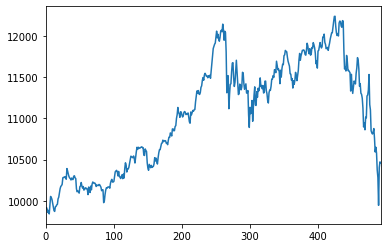

*-----Episode: 56, Reward:104.620202%-----*


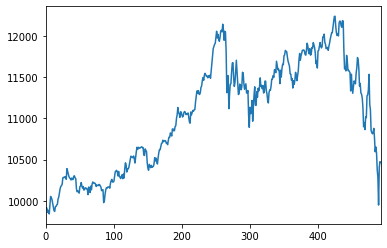

*-----Episode: 57, Reward:104.661237%-----*


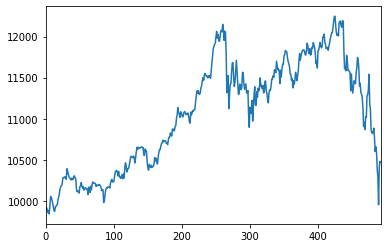

*-----Episode: 58, Reward:104.707654%-----*


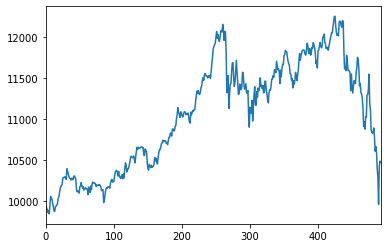

*-----Episode: 59, Reward:104.750609%-----*


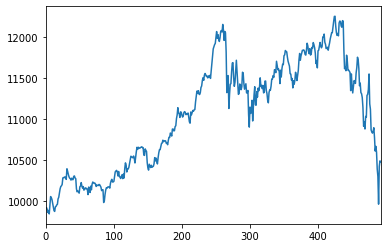

*-----Episode: 60, Reward:104.788563%-----*


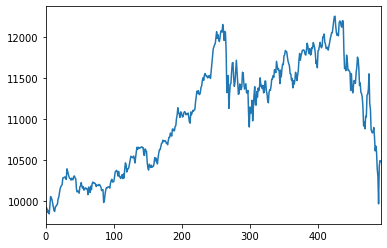

*-----Episode: 61, Reward:104.831131%-----*


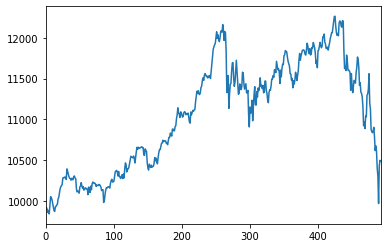

*-----Episode: 62, Reward:104.876781%-----*


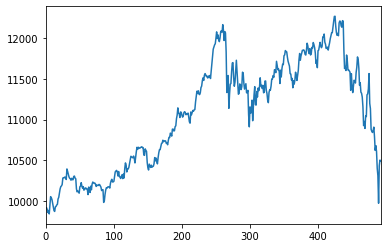

*-----Episode: 63, Reward:104.917808%-----*


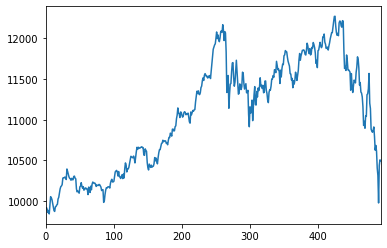

*-----Episode: 64, Reward:104.957678%-----*


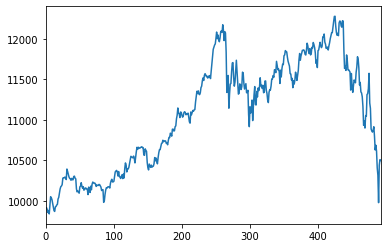

*-----Episode: 65, Reward:104.997159%-----*


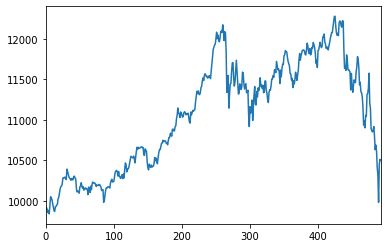

*-----Episode: 66, Reward:105.039721%-----*


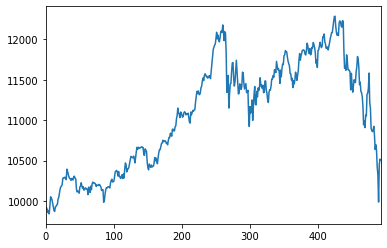

*-----Episode: 67, Reward:105.087300%-----*


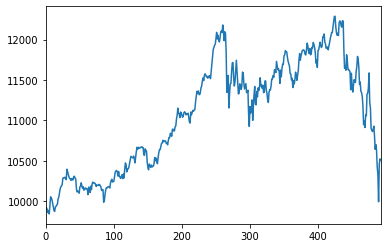

*-----Episode: 68, Reward:105.124072%-----*


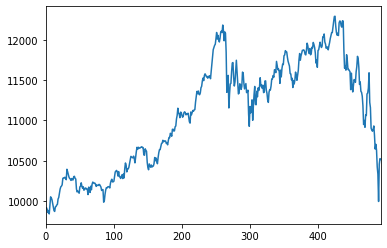

*-----Episode: 69, Reward:105.169717%-----*


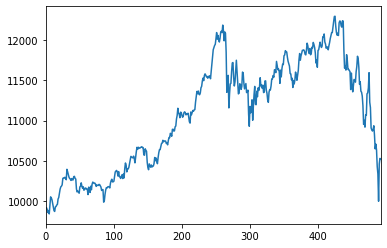

*-----Episode: 70, Reward:105.206861%-----*


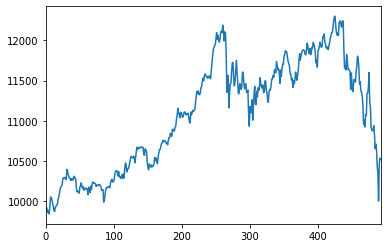

*-----Episode: 71, Reward:105.245546%-----*


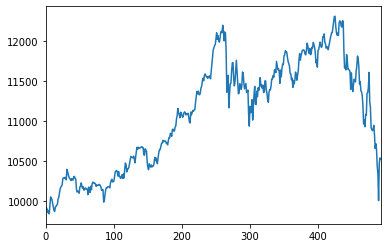

*-----Episode: 72, Reward:105.291573%-----*


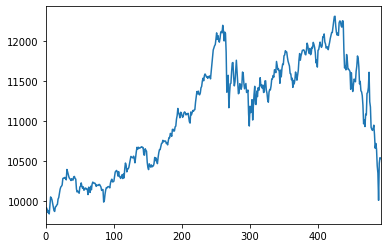

*-----Episode: 73, Reward:105.336829%-----*


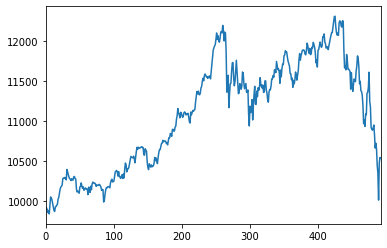

*-----Episode: 74, Reward:105.372412%-----*


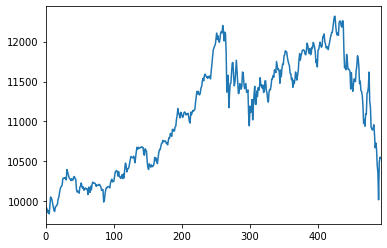

*-----Episode: 75, Reward:105.418054%-----*


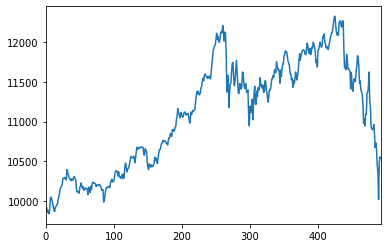

*-----Episode: 76, Reward:105.458275%-----*


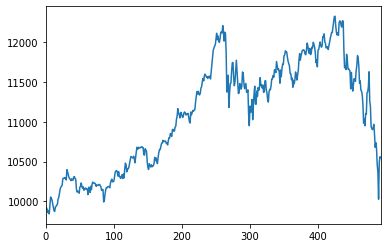

*-----Episode: 77, Reward:105.503918%-----*


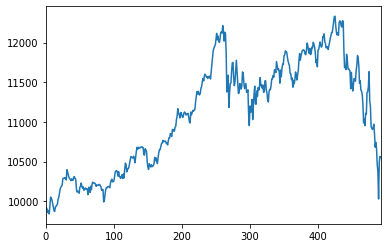

*-----Episode: 78, Reward:105.539865%-----*


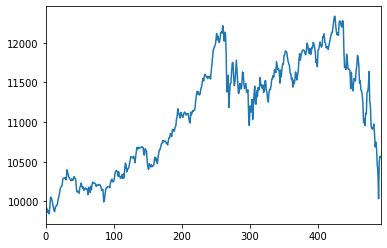

*-----Episode: 79, Reward:105.586662%-----*


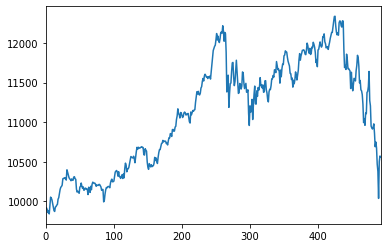

*-----Episode: 80, Reward:105.624540%-----*


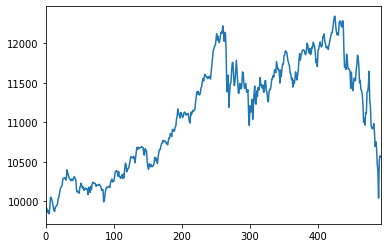

*-----Episode: 81, Reward:105.672500%-----*


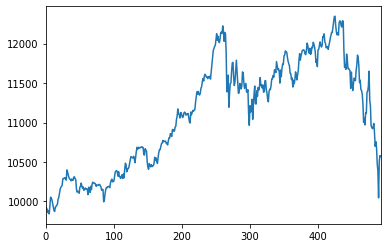

*-----Episode: 82, Reward:105.708039%-----*


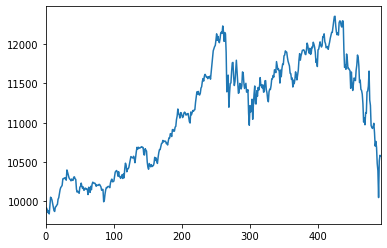

*-----Episode: 83, Reward:105.751338%-----*


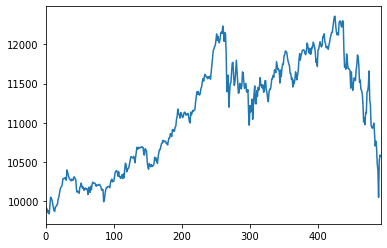

*-----Episode: 84, Reward:105.789196%-----*


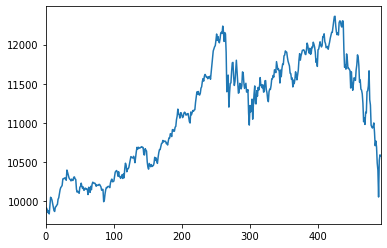

*-----Episode: 85, Reward:105.835597%-----*


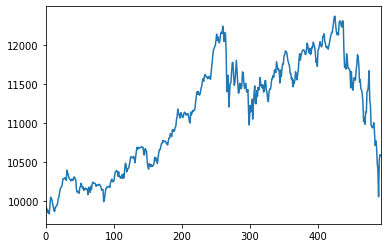

*-----Episode: 86, Reward:105.877721%-----*


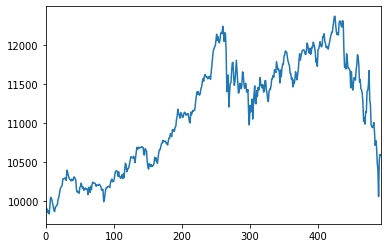

*-----Episode: 87, Reward:105.914397%-----*


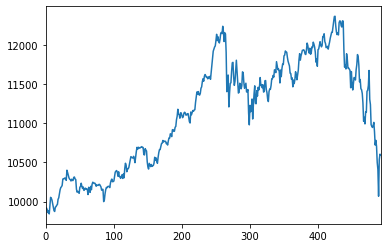

*-----Episode: 88, Reward:105.959238%-----*


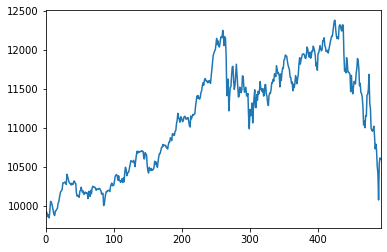

*-----Episode: 89, Reward:106.001740%-----*


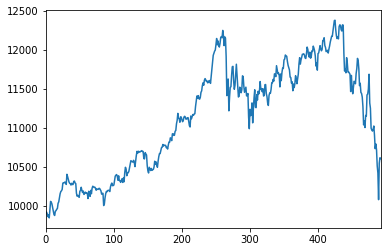

*-----Episode: 90, Reward:106.043850%-----*


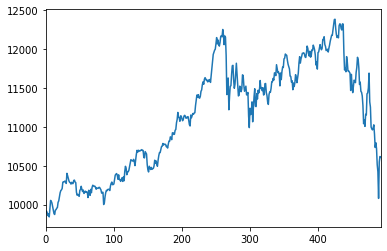

*-----Episode: 91, Reward:106.085568%-----*


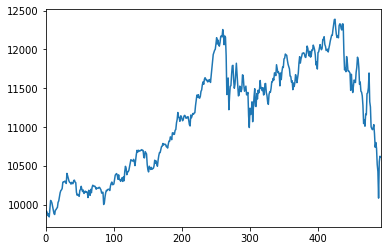

*-----Episode: 92, Reward:106.131957%-----*


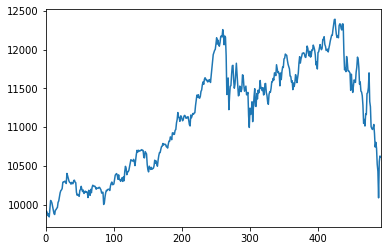

*-----Episode: 93, Reward:106.172887%-----*


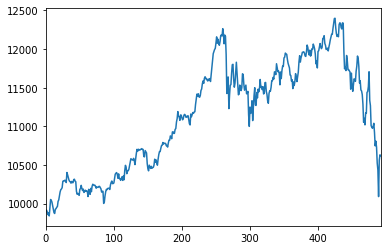

*-----Episode: 94, Reward:106.210693%-----*


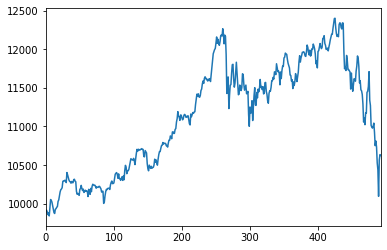

*-----Episode: 95, Reward:106.251612%-----*


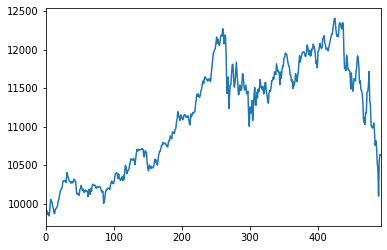

*-----Episode: 96, Reward:106.291355%-----*


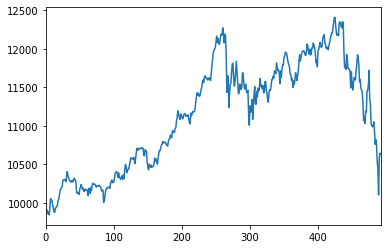

*-----Episode: 97, Reward:106.333827%-----*


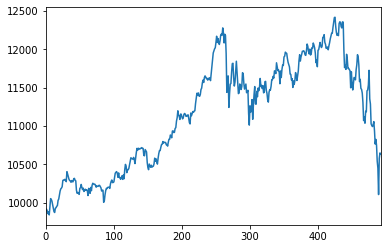

*-----Episode: 98, Reward:106.375511%-----*


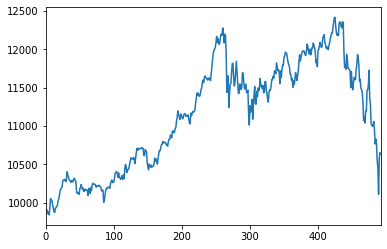

*-----Episode: 99, Reward:106.421491%-----*


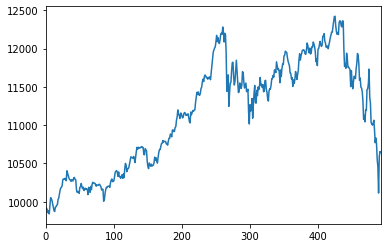

*-----Episode: 100, Reward:106.459651%-----*


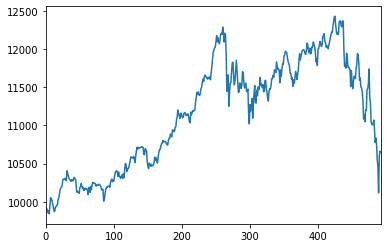

*-----Episode: 101, Reward:106.500539%-----*


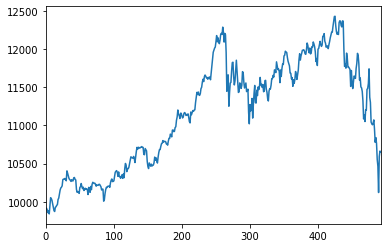

*-----Episode: 102, Reward:106.541422%-----*


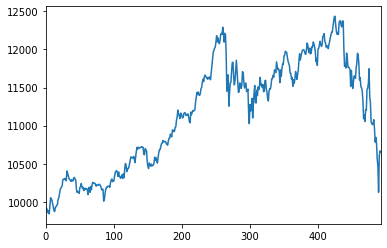

*-----Episode: 103, Reward:106.582687%-----*


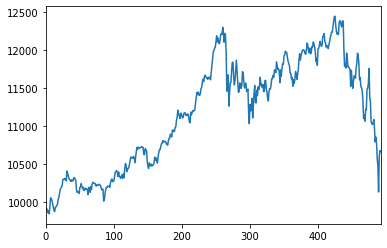

*-----Episode: 104, Reward:106.631778%-----*


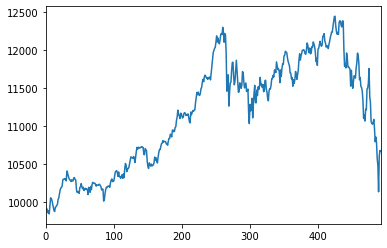

*-----Episode: 105, Reward:106.665590%-----*


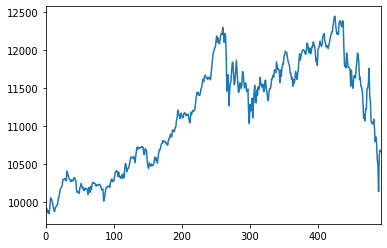

*-----Episode: 106, Reward:106.708796%-----*


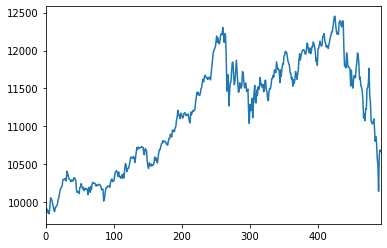

*-----Episode: 107, Reward:106.754740%-----*


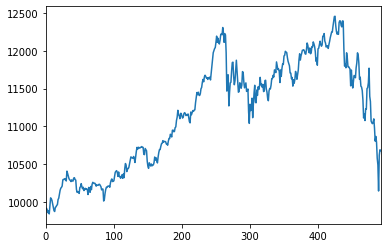

*-----Episode: 108, Reward:106.794800%-----*


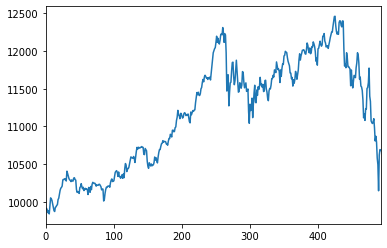

*-----Episode: 109, Reward:106.832890%-----*


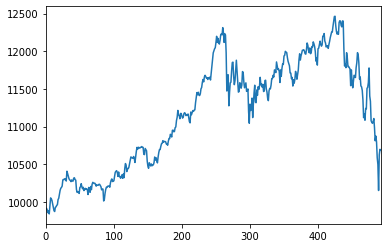

*-----Episode: 110, Reward:106.878037%-----*


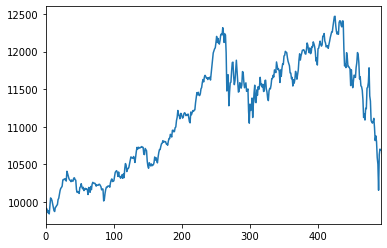

*-----Episode: 111, Reward:106.923963%-----*


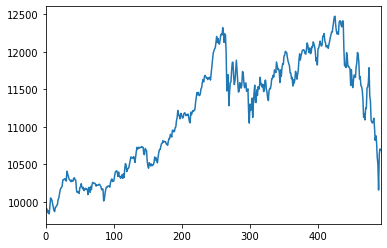

*-----Episode: 112, Reward:106.958887%-----*


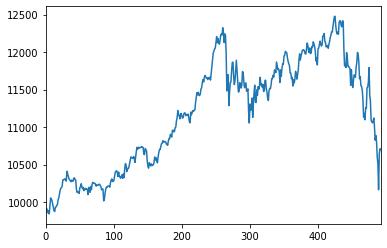

*-----Episode: 113, Reward:107.002836%-----*


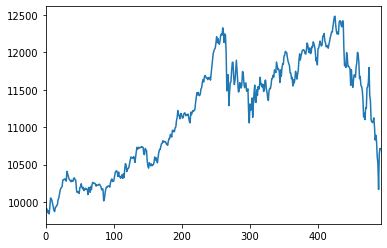

*-----Episode: 114, Reward:107.044027%-----*


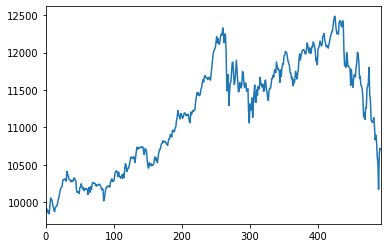

*-----Episode: 115, Reward:107.082456%-----*


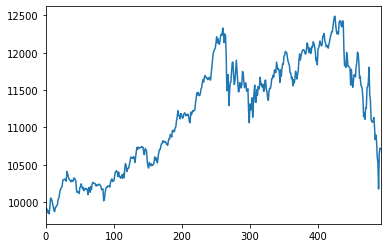

*-----Episode: 116, Reward:107.124812%-----*


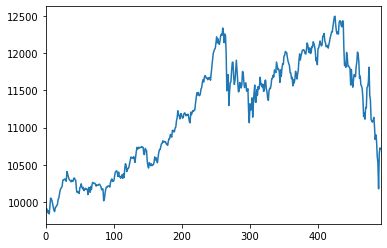

*-----Episode: 117, Reward:107.165193%-----*


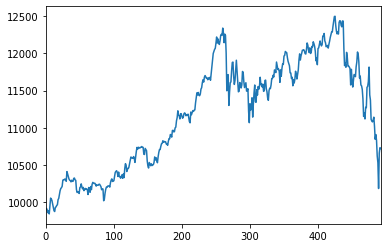

*-----Episode: 118, Reward:107.211865%-----*


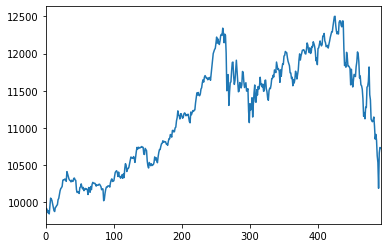

*-----Episode: 119, Reward:107.252626%-----*


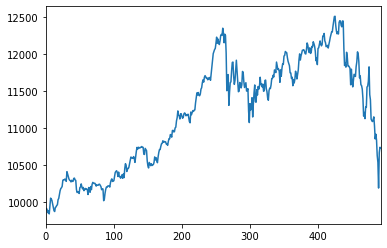

*-----Episode: 120, Reward:107.291408%-----*


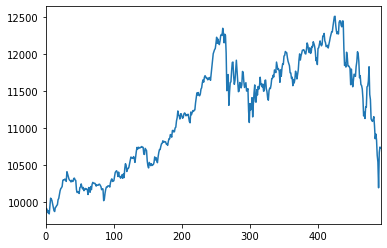

*-----Episode: 121, Reward:107.336881%-----*


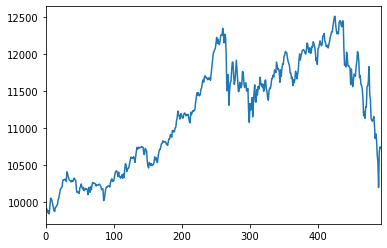

*-----Episode: 122, Reward:107.380774%-----*


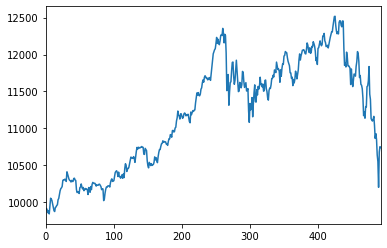

*-----Episode: 123, Reward:107.416376%-----*


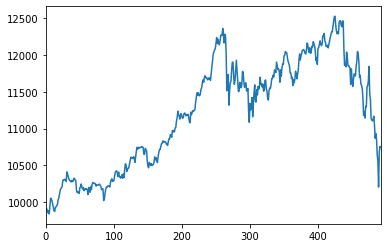

*-----Episode: 124, Reward:107.458674%-----*


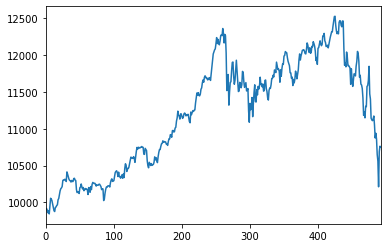

*-----Episode: 125, Reward:107.506493%-----*


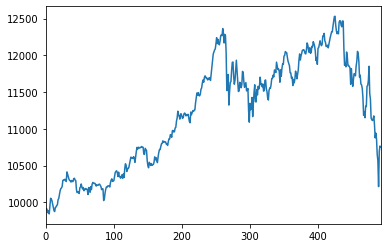

*-----Episode: 126, Reward:107.538501%-----*


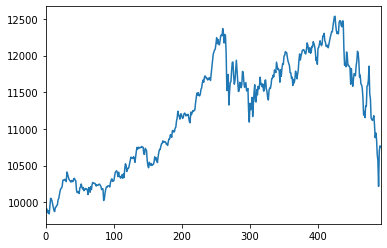

*-----Episode: 127, Reward:107.581949%-----*


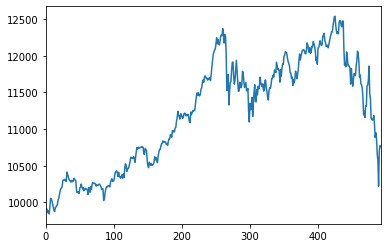

*-----Episode: 128, Reward:107.622228%-----*


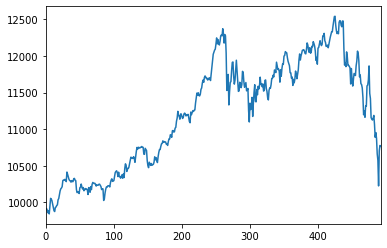

*-----Episode: 129, Reward:107.664474%-----*


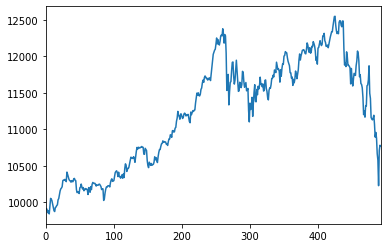

*-----Episode: 130, Reward:107.704337%-----*


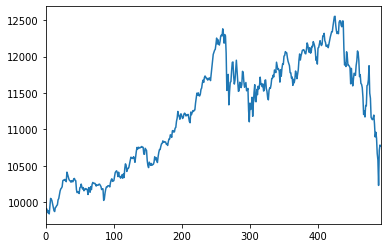

*-----Episode: 131, Reward:107.748936%-----*


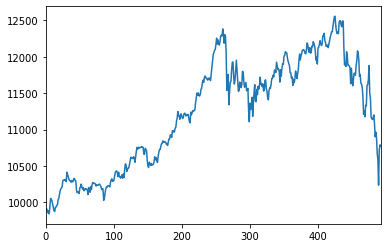

*-----Episode: 132, Reward:107.793133%-----*


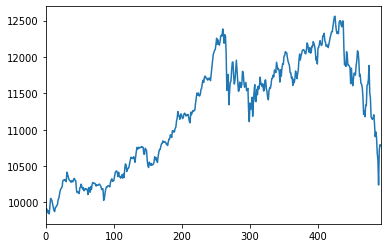

*-----Episode: 133, Reward:107.829797%-----*


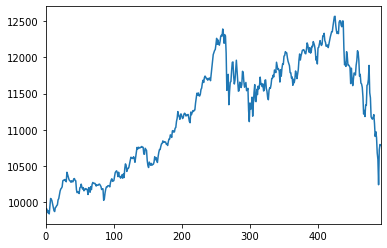

*-----Episode: 134, Reward:107.872787%-----*


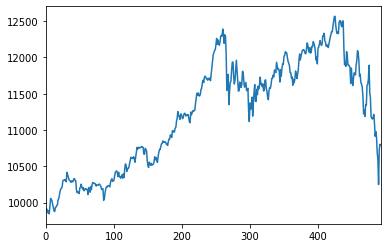

*-----Episode: 135, Reward:107.911013%-----*


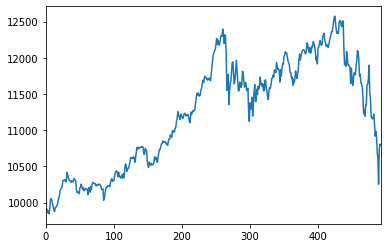

*-----Episode: 136, Reward:107.959135%-----*


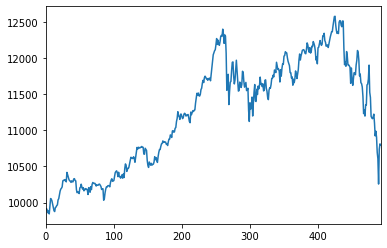

*-----Episode: 137, Reward:107.997729%-----*


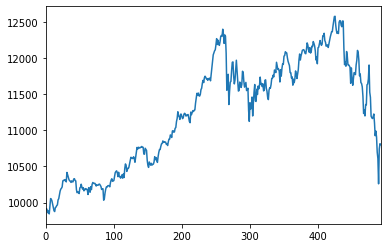

*-----Episode: 138, Reward:108.038293%-----*


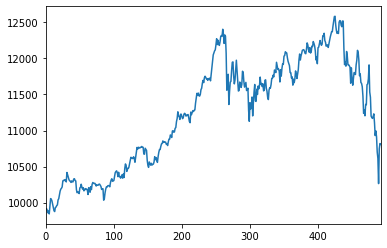

*-----Episode: 139, Reward:108.076865%-----*


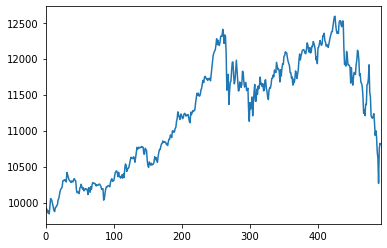

*-----Episode: 140, Reward:108.117807%-----*


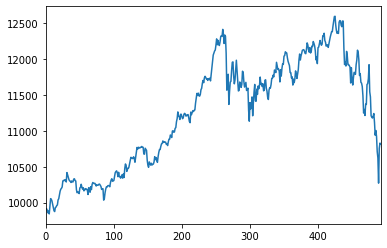

*-----Episode: 141, Reward:108.165093%-----*


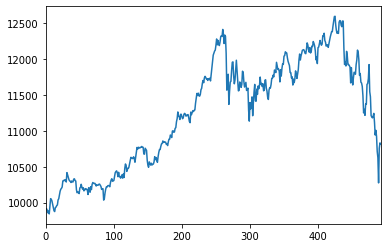

*-----Episode: 142, Reward:108.206813%-----*


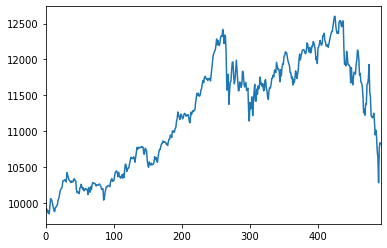

*-----Episode: 143, Reward:108.243356%-----*


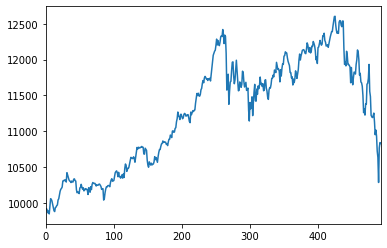

*-----Episode: 144, Reward:108.283464%-----*


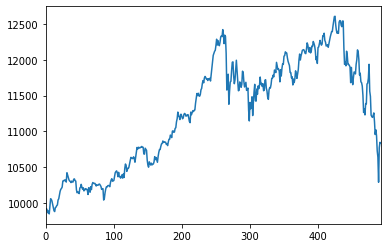

*-----Episode: 145, Reward:108.334700%-----*


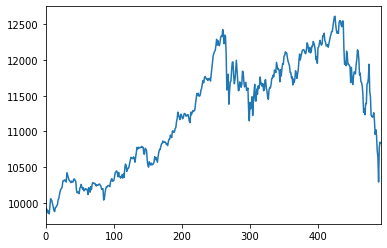

*-----Episode: 146, Reward:108.369221%-----*


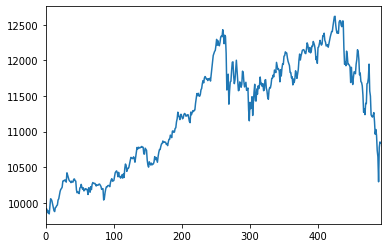

*-----Episode: 147, Reward:108.413281%-----*


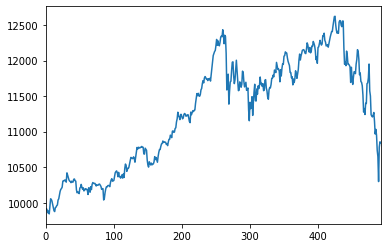

*-----Episode: 148, Reward:108.450563%-----*


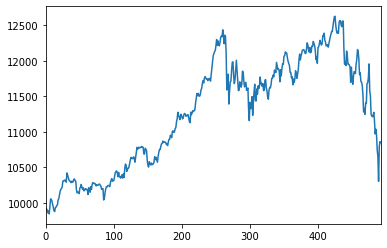

*-----Episode: 149, Reward:108.493411%-----*


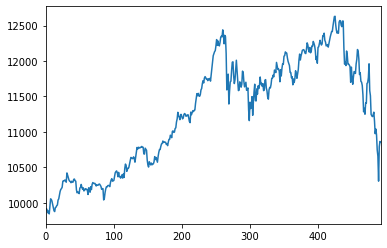

*-----Episode: 150, Reward:108.536241%-----*


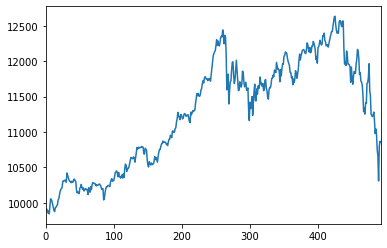

*-----Episode: 151, Reward:108.570690%-----*


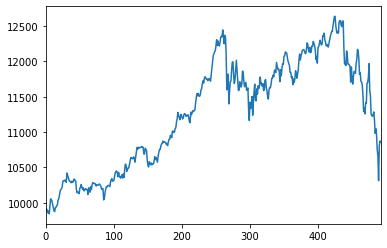

*-----Episode: 152, Reward:108.617088%-----*


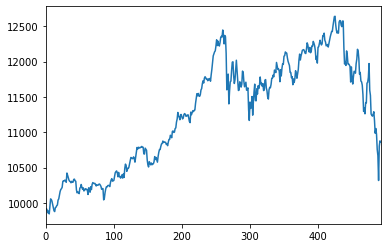

*-----Episode: 153, Reward:108.655499%-----*


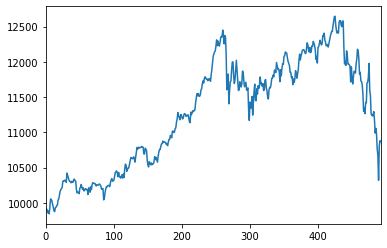

*-----Episode: 154, Reward:108.698288%-----*


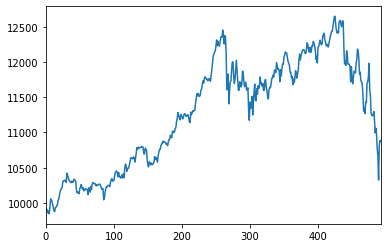

*-----Episode: 155, Reward:108.741469%-----*


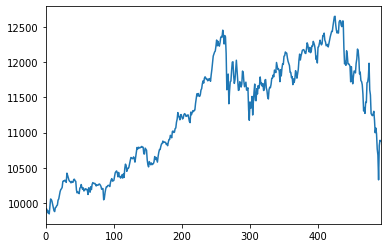

*-----Episode: 156, Reward:108.781044%-----*


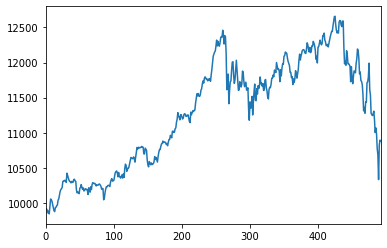

*-----Episode: 157, Reward:108.824604%-----*


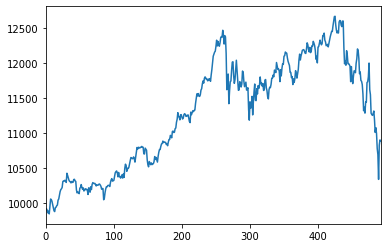

*-----Episode: 158, Reward:108.864956%-----*


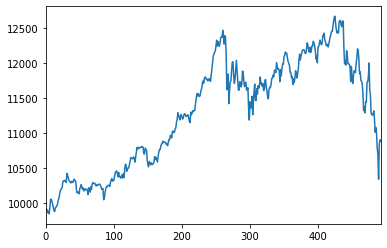

*-----Episode: 159, Reward:108.907297%-----*


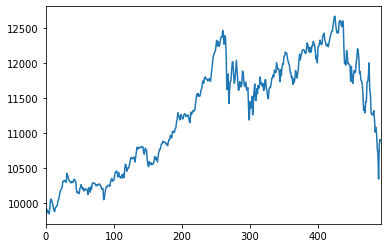

*-----Episode: 160, Reward:108.946426%-----*


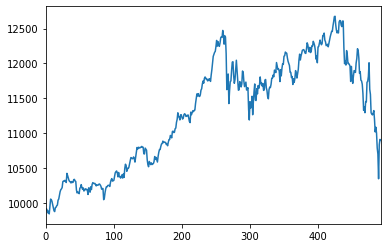

*-----Episode: 161, Reward:108.987547%-----*


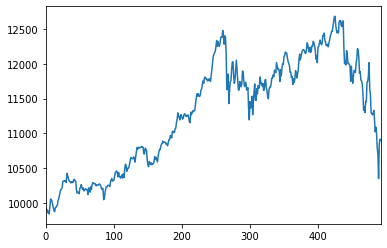

*-----Episode: 162, Reward:109.031056%-----*


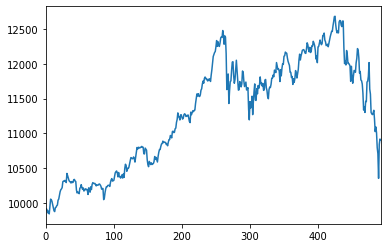

*-----Episode: 163, Reward:109.068149%-----*


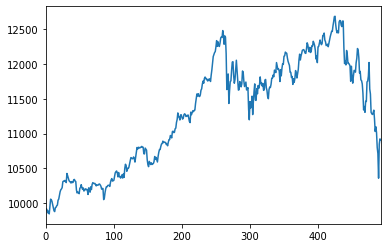

*-----Episode: 164, Reward:109.104829%-----*


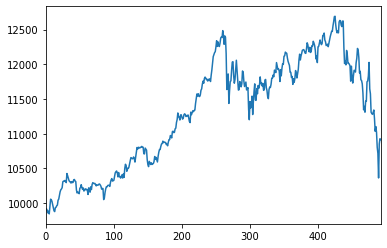

*-----Episode: 165, Reward:109.149109%-----*


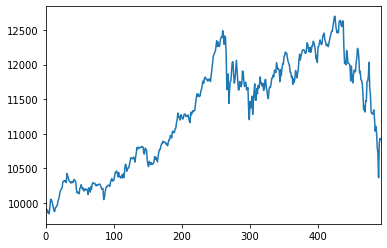

*-----Episode: 166, Reward:109.196187%-----*


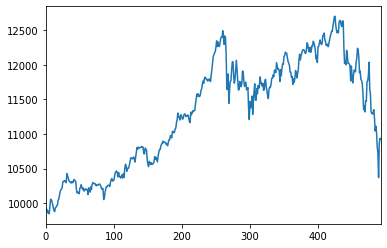

*-----Episode: 167, Reward:109.231226%-----*


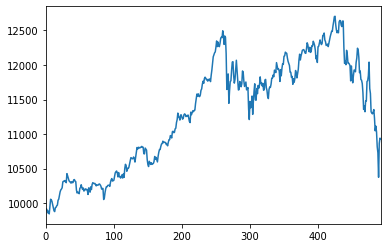

*-----Episode: 168, Reward:109.279492%-----*


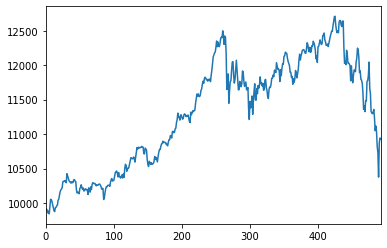

*-----Episode: 169, Reward:109.314905%-----*


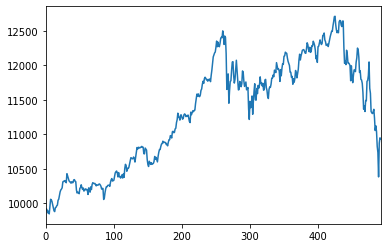

*-----Episode: 170, Reward:109.355522%-----*


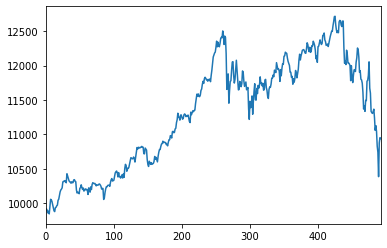

*-----Episode: 171, Reward:109.400146%-----*


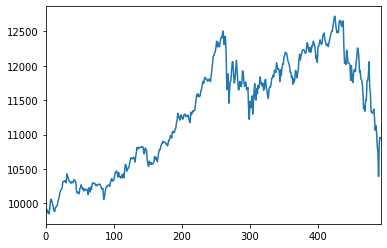

*-----Episode: 172, Reward:109.441948%-----*


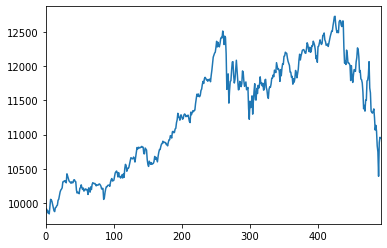

*-----Episode: 173, Reward:109.481327%-----*


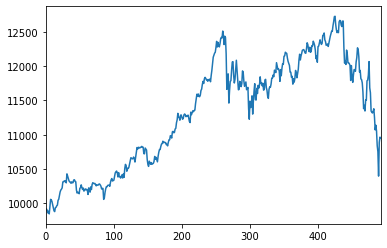

*-----Episode: 174, Reward:109.517477%-----*


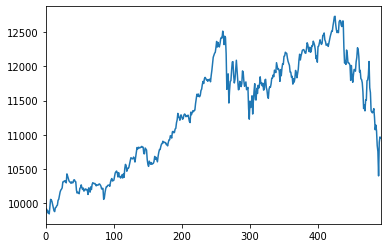

*-----Episode: 175, Reward:109.561254%-----*


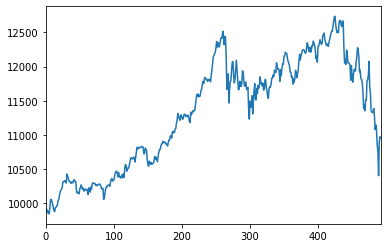

*-----Episode: 176, Reward:109.601803%-----*


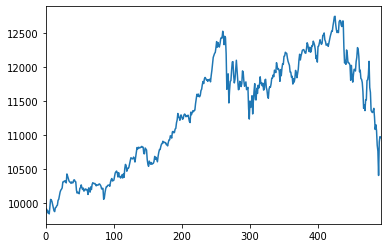

*-----Episode: 177, Reward:109.644353%-----*


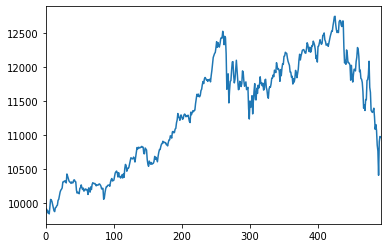

*-----Episode: 178, Reward:109.683671%-----*


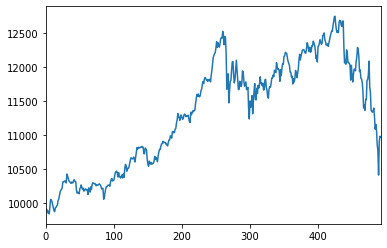

*-----Episode: 179, Reward:109.729019%-----*


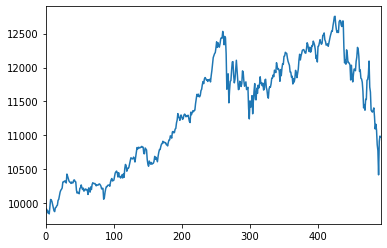

*-----Episode: 180, Reward:109.772746%-----*


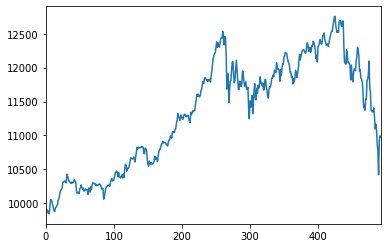

*-----Episode: 181, Reward:109.801544%-----*


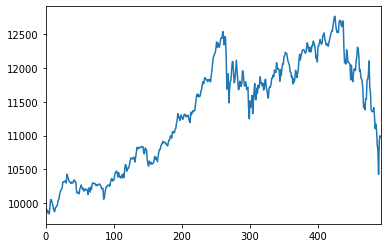

*-----Episode: 182, Reward:109.848875%-----*


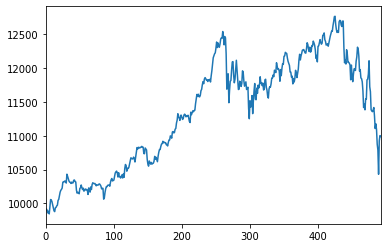

*-----Episode: 183, Reward:109.892970%-----*


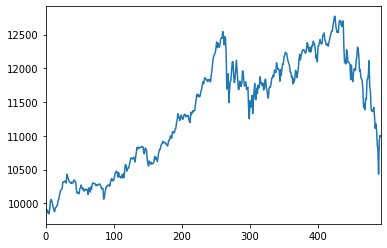

*-----Episode: 184, Reward:109.927358%-----*


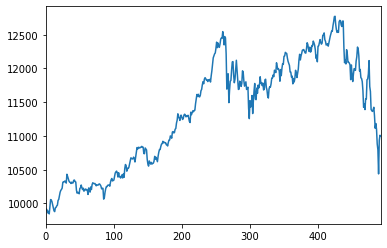

*-----Episode: 185, Reward:109.968999%-----*


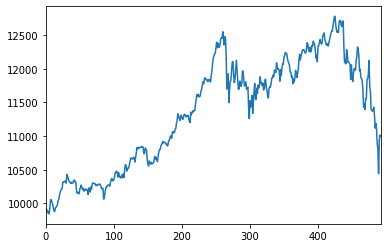

*-----Episode: 186, Reward:110.012645%-----*


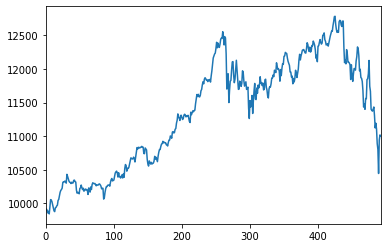

*-----Episode: 187, Reward:110.053453%-----*


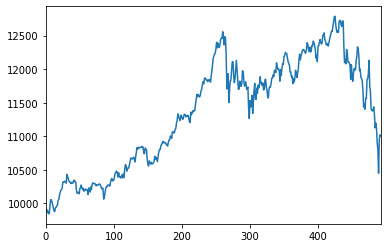

*-----Episode: 188, Reward:110.091823%-----*


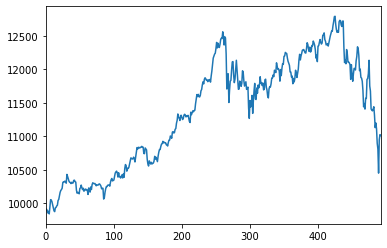

*-----Episode: 189, Reward:110.133007%-----*


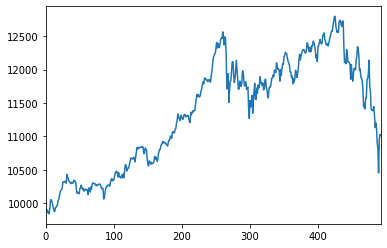

*-----Episode: 190, Reward:110.172562%-----*


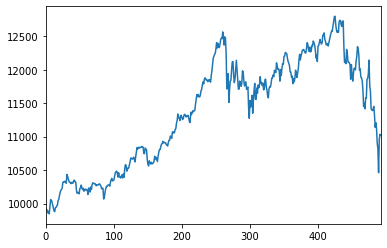

*-----Episode: 191, Reward:110.214124%-----*


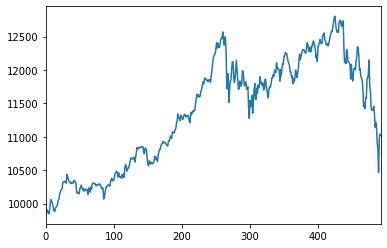

*-----Episode: 192, Reward:110.256078%-----*


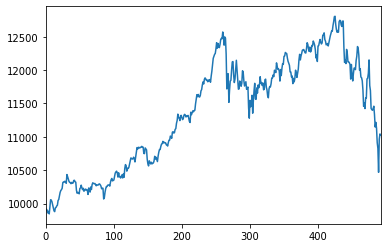

*-----Episode: 193, Reward:110.300042%-----*


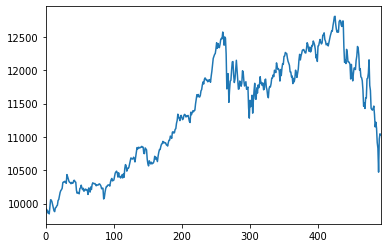

*-----Episode: 194, Reward:110.341557%-----*


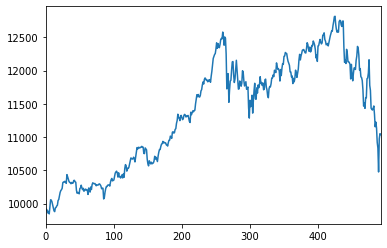

*-----Episode: 195, Reward:110.376976%-----*


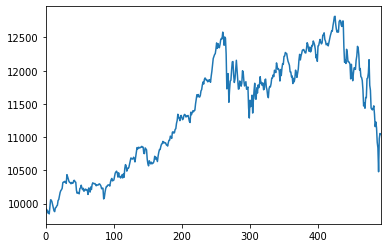

*-----Episode: 196, Reward:110.420079%-----*


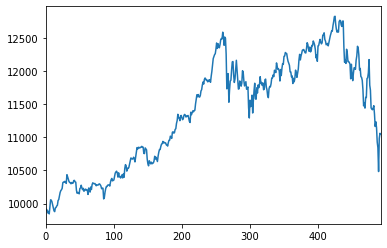

*-----Episode: 197, Reward:110.463573%-----*


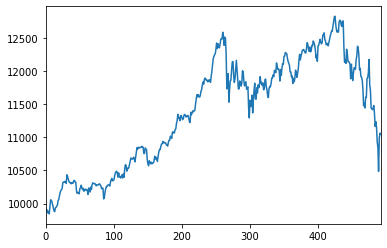

*-----Episode: 198, Reward:110.500156%-----*


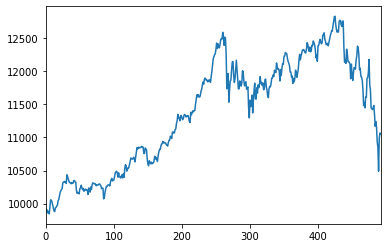

*-----Episode: 199, Reward:110.536721%-----*


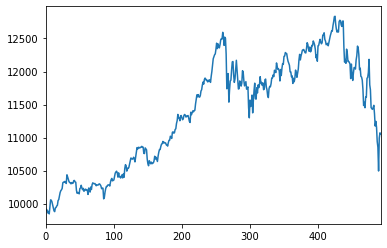

*-----Episode: 200, Reward:110.585043%-----*


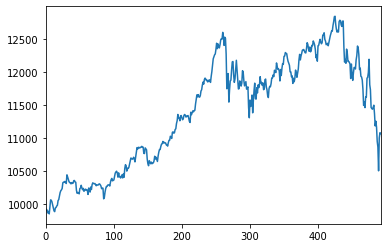

*-----Episode: 201, Reward:110.622794%-----*


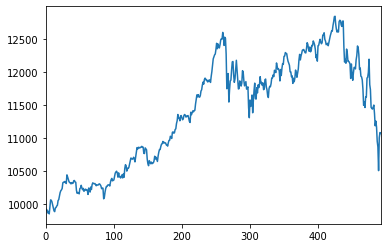

*-----Episode: 202, Reward:110.662967%-----*


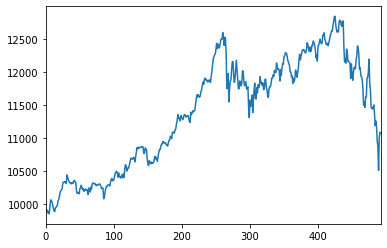

*-----Episode: 203, Reward:110.707190%-----*


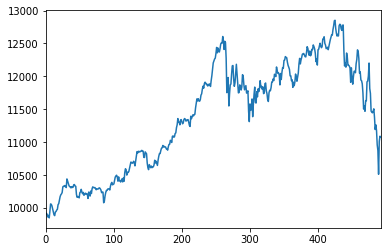

*-----Episode: 204, Reward:110.742860%-----*


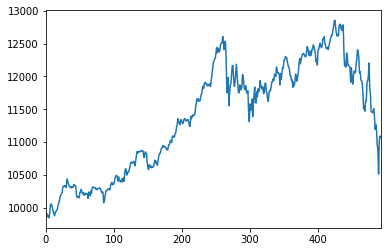

*-----Episode: 205, Reward:110.781767%-----*


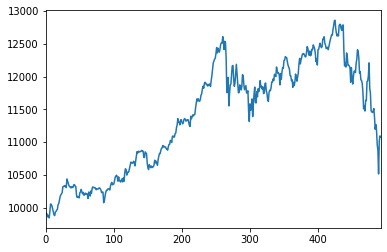

*-----Episode: 206, Reward:110.825135%-----*


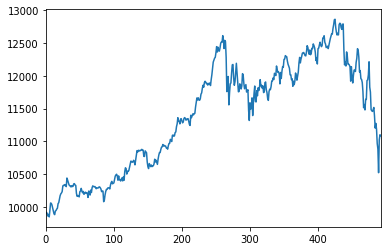

*-----Episode: 207, Reward:110.865642%-----*


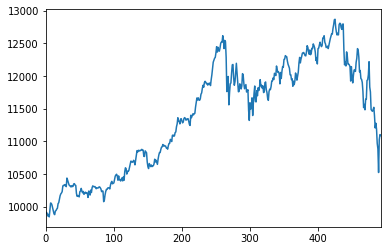

*-----Episode: 208, Reward:110.907762%-----*


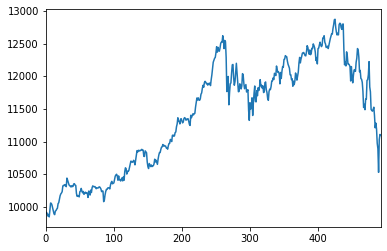

*-----Episode: 209, Reward:110.945388%-----*


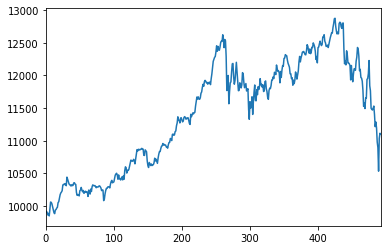

*-----Episode: 210, Reward:110.991150%-----*


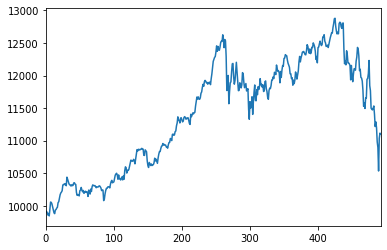

*-----Episode: 211, Reward:111.024670%-----*


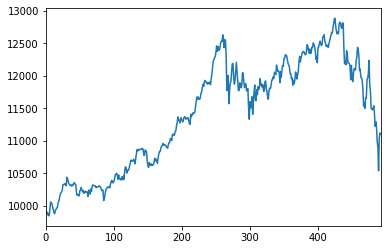

*-----Episode: 212, Reward:111.070403%-----*


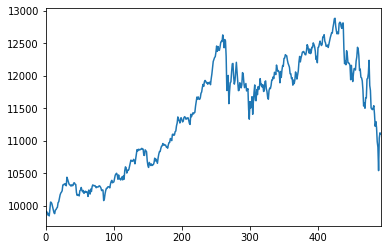

*-----Episode: 213, Reward:111.108784%-----*


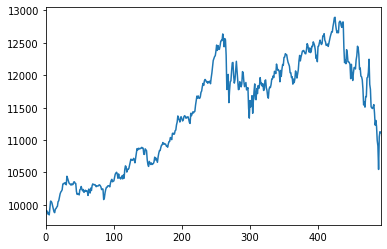

*-----Episode: 214, Reward:111.147559%-----*


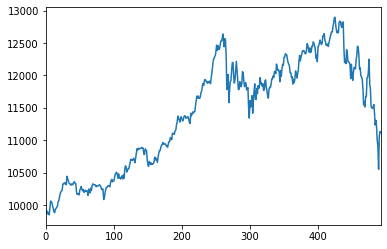

*-----Episode: 215, Reward:111.188357%-----*


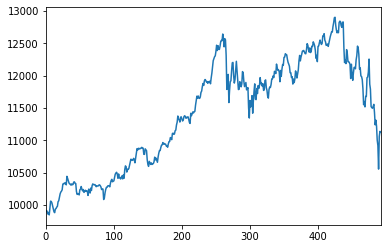

*-----Episode: 216, Reward:111.231185%-----*


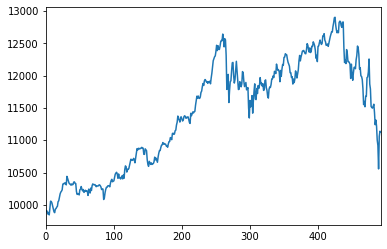

*-----Episode: 217, Reward:111.271140%-----*


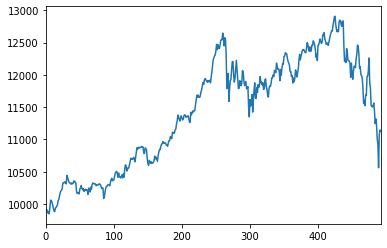

*-----Episode: 218, Reward:111.310263%-----*


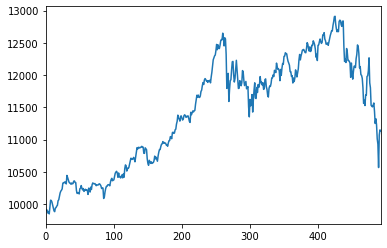

*-----Episode: 219, Reward:111.352640%-----*


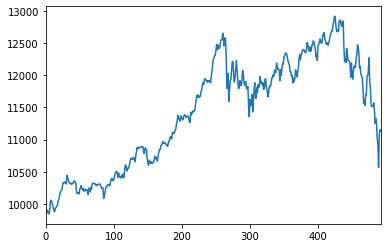

*-----Episode: 220, Reward:111.393369%-----*


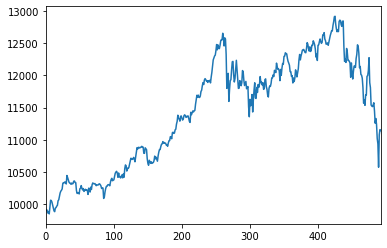

*-----Episode: 221, Reward:111.429583%-----*


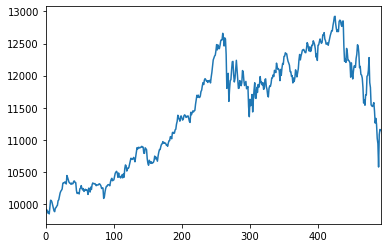

*-----Episode: 222, Reward:111.471920%-----*


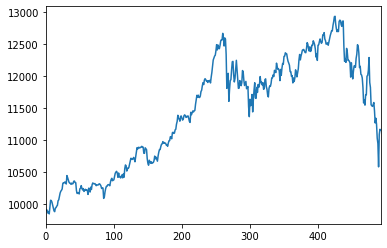

*-----Episode: 223, Reward:111.509330%-----*


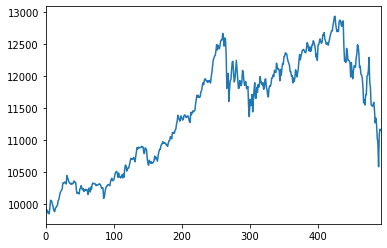

*-----Episode: 224, Reward:111.551638%-----*


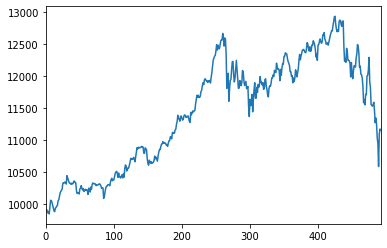

*-----Episode: 225, Reward:111.590656%-----*


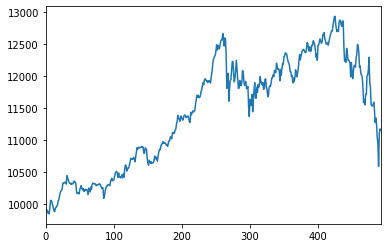

*-----Episode: 226, Reward:111.634166%-----*


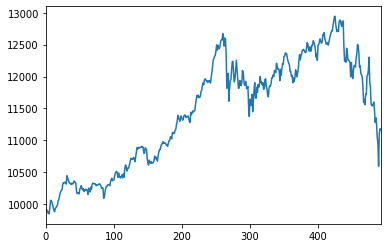

*-----Episode: 227, Reward:111.671104%-----*


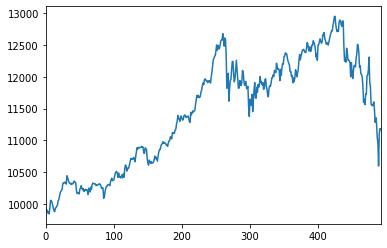

*-----Episode: 228, Reward:111.712948%-----*


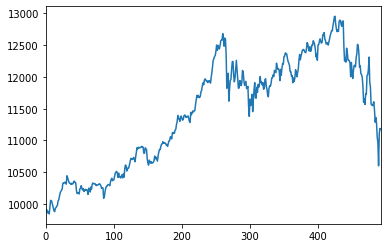

*-----Episode: 229, Reward:111.755597%-----*


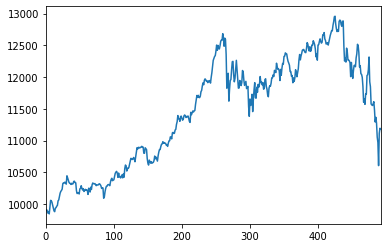

*-----Episode: 230, Reward:111.797825%-----*


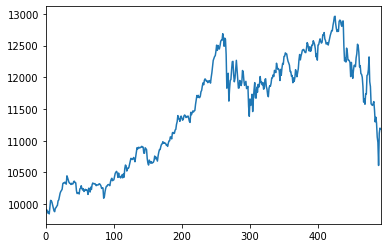

*-----Episode: 231, Reward:111.835111%-----*


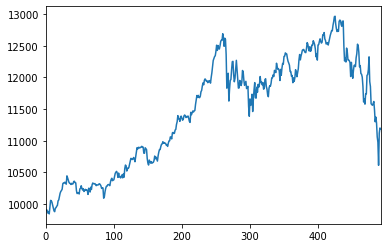

*-----Episode: 232, Reward:111.872790%-----*


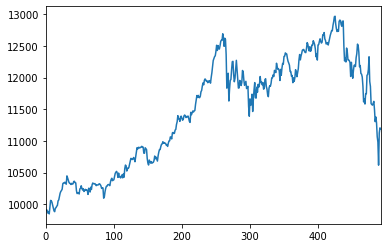

*-----Episode: 233, Reward:111.912097%-----*


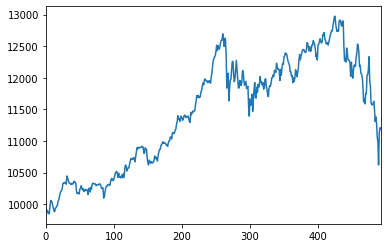

*-----Episode: 234, Reward:111.955088%-----*


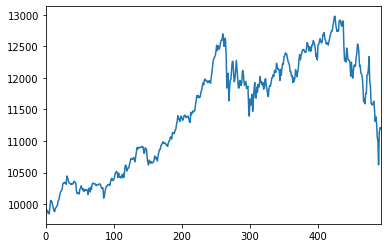

*-----Episode: 235, Reward:111.991075%-----*


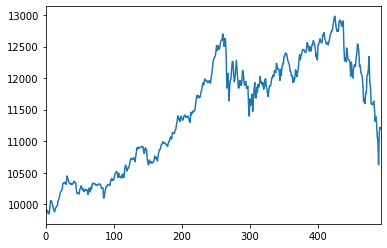

*-----Episode: 236, Reward:112.038975%-----*


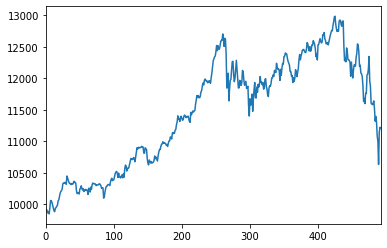

*-----Episode: 237, Reward:112.074929%-----*


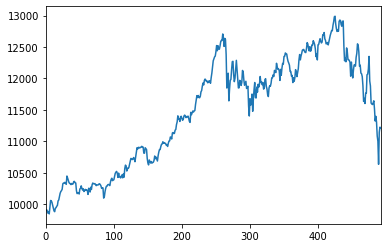

*-----Episode: 238, Reward:112.109221%-----*


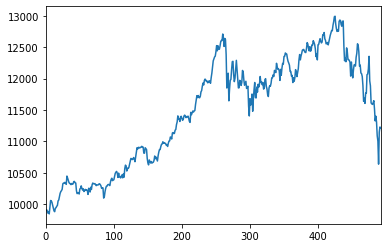

*-----Episode: 239, Reward:112.153788%-----*


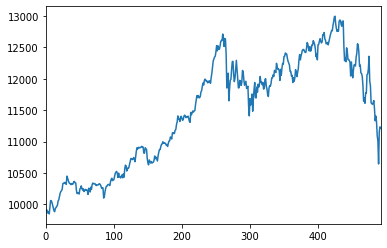

*-----Episode: 240, Reward:112.192989%-----*


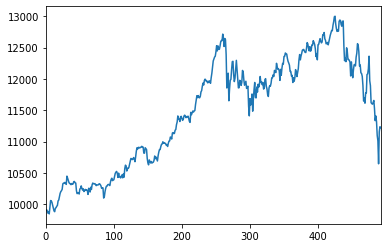

*-----Episode: 241, Reward:112.234233%-----*


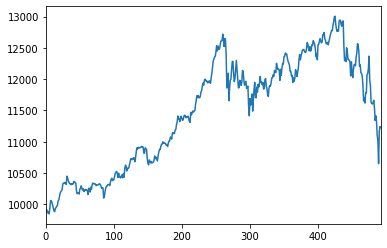

*-----Episode: 242, Reward:112.275460%-----*


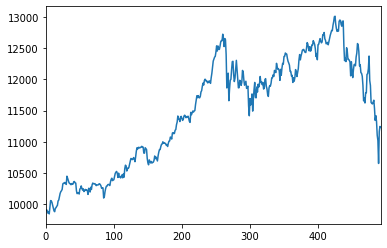

*-----Episode: 243, Reward:112.316671%-----*


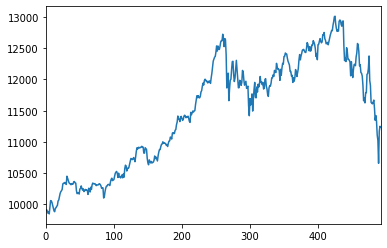

*-----Episode: 244, Reward:112.352503%-----*


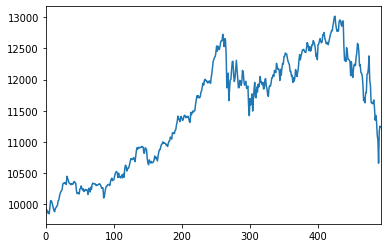

*-----Episode: 245, Reward:112.392032%-----*


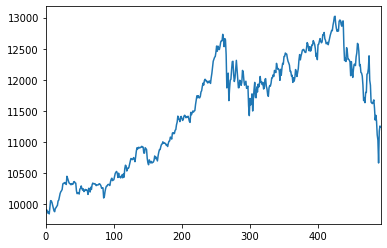

*-----Episode: 246, Reward:112.433197%-----*


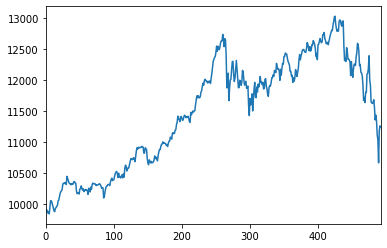

*-----Episode: 247, Reward:112.474344%-----*


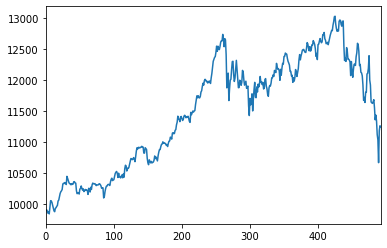

*-----Episode: 248, Reward:112.507628%-----*


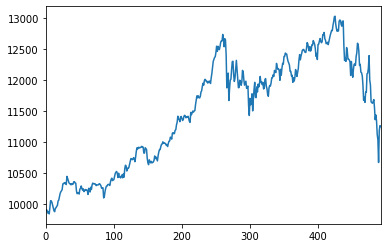

*-----Episode: 249, Reward:112.553288%-----*


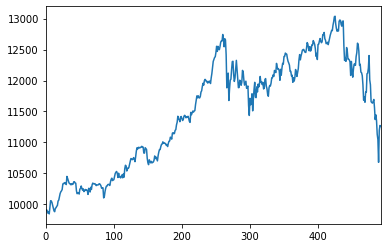

*-----Episode: 250, Reward:112.596459%-----*


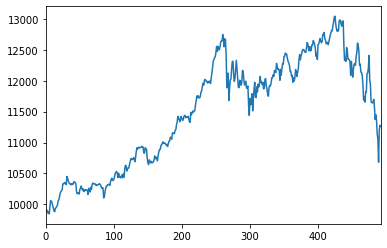

*-----Episode: 251, Reward:112.634235%-----*


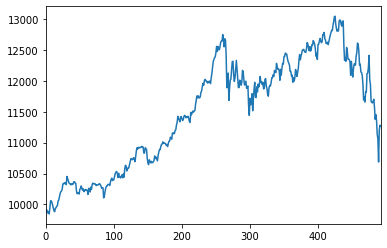

*-----Episode: 252, Reward:112.672815%-----*


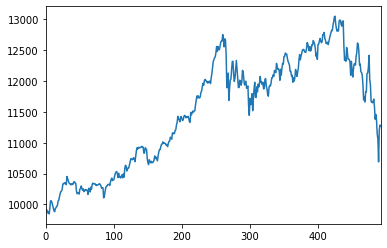

*-----Episode: 253, Reward:112.711792%-----*


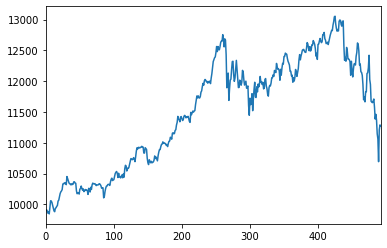

*-----Episode: 254, Reward:112.754478%-----*


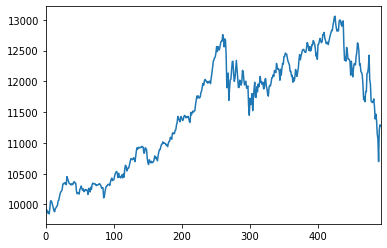

*-----Episode: 255, Reward:112.792593%-----*


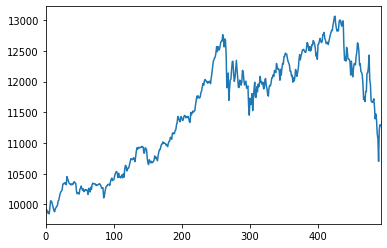

*-----Episode: 256, Reward:112.832762%-----*


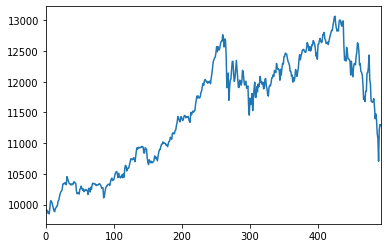

*-----Episode: 257, Reward:112.872086%-----*


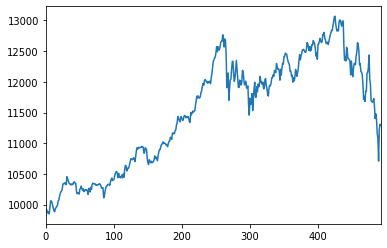

*-----Episode: 258, Reward:112.912637%-----*


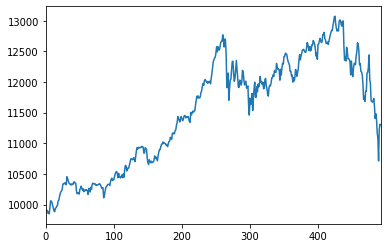

*-----Episode: 259, Reward:112.954000%-----*


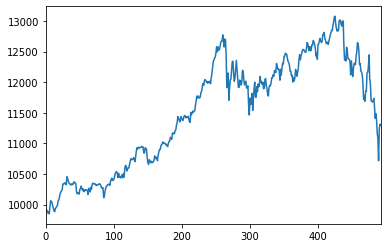

*-----Episode: 260, Reward:112.986635%-----*


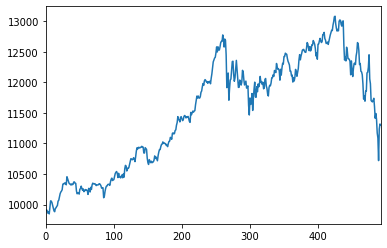

*-----Episode: 261, Reward:113.027961%-----*


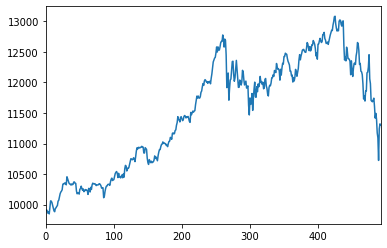

*-----Episode: 262, Reward:113.072177%-----*


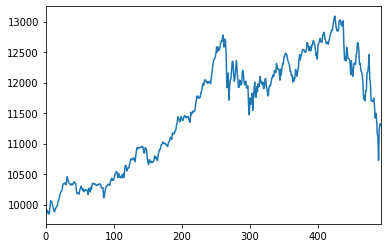

*-----Episode: 263, Reward:113.105168%-----*


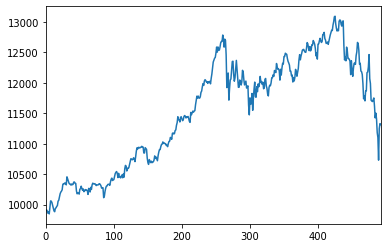

*-----Episode: 264, Reward:113.148522%-----*


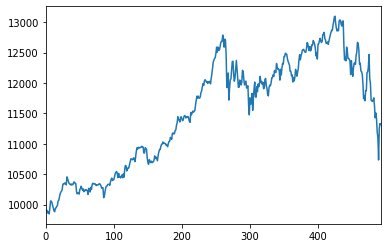

*-----Episode: 265, Reward:113.190617%-----*


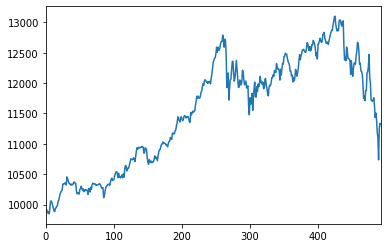

*-----Episode: 266, Reward:113.226876%-----*


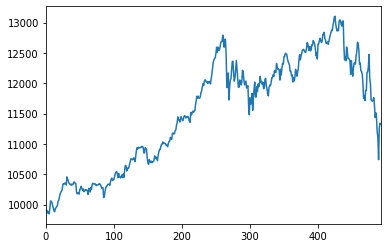

*-----Episode: 267, Reward:113.266860%-----*


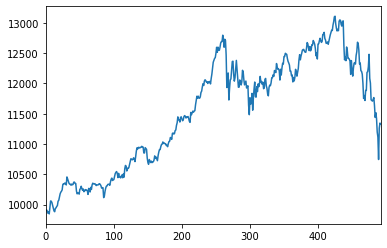

*-----Episode: 268, Reward:113.305994%-----*


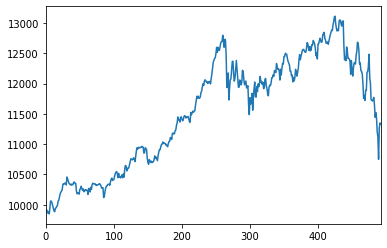

*-----Episode: 269, Reward:113.346984%-----*


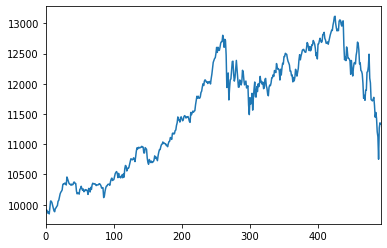

*-----Episode: 270, Reward:113.386082%-----*


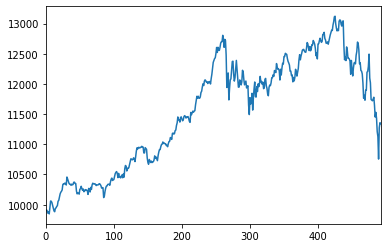

*-----Episode: 271, Reward:113.425788%-----*


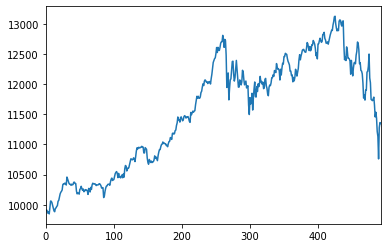

*-----Episode: 272, Reward:113.468601%-----*


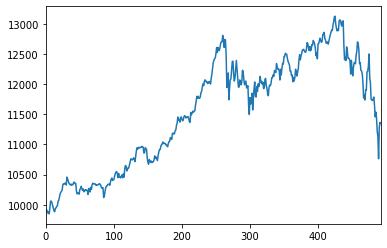

*-----Episode: 273, Reward:113.509524%-----*


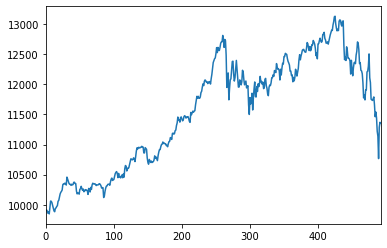

*-----Episode: 274, Reward:113.545012%-----*


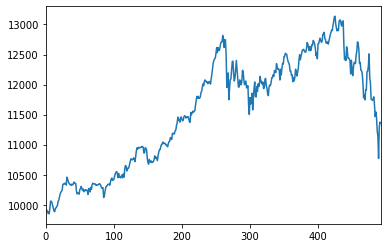

*-----Episode: 275, Reward:113.584427%-----*


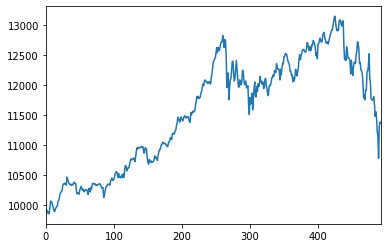

*-----Episode: 276, Reward:113.625076%-----*


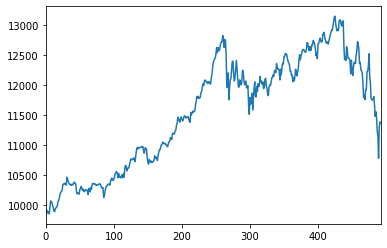

*-----Episode: 277, Reward:113.656110%-----*


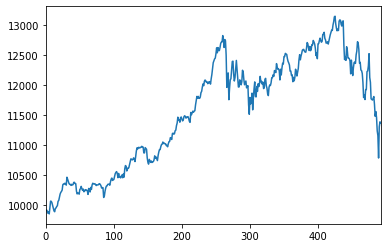

*-----Episode: 278, Reward:113.698391%-----*


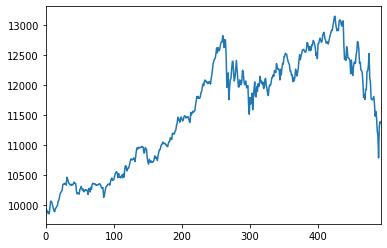

*-----Episode: 279, Reward:113.739611%-----*


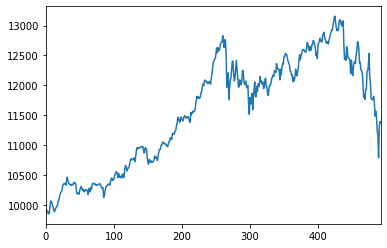

*-----Episode: 280, Reward:113.778934%-----*


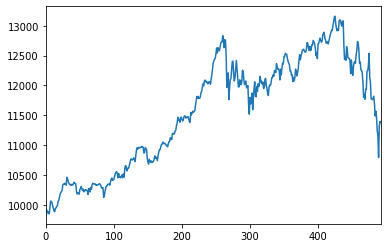

*-----Episode: 281, Reward:113.821163%-----*


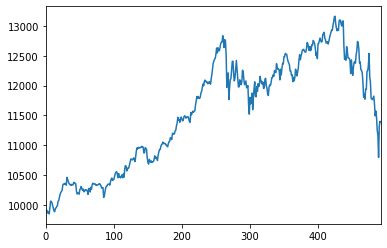

*-----Episode: 282, Reward:113.860240%-----*


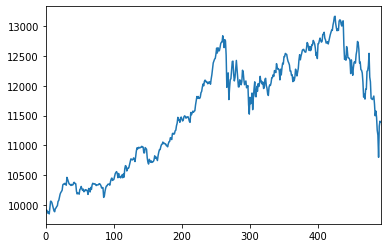

*-----Episode: 283, Reward:113.892820%-----*


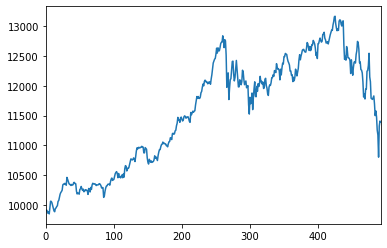

*-----Episode: 284, Reward:113.935834%-----*


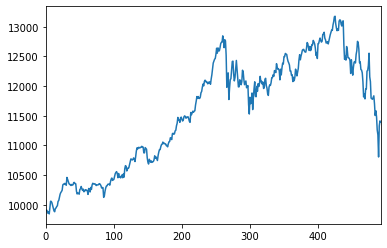

*-----Episode: 285, Reward:113.979878%-----*


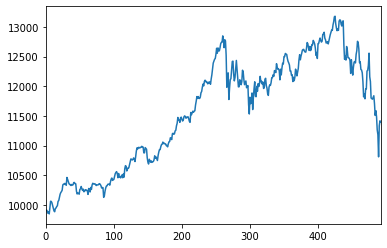

*-----Episode: 286, Reward:114.012815%-----*


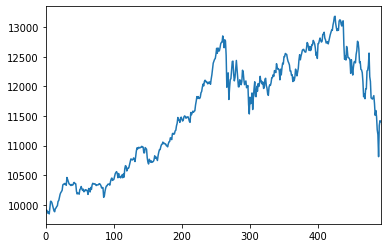

*-----Episode: 287, Reward:114.056619%-----*


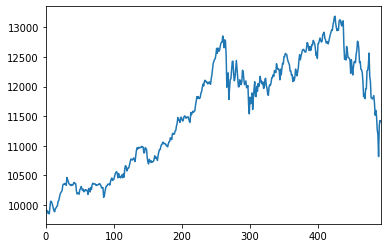

*-----Episode: 288, Reward:114.100198%-----*


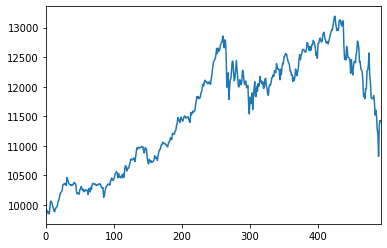

*-----Episode: 289, Reward:114.136013%-----*


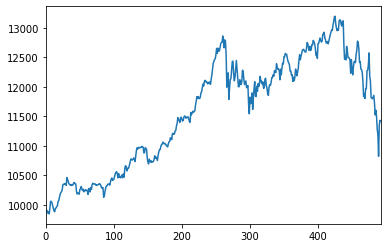

*-----Episode: 290, Reward:114.173904%-----*


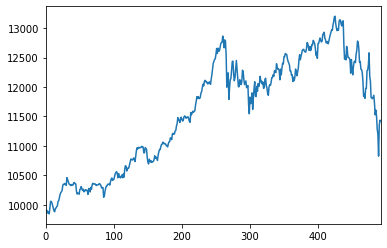

*-----Episode: 291, Reward:114.212615%-----*


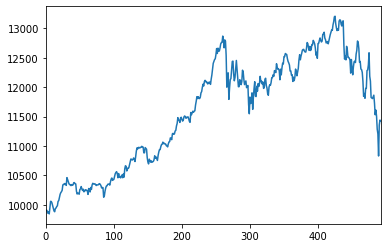

*-----Episode: 292, Reward:114.247115%-----*


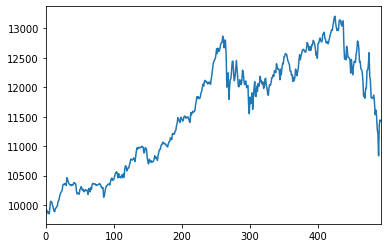

*-----Episode: 293, Reward:114.286211%-----*


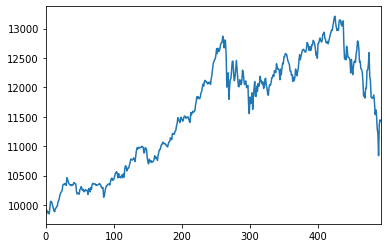

*-----Episode: 294, Reward:114.328020%-----*


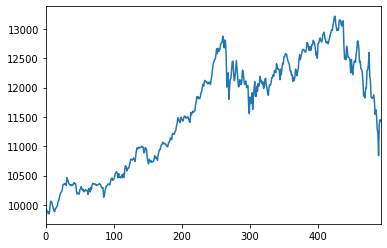

*-----Episode: 295, Reward:114.364774%-----*


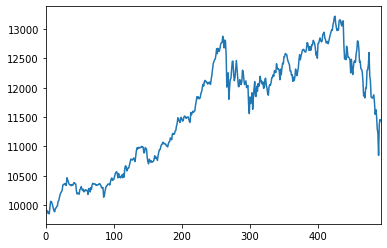

*-----Episode: 296, Reward:114.408652%-----*


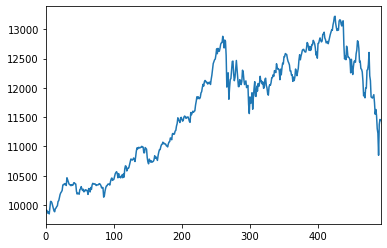

*-----Episode: 297, Reward:114.448524%-----*


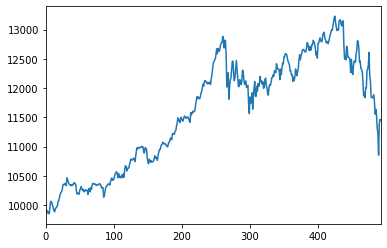

*-----Episode: 298, Reward:114.483127%-----*


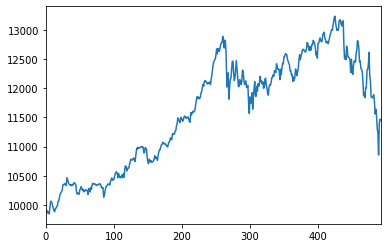

*-----Episode: 299, Reward:114.521916%-----*


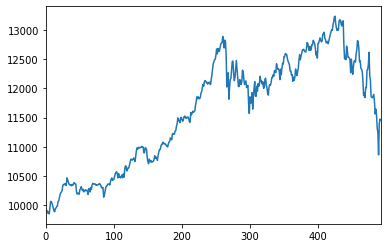

*-----Episode: 300, Reward:114.567208%-----*


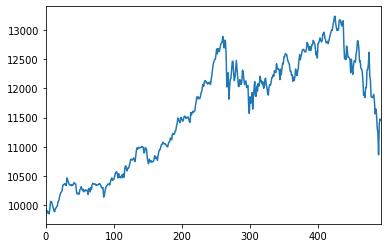

*-----Episode: 301, Reward:114.603442%-----*


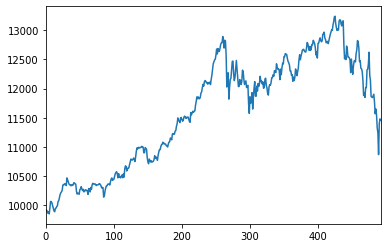

*-----Episode: 302, Reward:114.636080%-----*


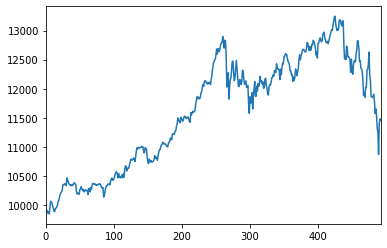

*-----Episode: 303, Reward:114.676276%-----*


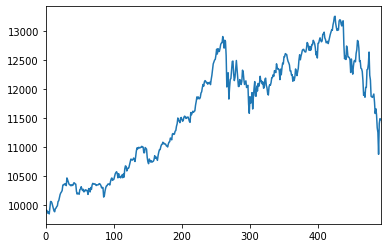

*-----Episode: 304, Reward:114.716249%-----*


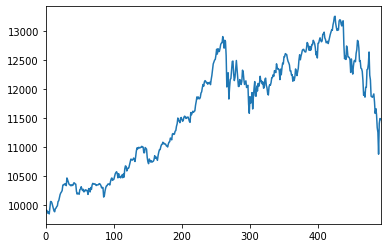

*-----Episode: 305, Reward:114.757466%-----*


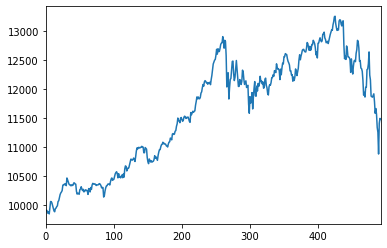

*-----Episode: 306, Reward:114.795722%-----*


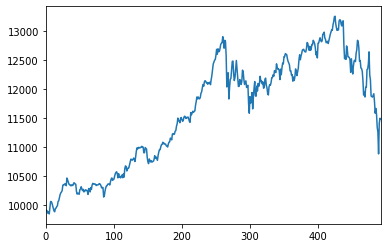

*-----Episode: 307, Reward:114.837122%-----*


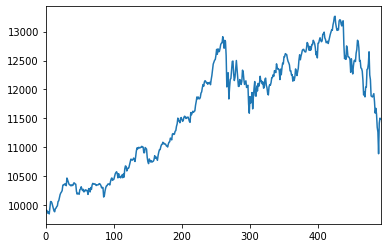

*-----Episode: 308, Reward:114.874922%-----*


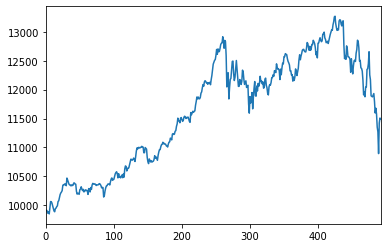

*-----Episode: 309, Reward:114.916293%-----*


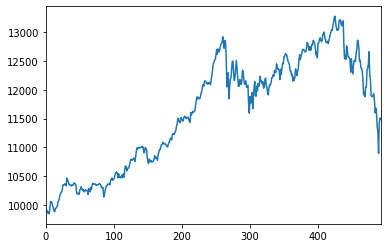

*-----Episode: 310, Reward:114.949420%-----*


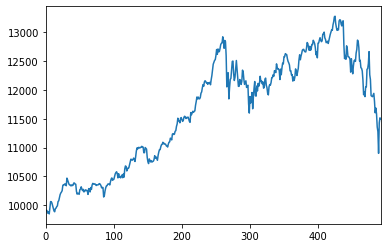

*-----Episode: 311, Reward:114.987588%-----*


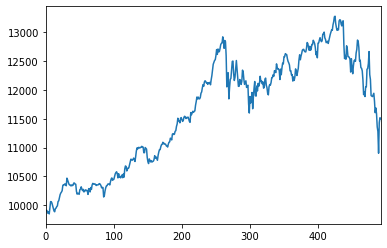

*-----Episode: 312, Reward:115.029962%-----*


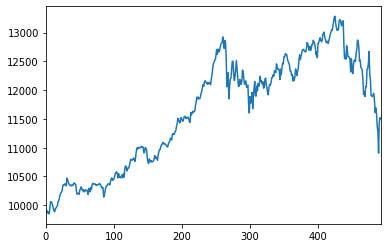

*-----Episode: 313, Reward:115.064083%-----*


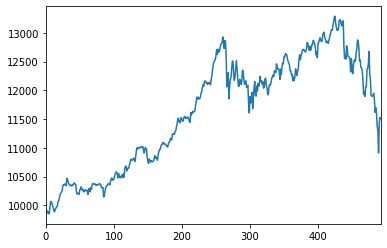

*-----Episode: 314, Reward:115.108113%-----*


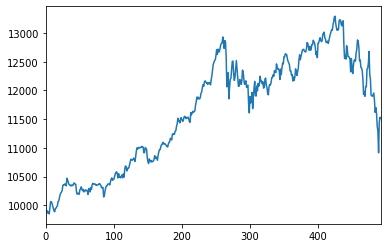

*-----Episode: 315, Reward:115.150858%-----*


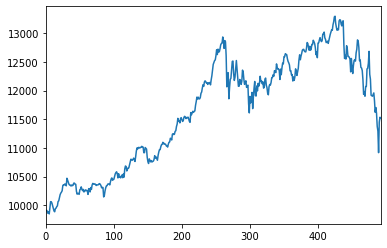

*-----Episode: 316, Reward:115.183443%-----*


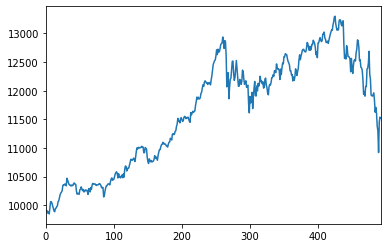

*-----Episode: 317, Reward:115.219813%-----*


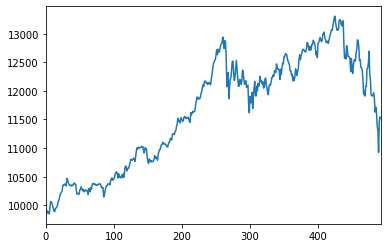

*-----Episode: 318, Reward:115.263782%-----*


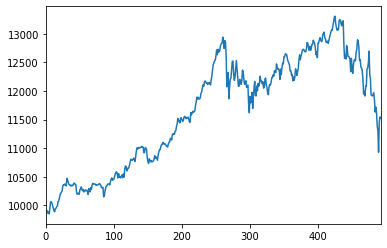

*-----Episode: 319, Reward:115.304142%-----*


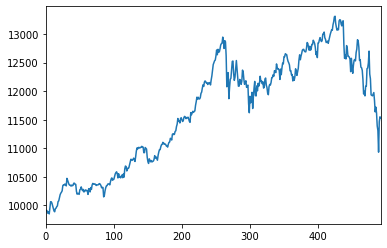

*-----Episode: 320, Reward:115.339615%-----*


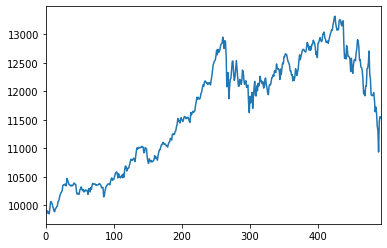

*-----Episode: 321, Reward:115.376554%-----*


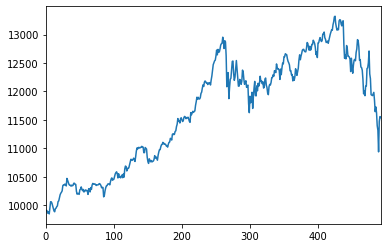

*-----Episode: 322, Reward:115.421950%-----*


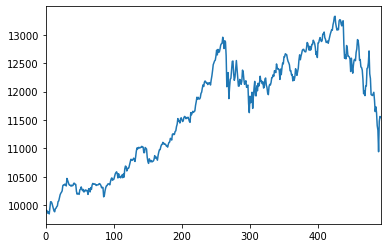

*-----Episode: 323, Reward:115.459281%-----*


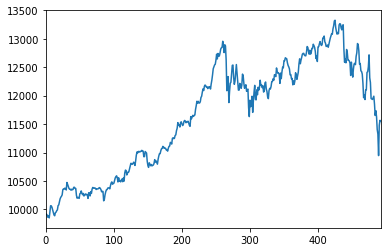

*-----Episode: 324, Reward:115.498504%-----*


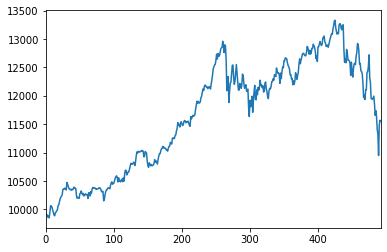

*-----Episode: 325, Reward:115.528380%-----*


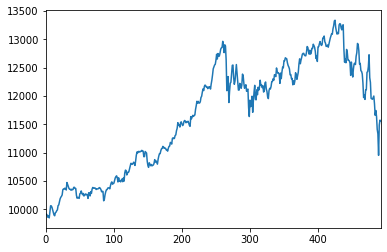

*-----Episode: 326, Reward:115.569266%-----*


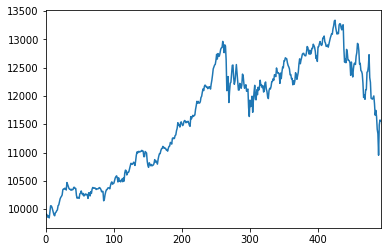

*-----Episode: 327, Reward:115.614805%-----*


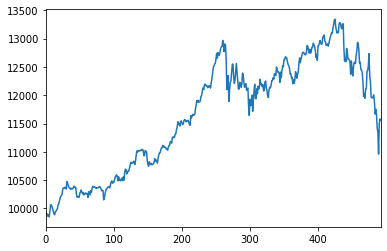

*-----Episode: 328, Reward:115.652906%-----*


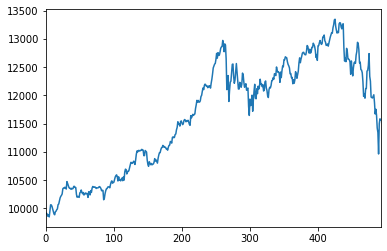

*-----Episode: 329, Reward:115.685254%-----*


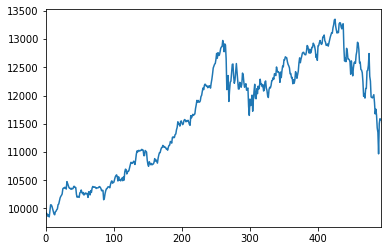

*-----Episode: 330, Reward:115.722259%-----*


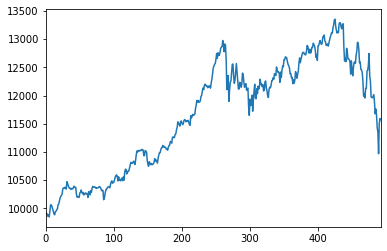

*-----Episode: 331, Reward:115.764771%-----*


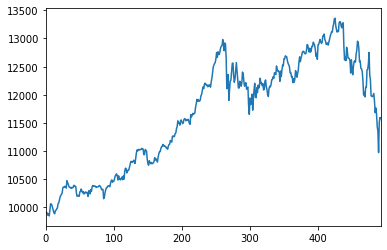

*-----Episode: 332, Reward:115.807055%-----*


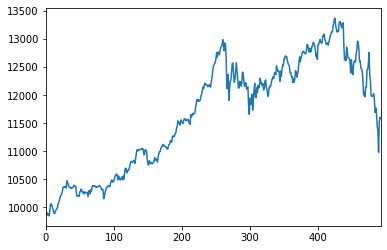

*-----Episode: 333, Reward:115.838694%-----*


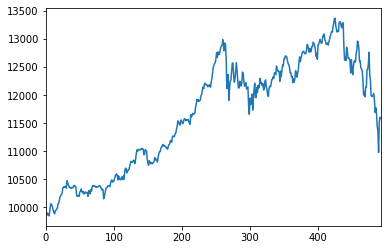

*-----Episode: 334, Reward:115.874565%-----*


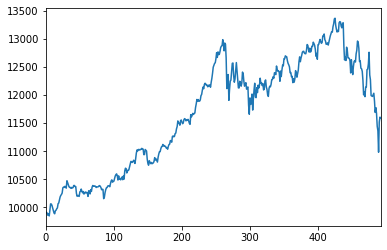

*-----Episode: 335, Reward:115.921698%-----*


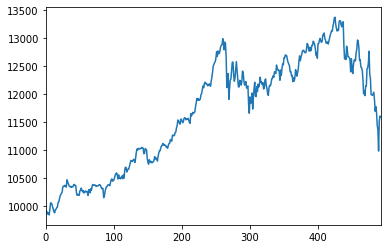

*-----Episode: 336, Reward:115.958602%-----*


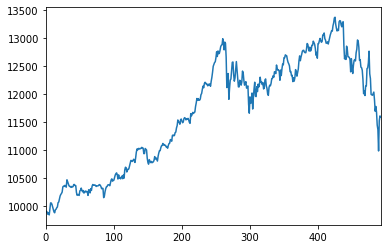

*-----Episode: 337, Reward:115.994426%-----*


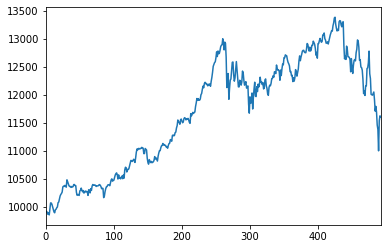

*-----Episode: 338, Reward:116.032148%-----*


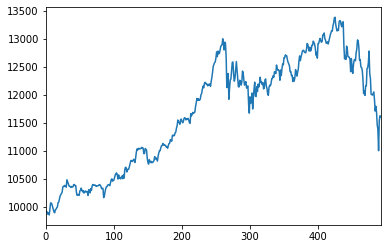

*-----Episode: 339, Reward:116.071558%-----*


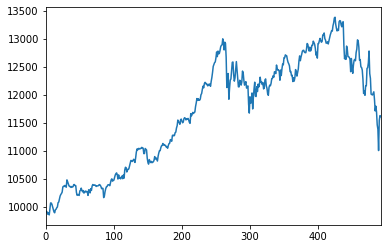

*-----Episode: 340, Reward:116.115215%-----*


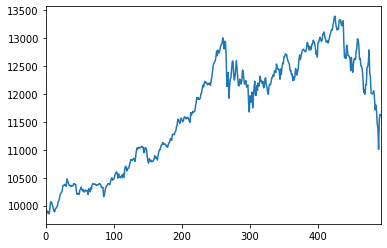

*-----Episode: 341, Reward:116.145853%-----*


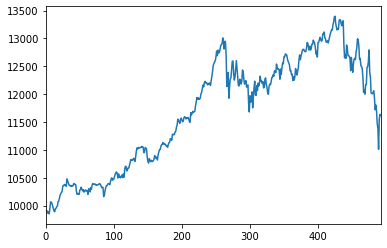

*-----Episode: 342, Reward:116.185429%-----*


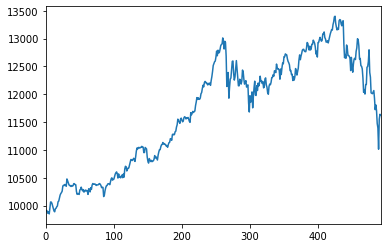

*-----Episode: 343, Reward:116.230323%-----*


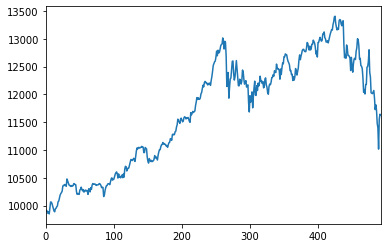

*-----Episode: 344, Reward:116.259629%-----*


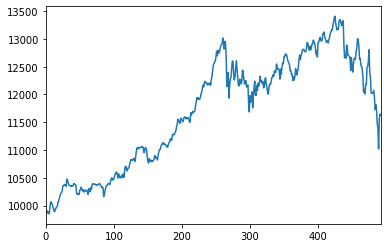

*-----Episode: 345, Reward:116.298520%-----*


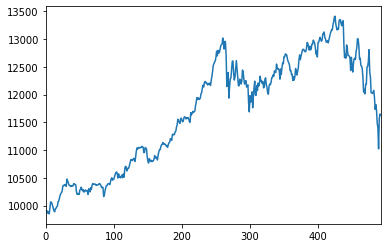

*-----Episode: 346, Reward:116.342096%-----*


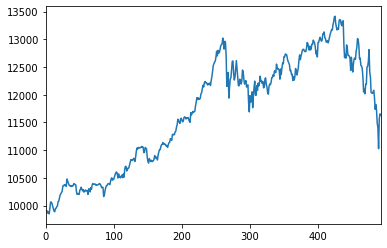

*-----Episode: 347, Reward:116.381175%-----*


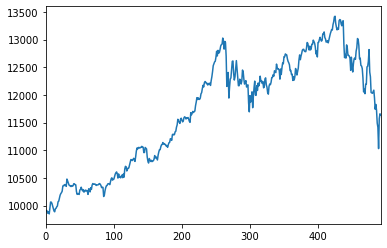

*-----Episode: 348, Reward:116.411692%-----*


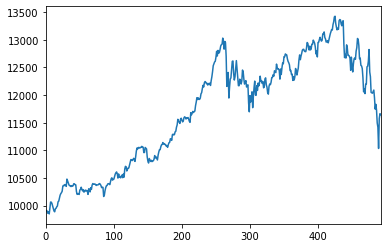

*-----Episode: 349, Reward:116.455224%-----*


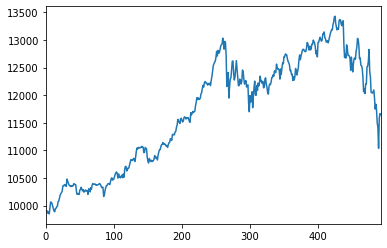

*-----Episode: 350, Reward:116.490406%-----*


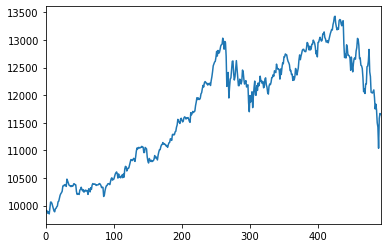

*-----Episode: 351, Reward:116.526211%-----*


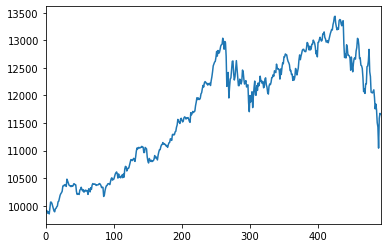

*-----Episode: 352, Reward:116.566493%-----*


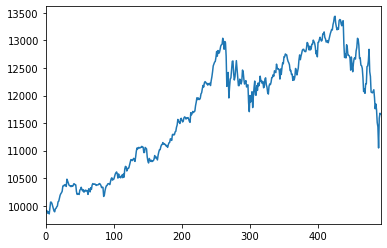

*-----Episode: 353, Reward:116.610184%-----*


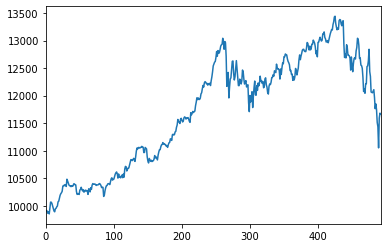

*-----Episode: 354, Reward:116.641017%-----*


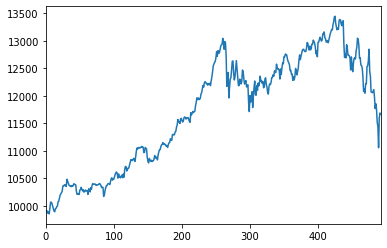

*-----Episode: 355, Reward:116.687249%-----*


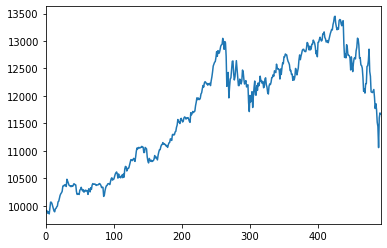

*-----Episode: 356, Reward:116.723399%-----*


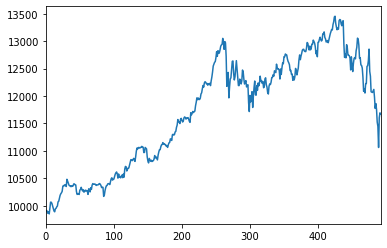

*-----Episode: 357, Reward:116.762747%-----*


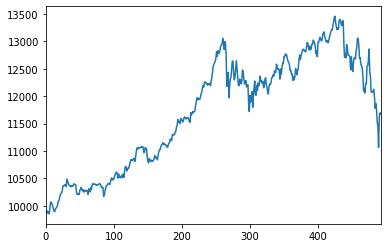

*-----Episode: 358, Reward:116.796077%-----*


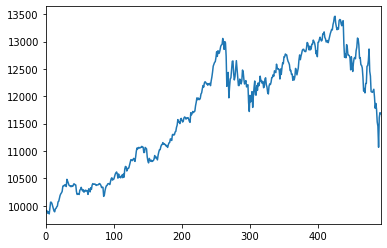

*-----Episode: 359, Reward:116.833250%-----*


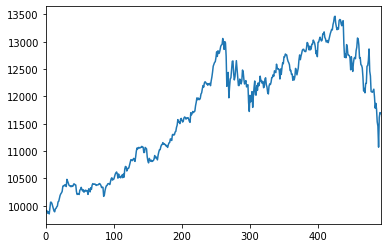

*-----Episode: 360, Reward:116.870622%-----*


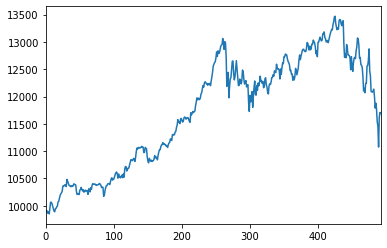

*-----Episode: 361, Reward:116.908407%-----*


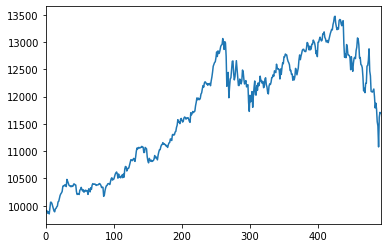

*-----Episode: 362, Reward:116.946607%-----*


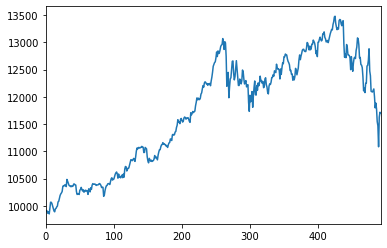

*-----Episode: 363, Reward:116.984791%-----*


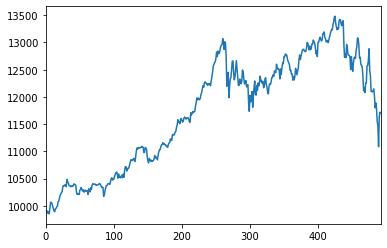

*-----Episode: 364, Reward:117.021887%-----*


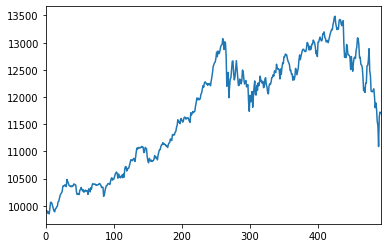

*-----Episode: 365, Reward:117.066918%-----*


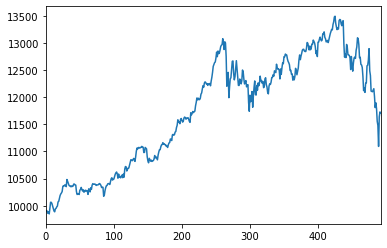

*-----Episode: 366, Reward:117.103555%-----*


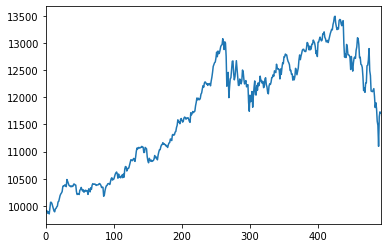

*-----Episode: 367, Reward:117.135447%-----*


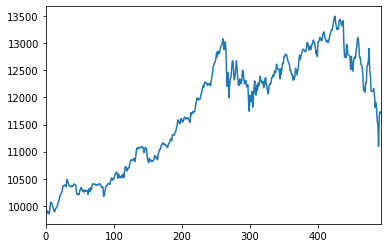

*-----Episode: 368, Reward:117.178506%-----*


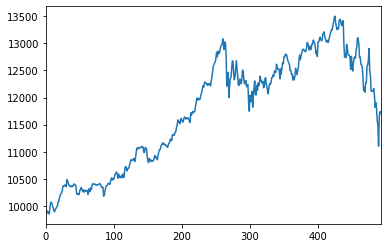

*-----Episode: 369, Reward:117.215315%-----*


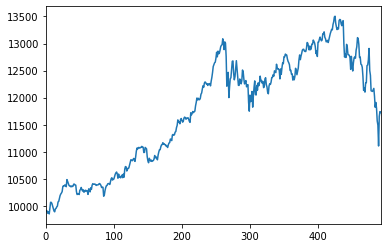

*-----Episode: 370, Reward:117.250169%-----*


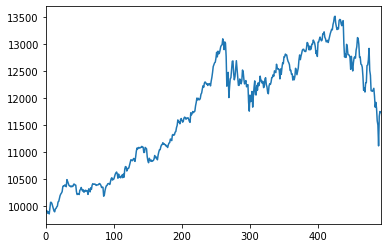

*-----Episode: 371, Reward:117.289315%-----*


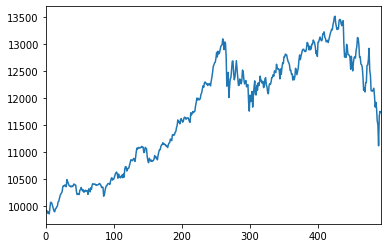

*-----Episode: 372, Reward:117.330815%-----*


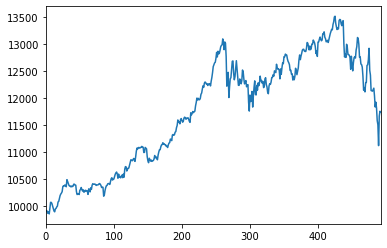

*-----Episode: 373, Reward:117.367560%-----*


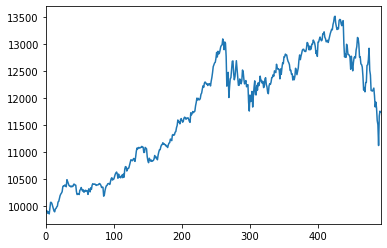

*-----Episode: 374, Reward:117.399979%-----*


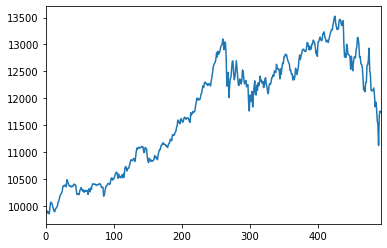

*-----Episode: 375, Reward:117.441005%-----*


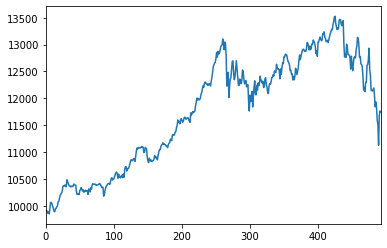

*-----Episode: 376, Reward:117.476410%-----*


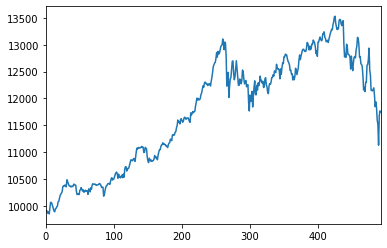

*-----Episode: 377, Reward:117.516545%-----*


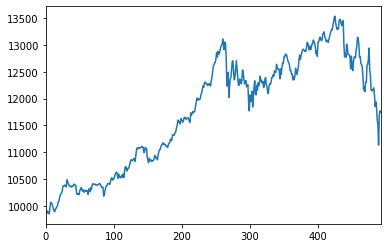

*-----Episode: 378, Reward:117.557747%-----*


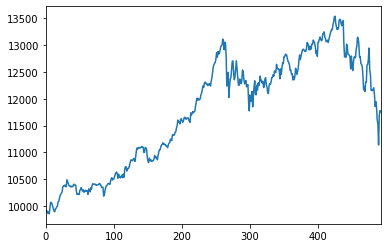

*-----Episode: 379, Reward:117.591813%-----*


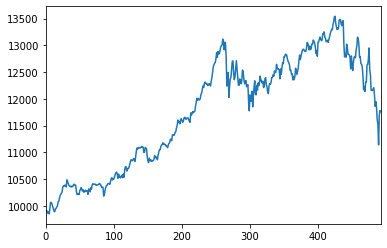

*-----Episode: 380, Reward:117.631690%-----*


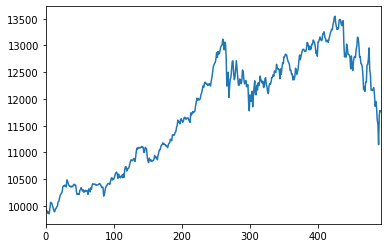

*-----Episode: 381, Reward:117.670261%-----*


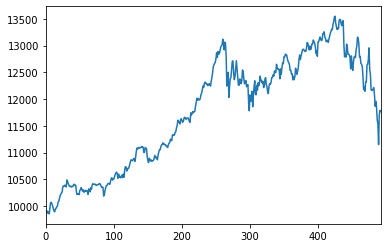

*-----Episode: 382, Reward:117.708603%-----*


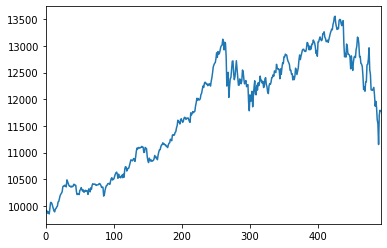

*-----Episode: 383, Reward:117.744985%-----*


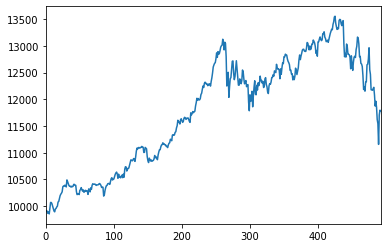

*-----Episode: 384, Reward:117.779626%-----*


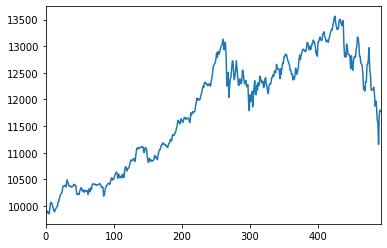

*-----Episode: 385, Reward:117.818793%-----*


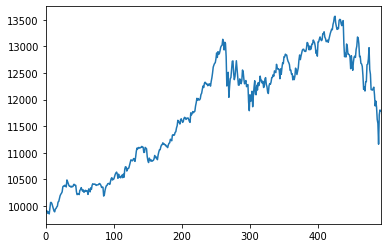

*-----Episode: 386, Reward:117.853837%-----*


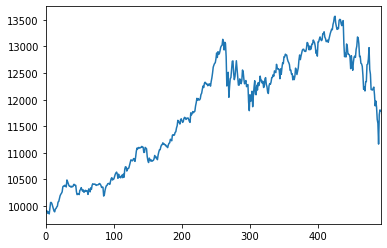

*-----Episode: 387, Reward:117.888218%-----*


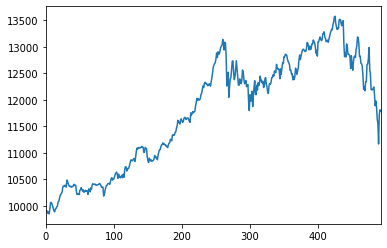

*-----Episode: 388, Reward:117.934489%-----*


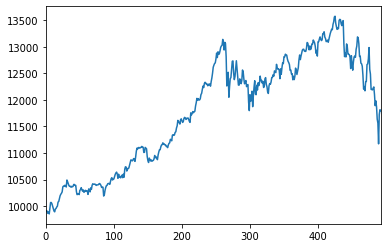

*-----Episode: 389, Reward:117.970143%-----*


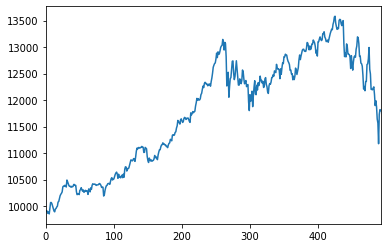

*-----Episode: 390, Reward:118.009681%-----*


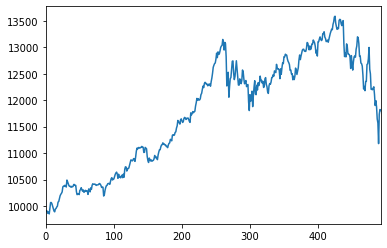

*-----Episode: 391, Reward:118.044442%-----*


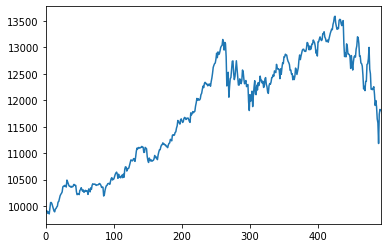

*-----Episode: 392, Reward:118.081787%-----*


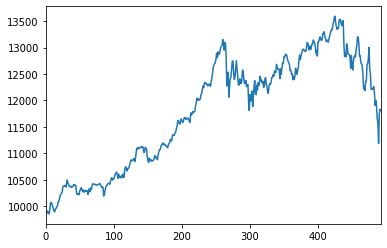

*-----Episode: 393, Reward:118.116086%-----*


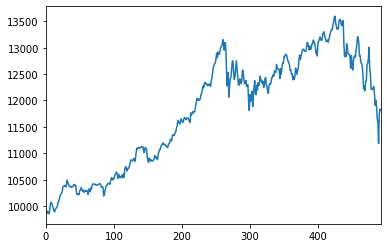

*-----Episode: 394, Reward:118.154707%-----*


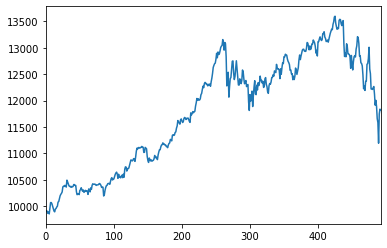

*-----Episode: 395, Reward:118.193099%-----*


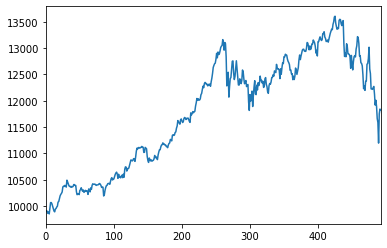

*-----Episode: 396, Reward:118.230175%-----*


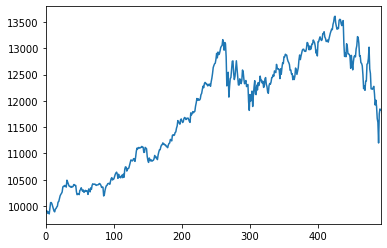

*-----Episode: 397, Reward:118.267892%-----*


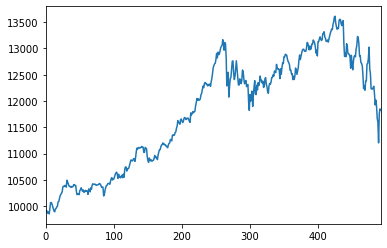

*-----Episode: 398, Reward:118.310590%-----*


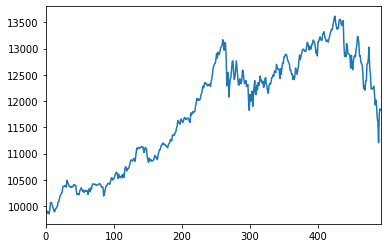

*-----Episode: 399, Reward:118.344373%-----*


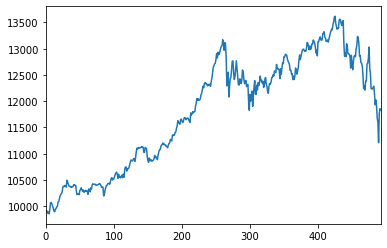

*-----Episode: 400, Reward:118.382270%-----*


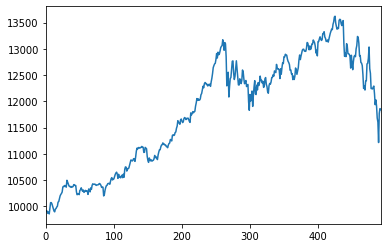

*-----Episode: 401, Reward:118.418415%-----*


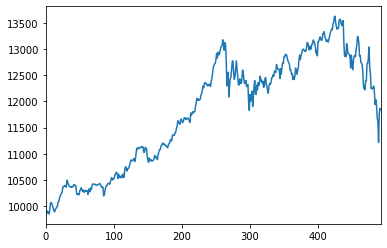

*-----Episode: 402, Reward:118.458461%-----*


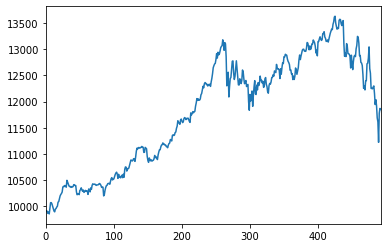

*-----Episode: 403, Reward:118.491973%-----*


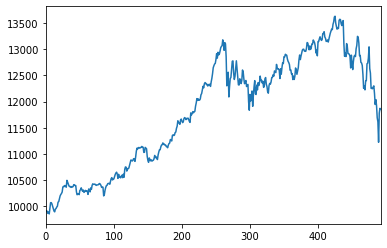

*-----Episode: 404, Reward:118.526556%-----*


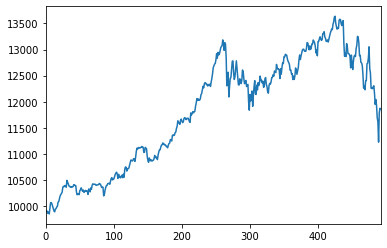

*-----Episode: 405, Reward:118.568744%-----*


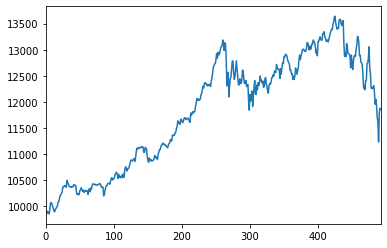

*-----Episode: 406, Reward:118.611575%-----*


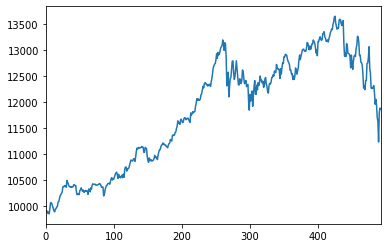

*-----Episode: 407, Reward:118.639585%-----*


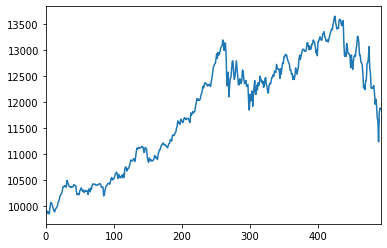

*-----Episode: 408, Reward:118.678245%-----*


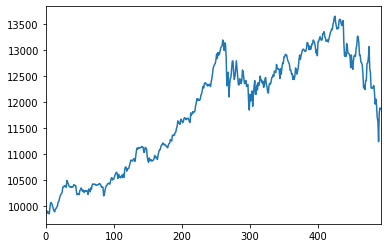

*-----Episode: 409, Reward:118.717760%-----*


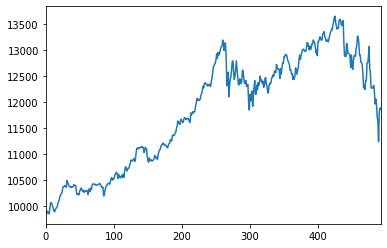

*-----Episode: 410, Reward:118.757044%-----*


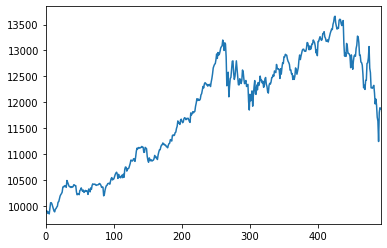

*-----Episode: 411, Reward:118.789341%-----*


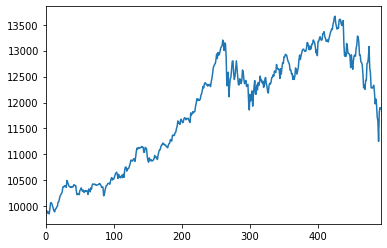

*-----Episode: 412, Reward:118.831000%-----*


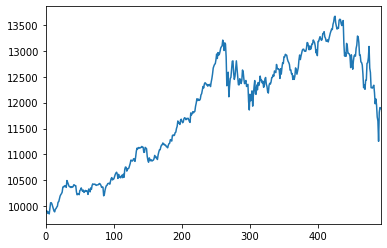

*-----Episode: 413, Reward:118.863487%-----*


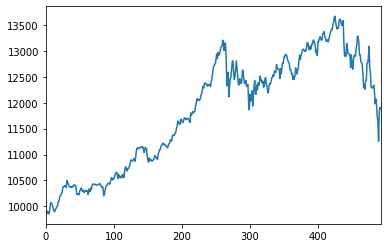

*-----Episode: 414, Reward:118.903815%-----*


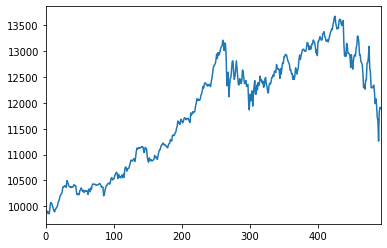

*-----Episode: 415, Reward:118.935619%-----*


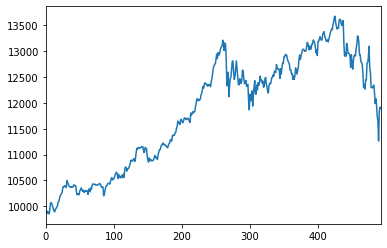

*-----Episode: 416, Reward:118.981821%-----*


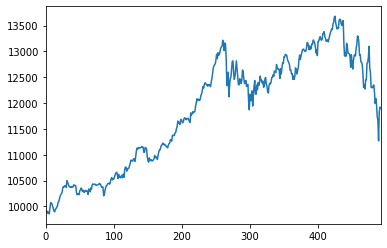

*-----Episode: 417, Reward:119.018624%-----*


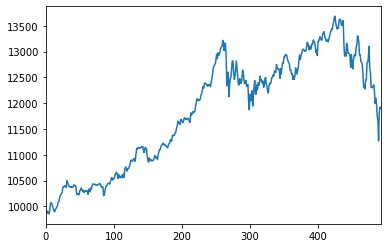

*-----Episode: 418, Reward:119.058910%-----*


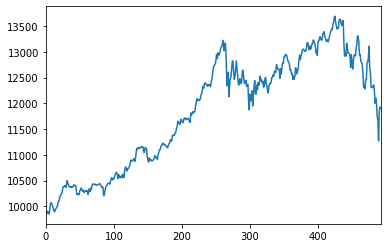

*-----Episode: 419, Reward:119.090881%-----*


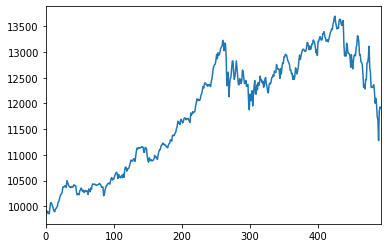

*-----Episode: 420, Reward:119.127647%-----*


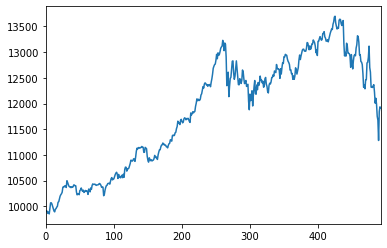

*-----Episode: 421, Reward:119.161777%-----*


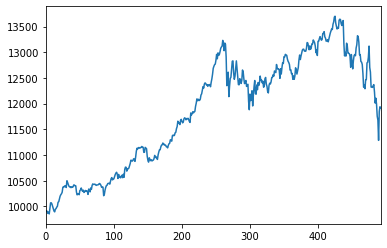

*-----Episode: 422, Reward:119.200050%-----*


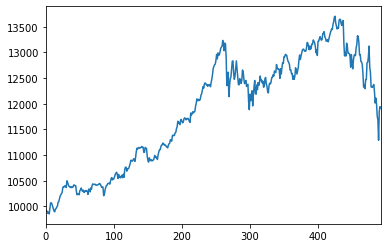

*-----Episode: 423, Reward:119.243347%-----*


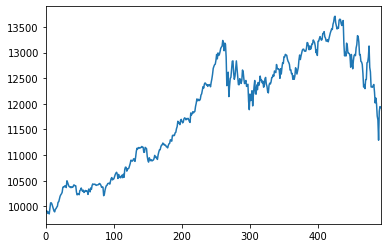

*-----Episode: 424, Reward:119.276345%-----*


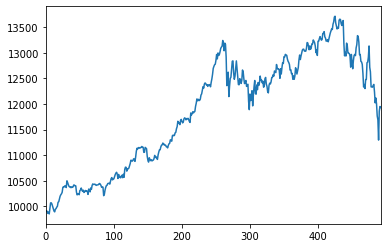

*-----Episode: 425, Reward:119.313492%-----*


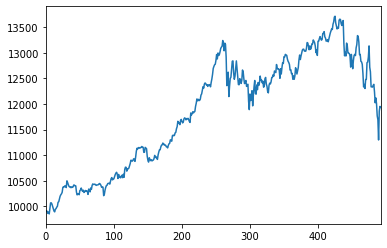

*-----Episode: 426, Reward:119.353914%-----*


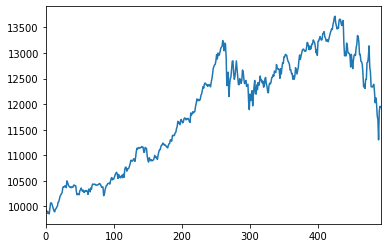

*-----Episode: 427, Reward:119.389724%-----*


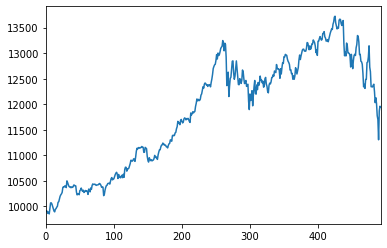

*-----Episode: 428, Reward:119.421796%-----*


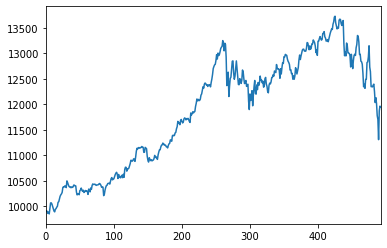

*-----Episode: 429, Reward:119.464160%-----*


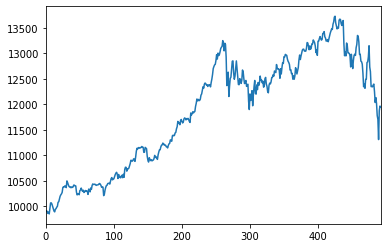

*-----Episode: 430, Reward:119.495550%-----*


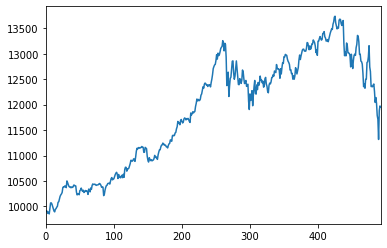

*-----Episode: 431, Reward:119.536141%-----*


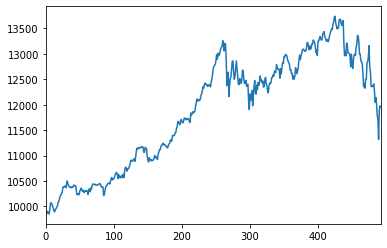

*-----Episode: 432, Reward:119.572333%-----*


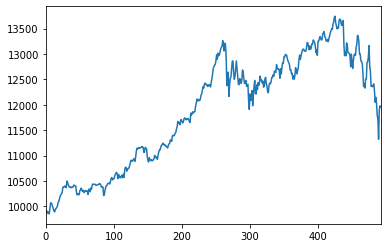

*-----Episode: 433, Reward:119.612246%-----*


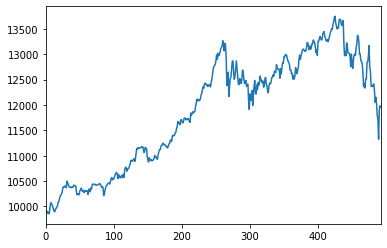

*-----Episode: 434, Reward:119.645563%-----*


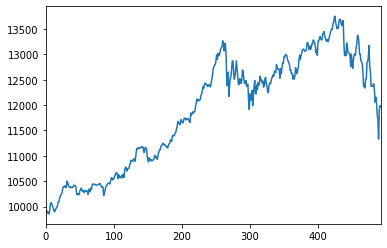

*-----Episode: 435, Reward:119.688752%-----*


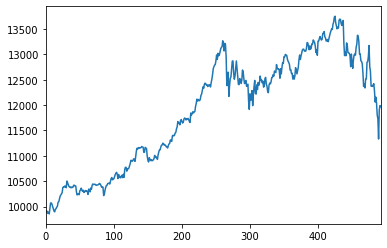

*-----Episode: 436, Reward:119.719849%-----*


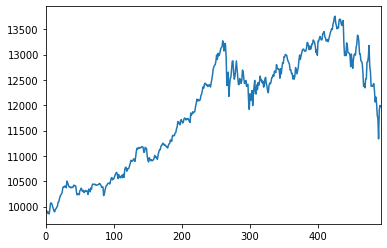

*-----Episode: 437, Reward:119.759724%-----*


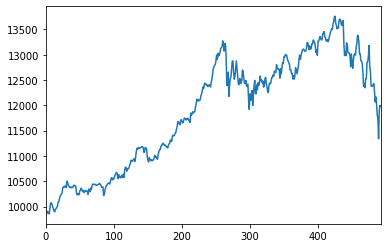

*-----Episode: 438, Reward:119.792114%-----*


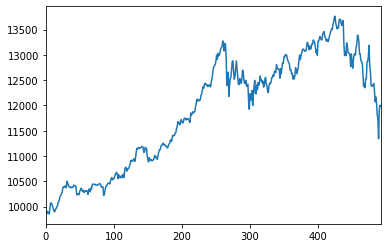

*-----Episode: 439, Reward:119.835049%-----*


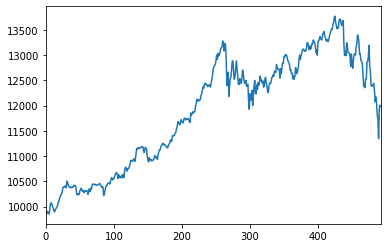

*-----Episode: 440, Reward:119.869837%-----*


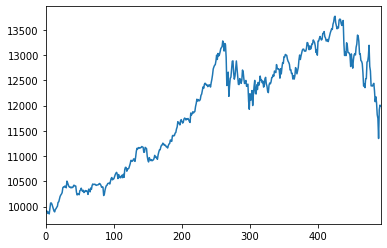

*-----Episode: 441, Reward:119.905713%-----*


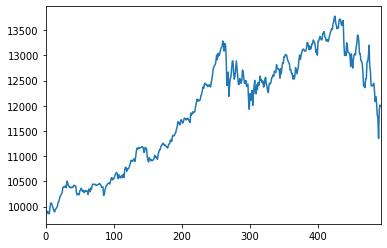

*-----Episode: 442, Reward:119.936737%-----*


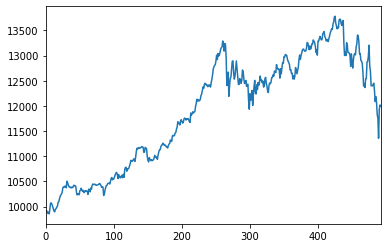

*-----Episode: 443, Reward:119.982941%-----*


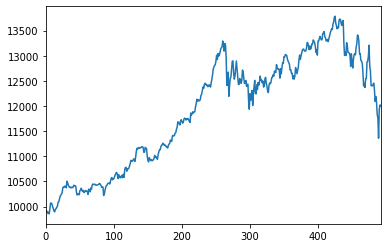

*-----Episode: 444, Reward:120.020771%-----*


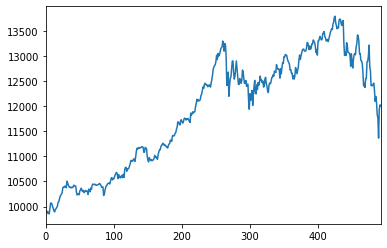

*-----Episode: 445, Reward:120.053302%-----*


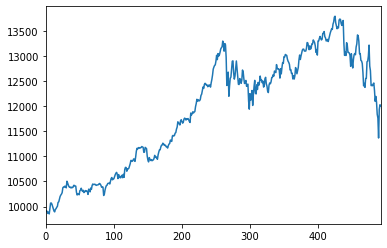

*-----Episode: 446, Reward:120.090450%-----*


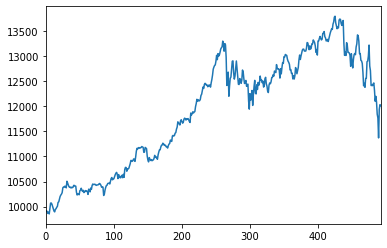

*-----Episode: 447, Reward:120.129793%-----*


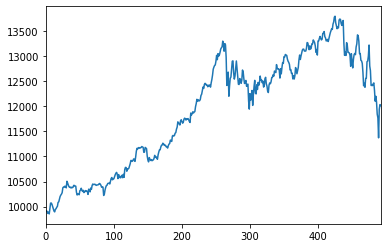

*-----Episode: 448, Reward:120.158540%-----*


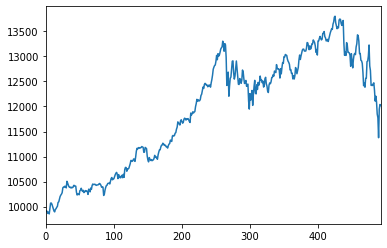

*-----Episode: 449, Reward:120.203822%-----*


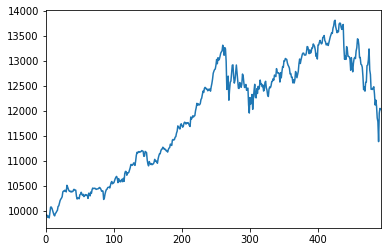

*-----Episode: 450, Reward:120.240049%-----*


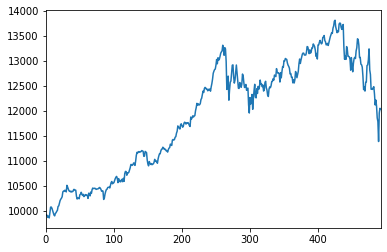

*-----Episode: 451, Reward:120.278693%-----*


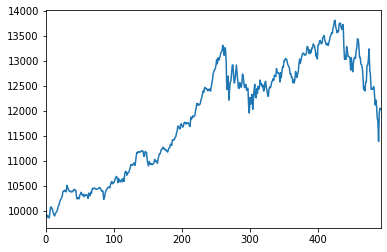

*-----Episode: 452, Reward:120.308494%-----*


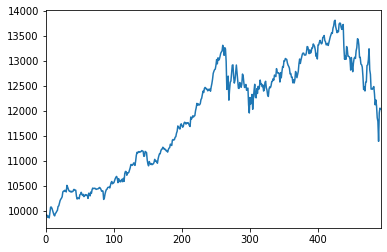

*-----Episode: 453, Reward:120.354407%-----*


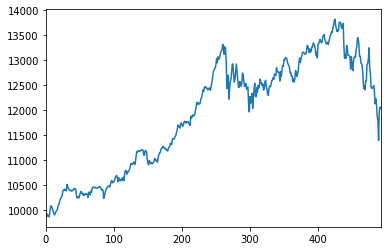

*-----Episode: 454, Reward:120.383514%-----*


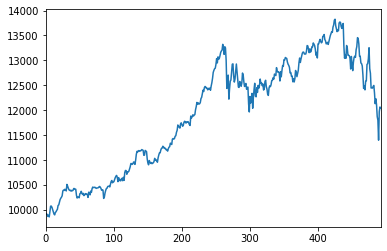

*-----Episode: 455, Reward:120.424100%-----*


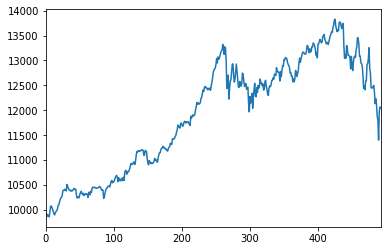

*-----Episode: 456, Reward:120.460256%-----*


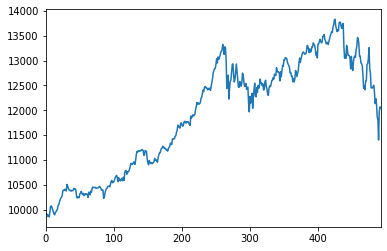

*-----Episode: 457, Reward:120.497507%-----*


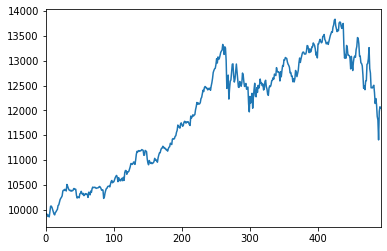

*-----Episode: 458, Reward:120.534749%-----*


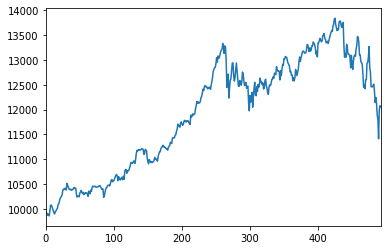

*-----Episode: 459, Reward:120.569767%-----*


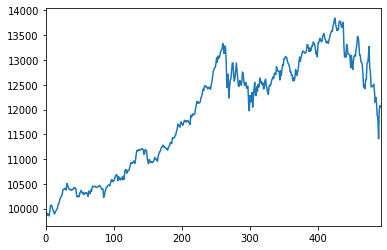

*-----Episode: 460, Reward:120.610754%-----*


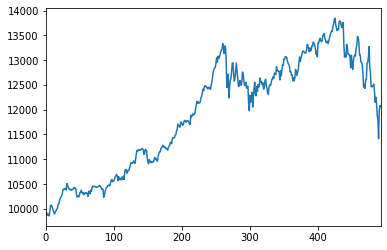

*-----Episode: 461, Reward:120.644646%-----*


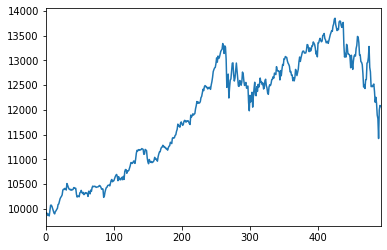

*-----Episode: 462, Reward:120.679413%-----*


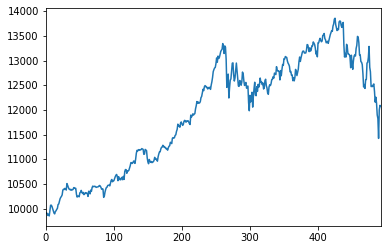

*-----Episode: 463, Reward:120.723033%-----*


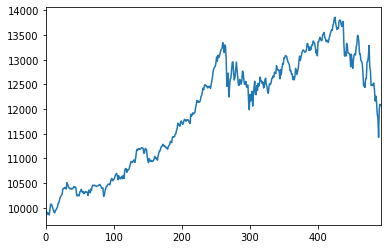

*-----Episode: 464, Reward:120.750468%-----*


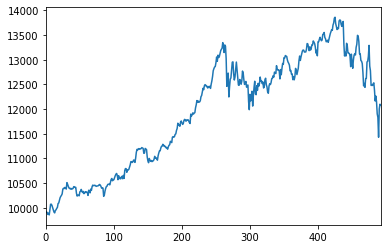

*-----Episode: 465, Reward:120.789417%-----*


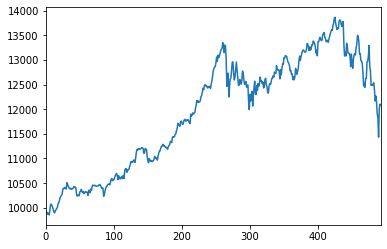

*-----Episode: 466, Reward:120.825697%-----*


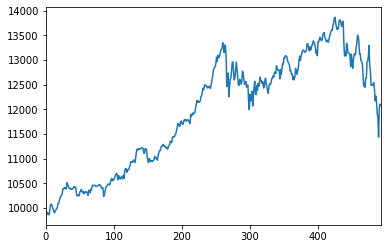

*-----Episode: 467, Reward:120.865075%-----*


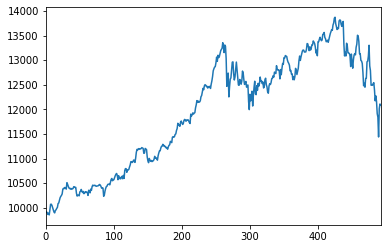

*-----Episode: 468, Reward:120.898674%-----*


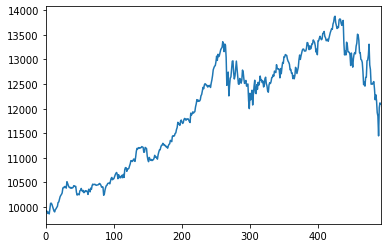

*-----Episode: 469, Reward:120.940478%-----*


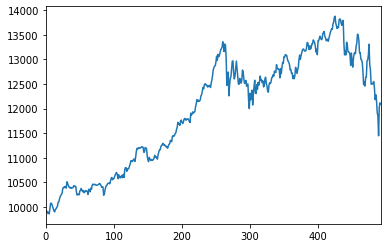

*-----Episode: 470, Reward:120.973616%-----*


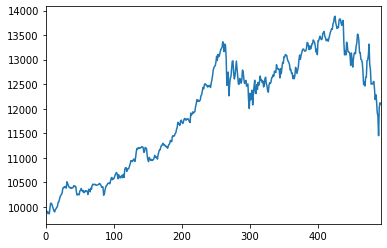

*-----Episode: 471, Reward:121.014739%-----*


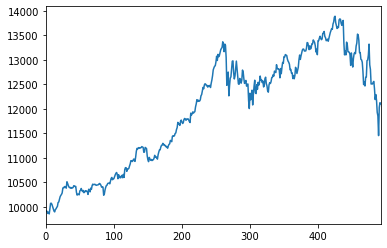

*-----Episode: 472, Reward:121.044302%-----*


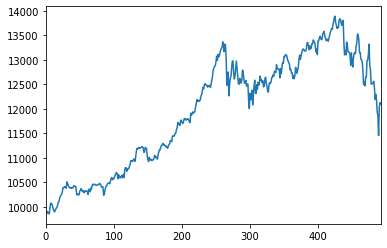

*-----Episode: 473, Reward:121.080524%-----*


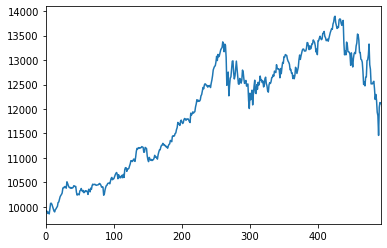

*-----Episode: 474, Reward:121.122294%-----*


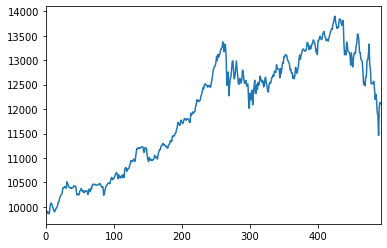

*-----Episode: 475, Reward:121.155831%-----*


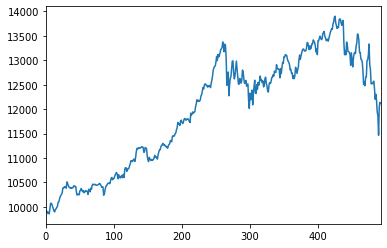

*-----Episode: 476, Reward:121.191361%-----*


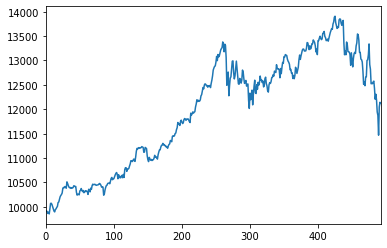

*-----Episode: 477, Reward:121.228886%-----*


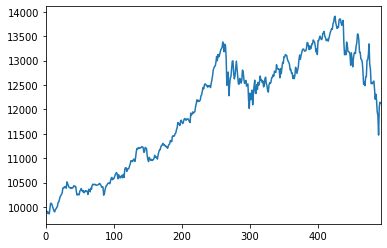

*-----Episode: 478, Reward:121.263287%-----*


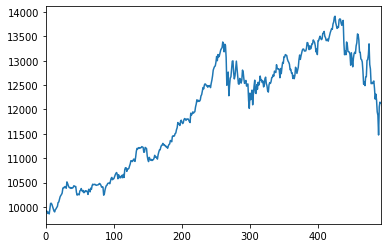

*-----Episode: 479, Reward:121.301687%-----*


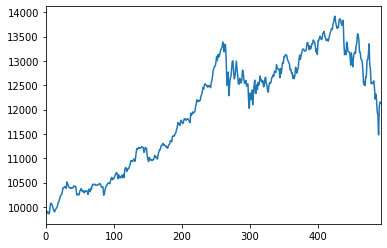

*-----Episode: 480, Reward:121.340971%-----*


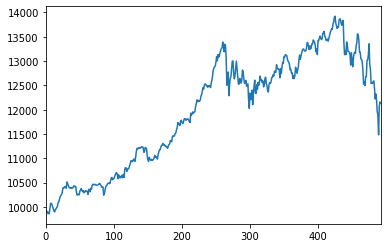

*-----Episode: 481, Reward:121.376683%-----*


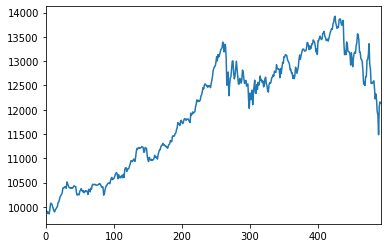

*-----Episode: 482, Reward:121.416619%-----*


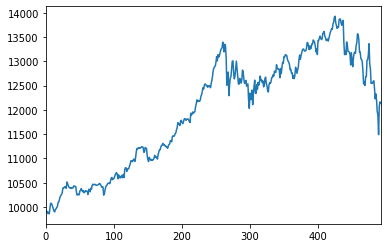

*-----Episode: 483, Reward:121.451202%-----*


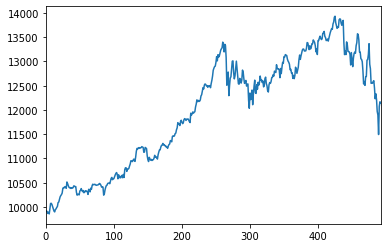

*-----Episode: 484, Reward:121.486888%-----*


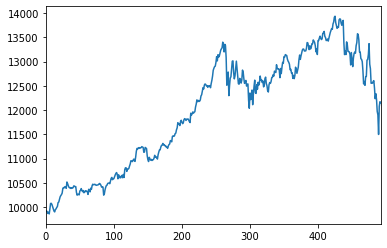

*-----Episode: 485, Reward:121.520559%-----*


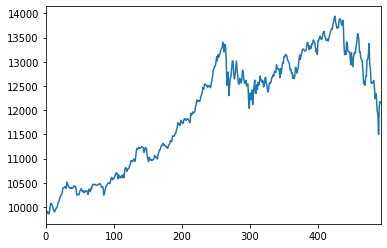

*-----Episode: 486, Reward:121.561808%-----*


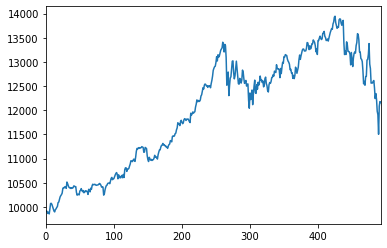

*-----Episode: 487, Reward:121.600149%-----*


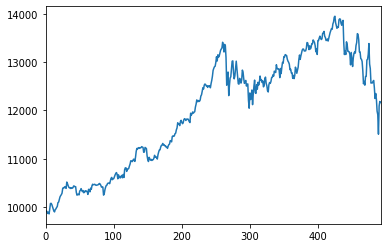

*-----Episode: 488, Reward:121.638483%-----*


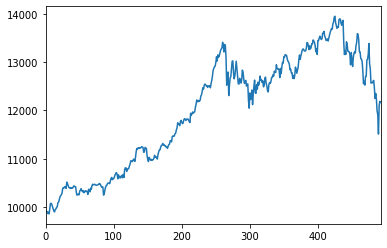

*-----Episode: 489, Reward:121.677926%-----*


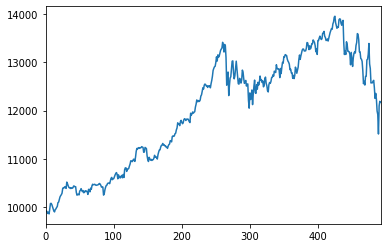

*-----Episode: 490, Reward:121.709986%-----*


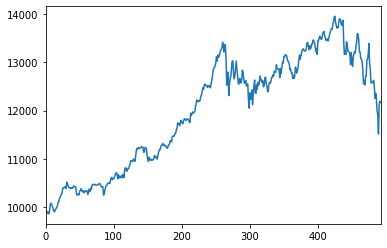

*-----Episode: 491, Reward:121.742484%-----*


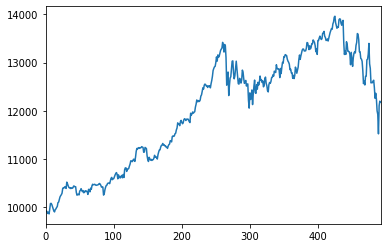

*-----Episode: 492, Reward:121.782350%-----*


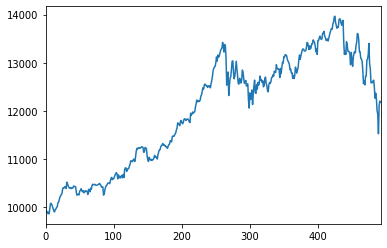

*-----Episode: 493, Reward:121.817738%-----*


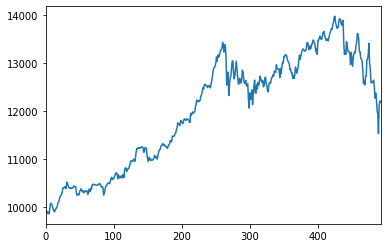

*-----Episode: 494, Reward:121.853121%-----*


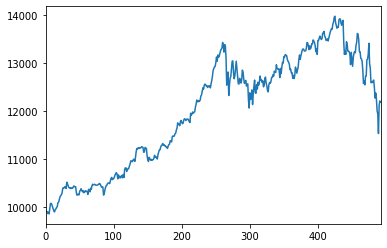

*-----Episode: 495, Reward:121.892075%-----*


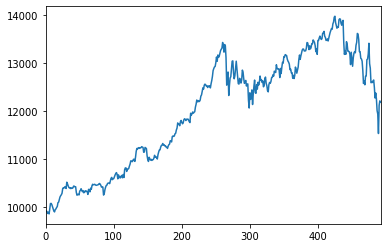

*-----Episode: 496, Reward:121.921848%-----*


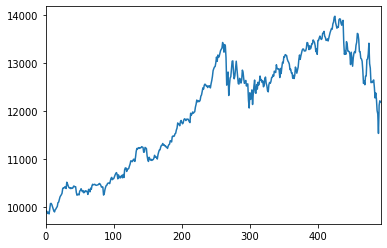

*-----Episode: 497, Reward:121.961013%-----*


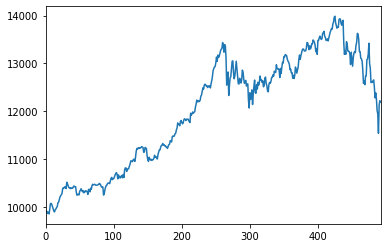

*-----Episode: 498, Reward:121.997040%-----*


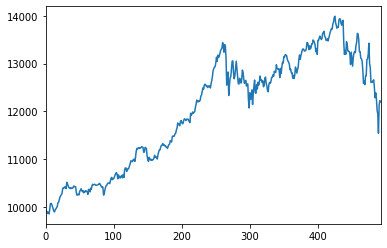

*-----Episode: 499, Reward:122.037986%-----*


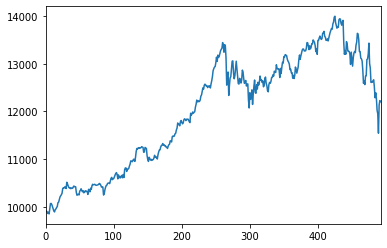

*-----Episode: 500, Reward:122.067277%-----*


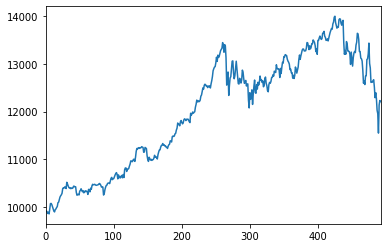

*-----Episode: 501, Reward:122.107092%-----*


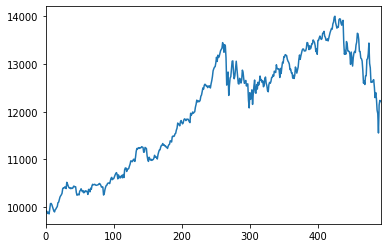

*-----Episode: 502, Reward:122.146678%-----*


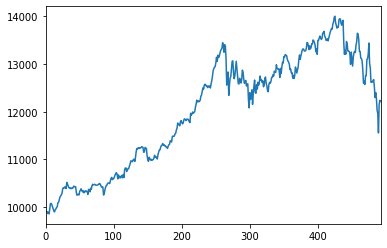

*-----Episode: 503, Reward:122.179757%-----*


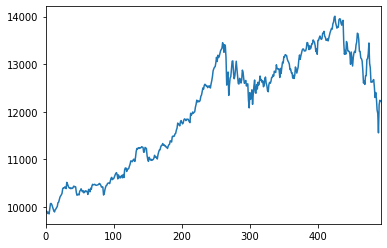

*-----Episode: 504, Reward:122.218435%-----*


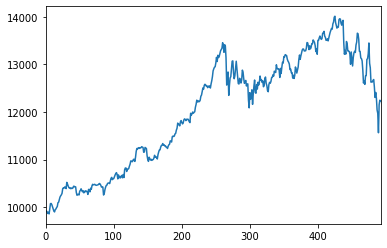

*-----Episode: 505, Reward:122.252846%-----*


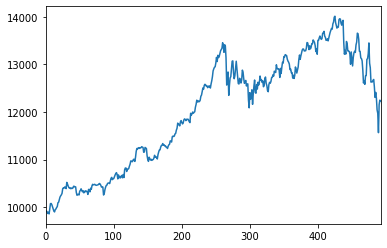

*-----Episode: 506, Reward:122.287247%-----*


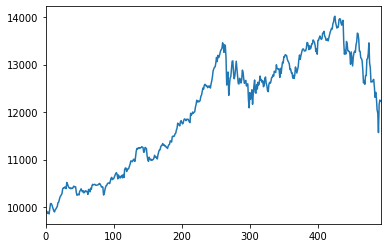

*-----Episode: 507, Reward:122.331521%-----*


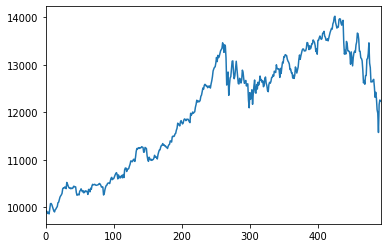

*-----Episode: 508, Reward:122.366360%-----*


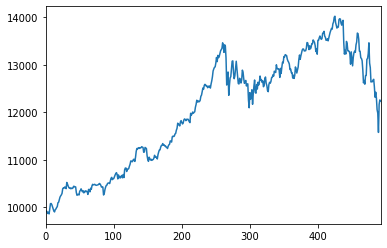

*-----Episode: 509, Reward:122.396252%-----*


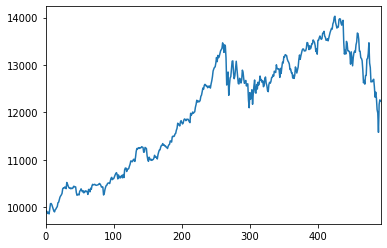

*-----Episode: 510, Reward:122.433098%-----*


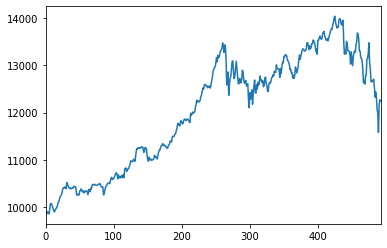

*-----Episode: 511, Reward:122.474204%-----*


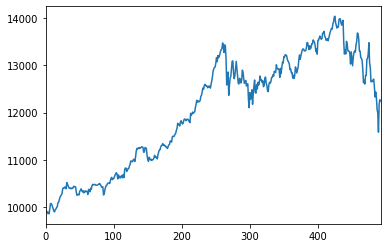

*-----Episode: 512, Reward:122.513733%-----*


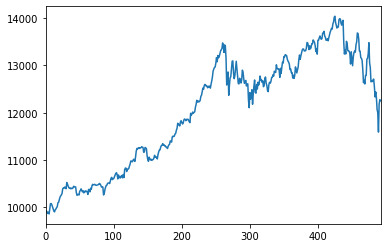

*-----Episode: 513, Reward:122.546508%-----*


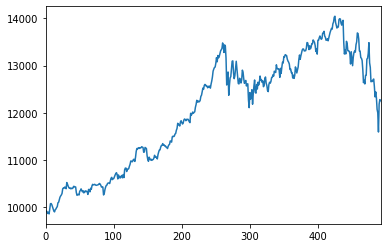

*-----Episode: 514, Reward:122.579501%-----*


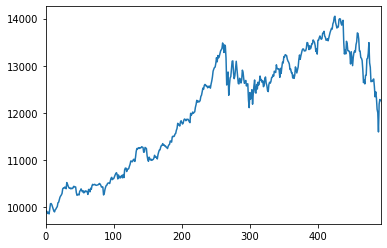

*-----Episode: 515, Reward:122.619236%-----*


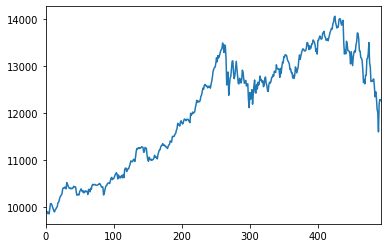

*-----Episode: 516, Reward:122.655592%-----*


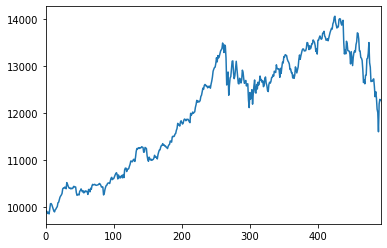

*-----Episode: 517, Reward:122.694192%-----*


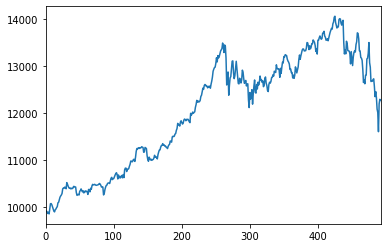

*-----Episode: 518, Reward:122.721075%-----*


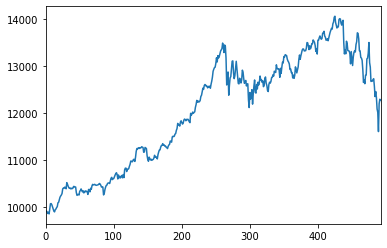

*-----Episode: 519, Reward:122.767549%-----*


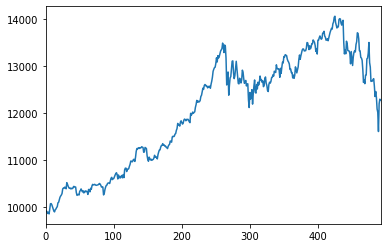

*-----Episode: 520, Reward:122.796217%-----*


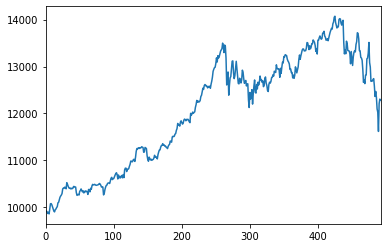

*-----Episode: 521, Reward:122.837951%-----*


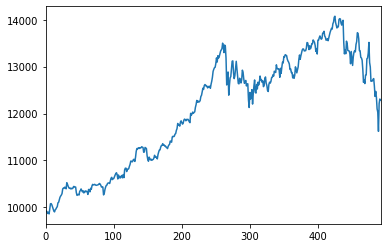

*-----Episode: 522, Reward:122.874722%-----*


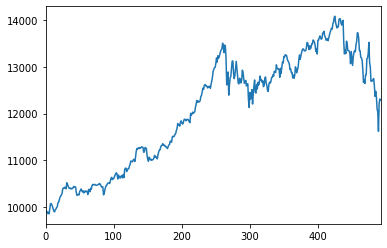

*-----Episode: 523, Reward:122.909908%-----*


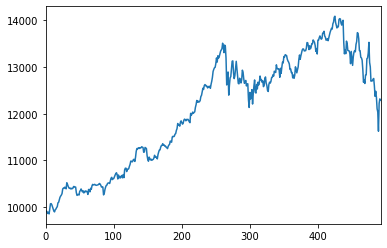

*-----Episode: 524, Reward:122.948020%-----*


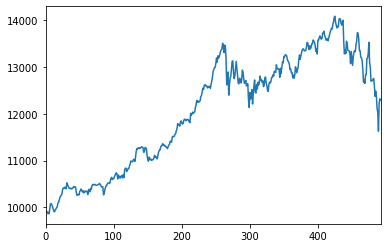

*-----Episode: 525, Reward:122.983420%-----*


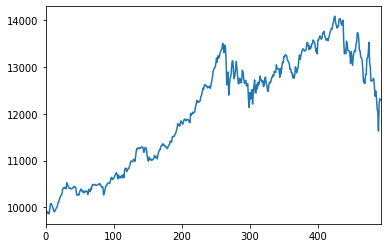

*-----Episode: 526, Reward:123.013619%-----*


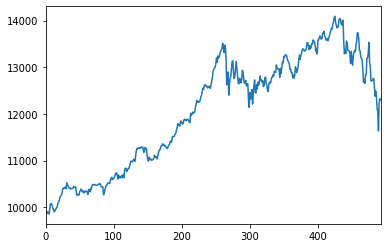

*-----Episode: 527, Reward:123.052619%-----*


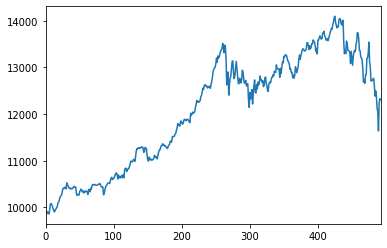

*-----Episode: 528, Reward:123.095004%-----*


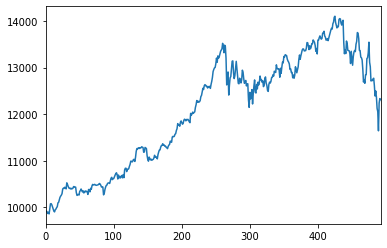

*-----Episode: 529, Reward:123.127217%-----*


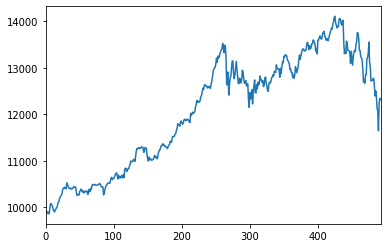

*-----Episode: 530, Reward:123.161005%-----*


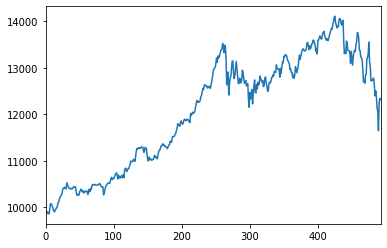

*-----Episode: 531, Reward:123.195916%-----*


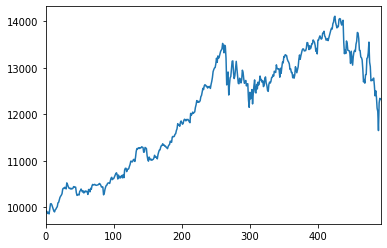

*-----Episode: 532, Reward:123.237608%-----*


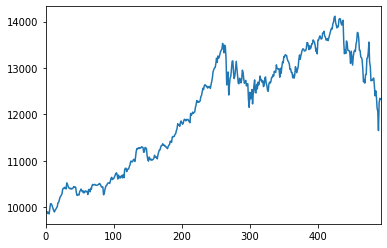

*-----Episode: 533, Reward:123.270926%-----*


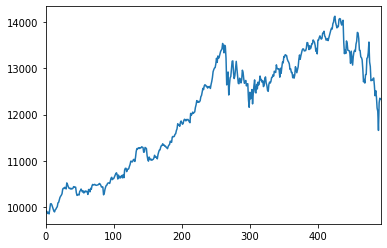

*-----Episode: 534, Reward:123.305594%-----*


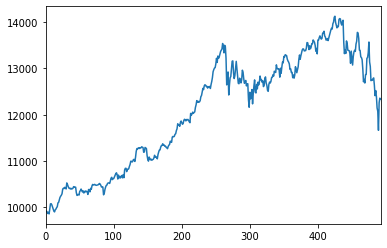

*-----Episode: 535, Reward:123.347050%-----*


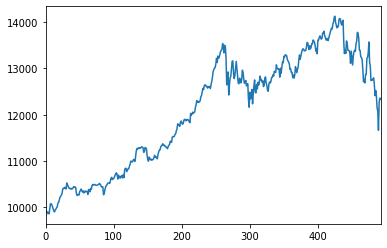

*-----Episode: 536, Reward:123.382840%-----*


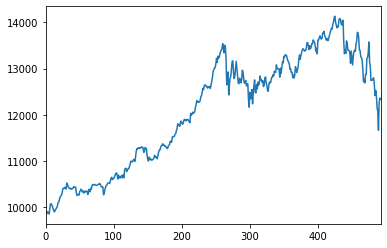

*-----Episode: 537, Reward:123.415447%-----*


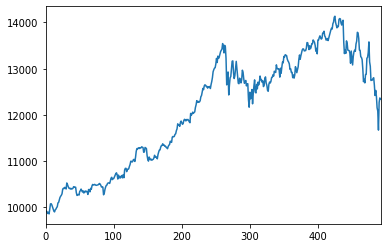

*-----Episode: 538, Reward:123.457565%-----*


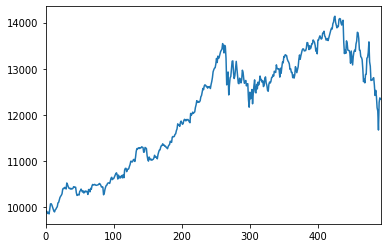

*-----Episode: 539, Reward:123.489932%-----*


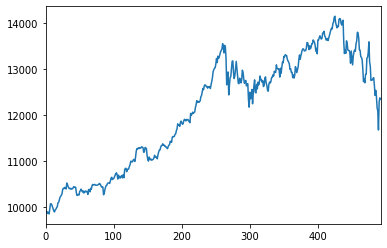

*-----Episode: 540, Reward:123.525467%-----*


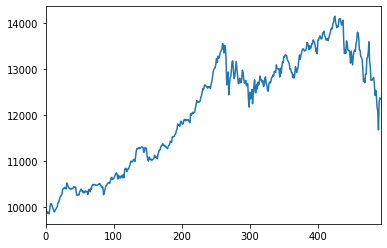

*-----Episode: 541, Reward:123.559861%-----*


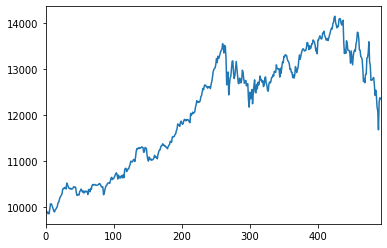

*-----Episode: 542, Reward:123.598106%-----*


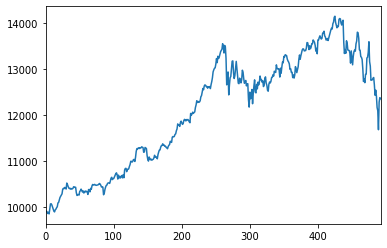

*-----Episode: 543, Reward:123.635894%-----*


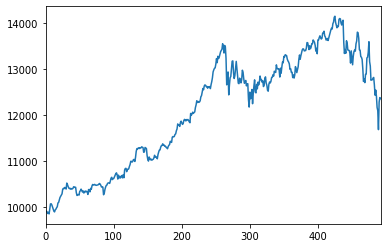

*-----Episode: 544, Reward:123.674130%-----*


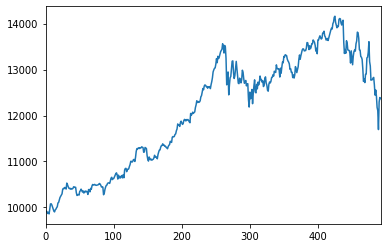

*-----Episode: 545, Reward:123.704415%-----*


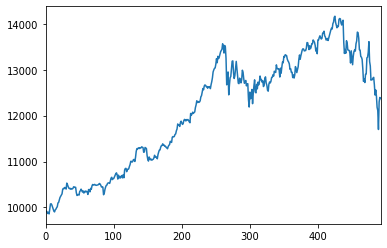

*-----Episode: 546, Reward:123.743098%-----*


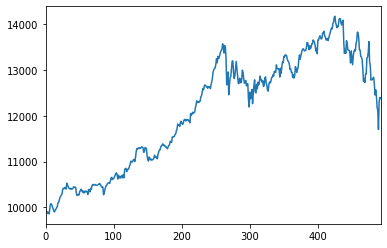

*-----Episode: 547, Reward:123.776549%-----*


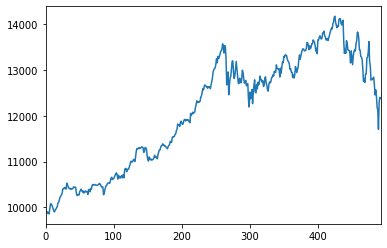

*-----Episode: 548, Reward:123.814996%-----*


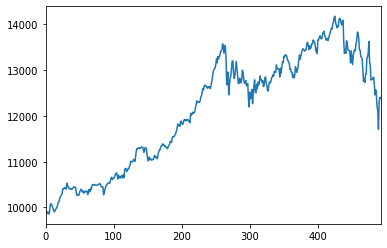

*-----Episode: 549, Reward:123.856393%-----*


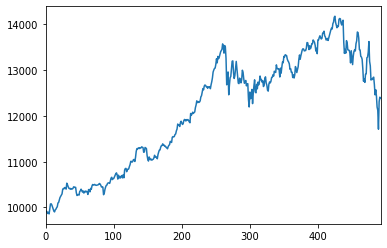

*-----Episode: 550, Reward:123.888238%-----*


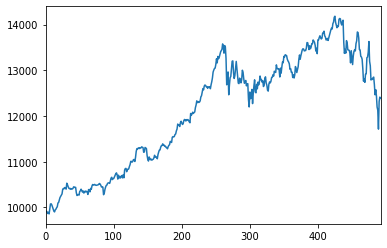

*-----Episode: 551, Reward:123.925990%-----*


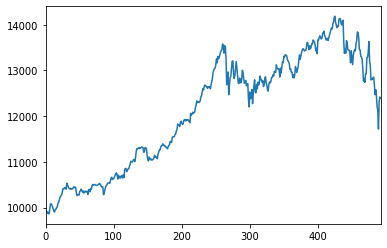

*-----Episode: 552, Reward:123.952591%-----*


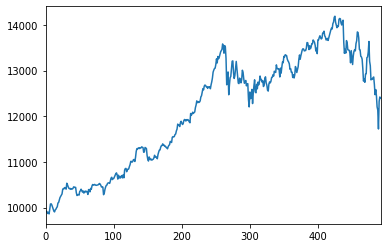

*-----Episode: 553, Reward:123.993974%-----*


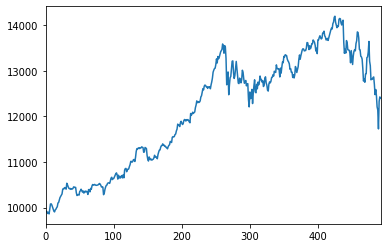

*-----Episode: 554, Reward:124.032851%-----*


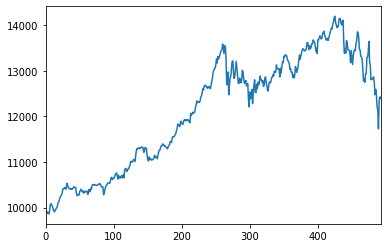

*-----Episode: 555, Reward:124.070129%-----*


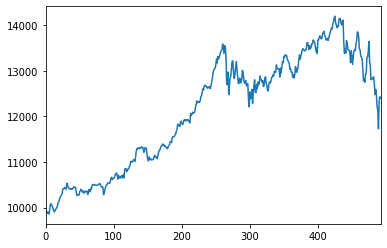

*-----Episode: 556, Reward:124.097837%-----*


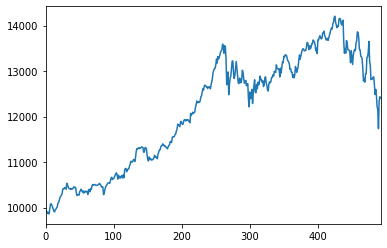

*-----Episode: 557, Reward:124.137386%-----*


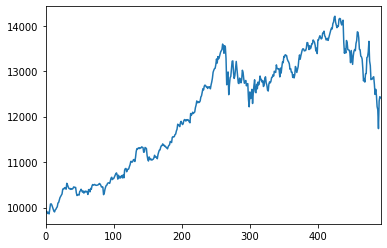

*-----Episode: 558, Reward:124.171920%-----*


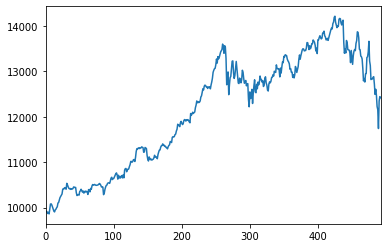

*-----Episode: 559, Reward:124.208042%-----*


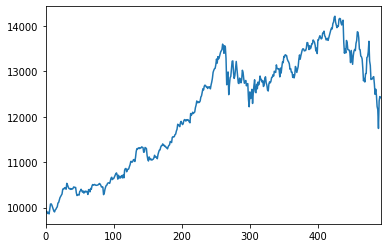

*-----Episode: 560, Reward:124.247582%-----*


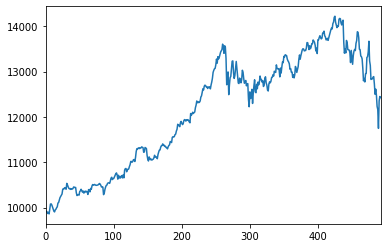

*-----Episode: 561, Reward:124.284839%-----*


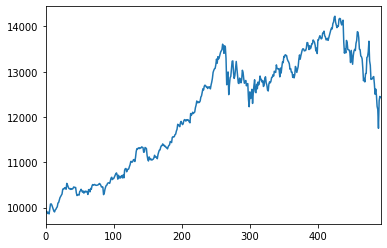

*-----Episode: 562, Reward:124.320953%-----*


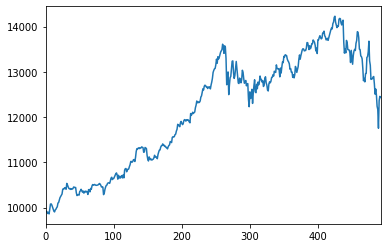

*-----Episode: 563, Reward:124.356377%-----*


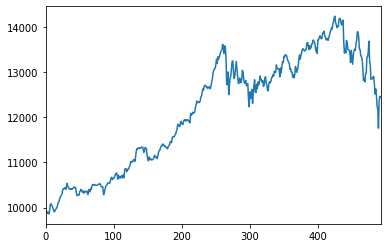

*-----Episode: 564, Reward:124.395907%-----*


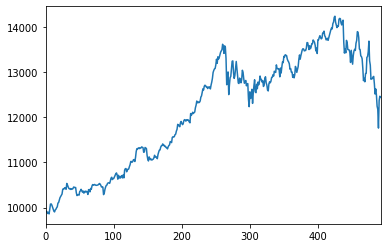

*-----Episode: 565, Reward:124.431550%-----*


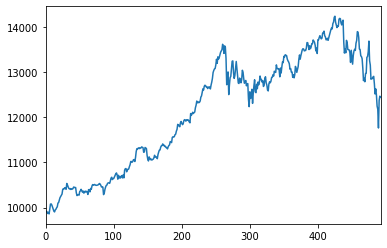

*-----Episode: 566, Reward:124.468105%-----*


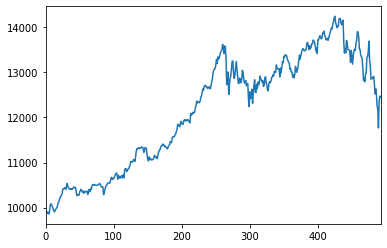

*-----Episode: 567, Reward:124.502371%-----*


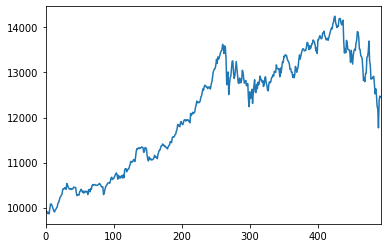

*-----Episode: 568, Reward:124.539831%-----*


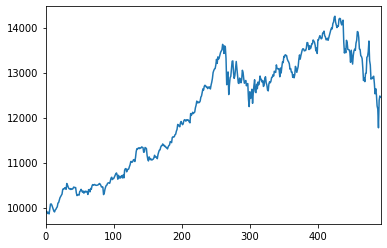

*-----Episode: 569, Reward:124.574316%-----*


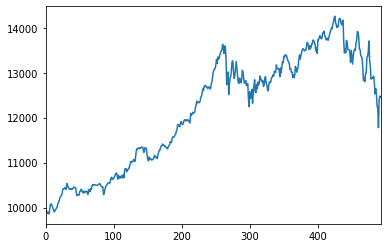

*-----Episode: 570, Reward:124.604679%-----*


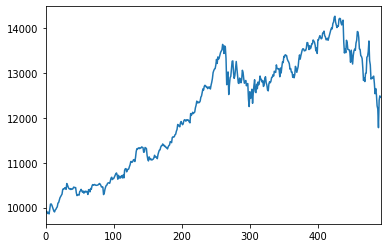

*-----Episode: 571, Reward:124.642811%-----*


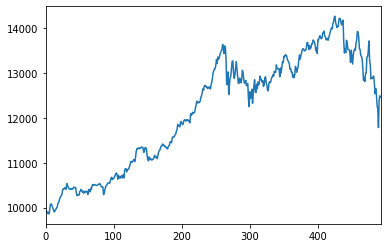

*-----Episode: 572, Reward:124.681855%-----*


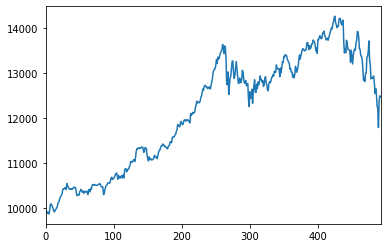

*-----Episode: 573, Reward:124.720208%-----*


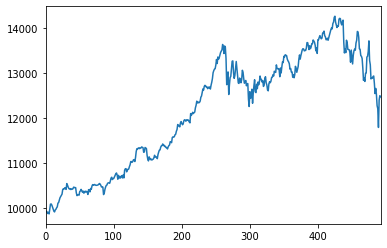

*-----Episode: 574, Reward:124.749862%-----*


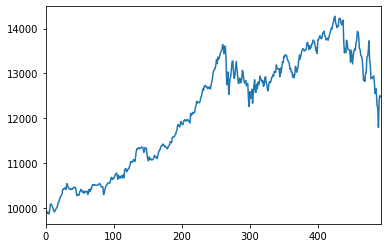

*-----Episode: 575, Reward:124.793248%-----*


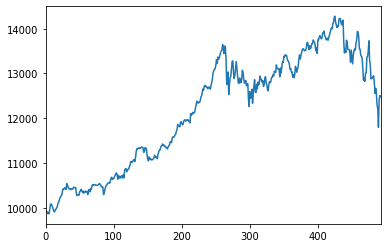

*-----Episode: 576, Reward:124.829536%-----*


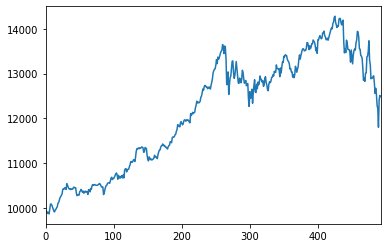

*-----Episode: 577, Reward:124.864672%-----*


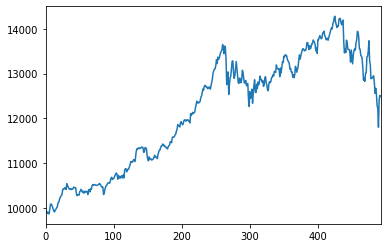

*-----Episode: 578, Reward:124.895221%-----*


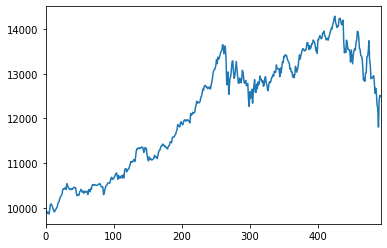

*-----Episode: 579, Reward:124.933099%-----*


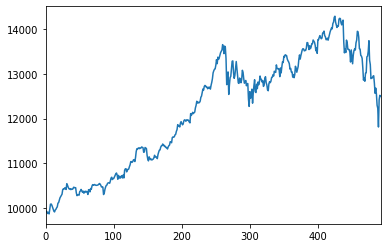

*-----Episode: 580, Reward:124.971892%-----*


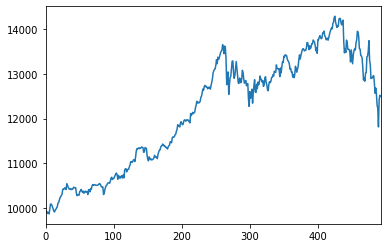

*-----Episode: 581, Reward:125.010222%-----*


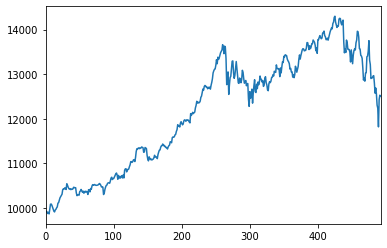

*-----Episode: 582, Reward:125.043732%-----*


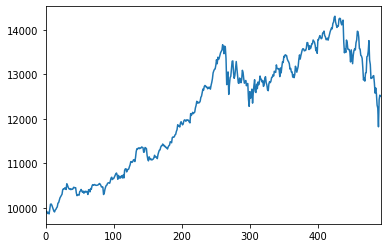

*-----Episode: 583, Reward:125.078612%-----*


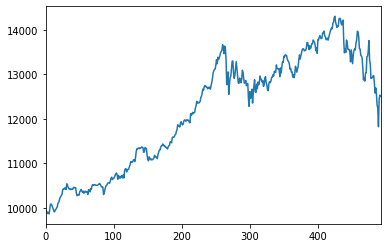

*-----Episode: 584, Reward:125.113718%-----*


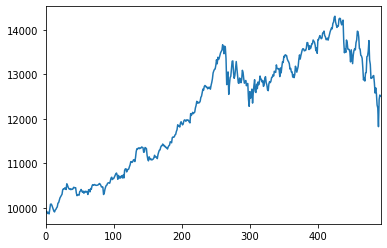

*-----Episode: 585, Reward:125.146752%-----*


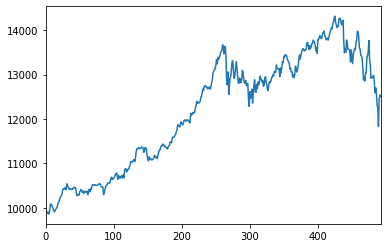

*-----Episode: 586, Reward:125.186903%-----*


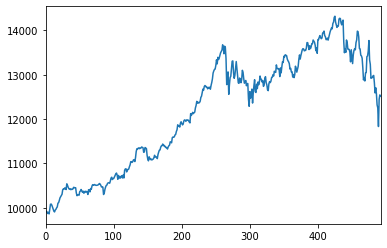

*-----Episode: 587, Reward:125.219009%-----*


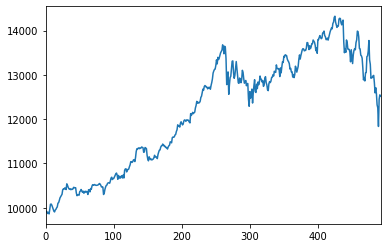

*-----Episode: 588, Reward:125.254557%-----*


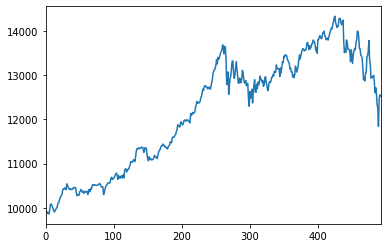

*-----Episode: 589, Reward:125.293090%-----*


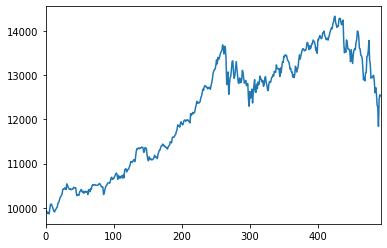

*-----Episode: 590, Reward:125.332773%-----*


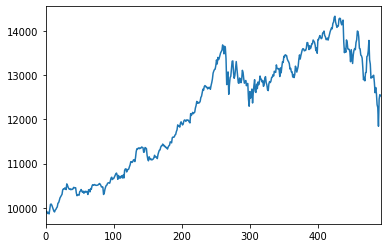

*-----Episode: 591, Reward:125.372223%-----*


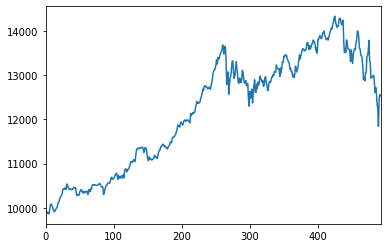

*-----Episode: 592, Reward:125.403384%-----*


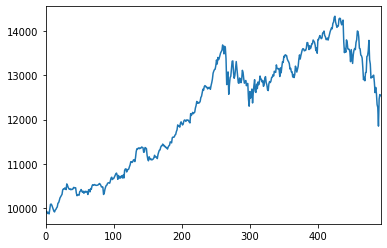

*-----Episode: 593, Reward:125.440293%-----*


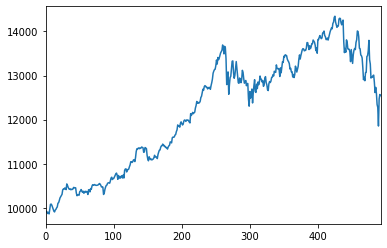

*-----Episode: 594, Reward:125.476507%-----*


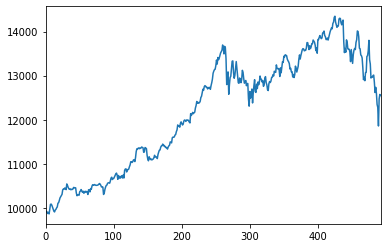

*-----Episode: 595, Reward:125.505342%-----*


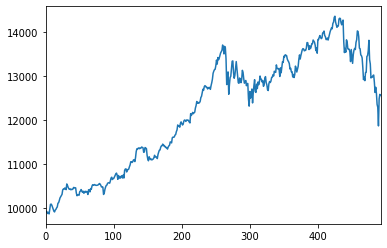

*-----Episode: 596, Reward:125.549376%-----*


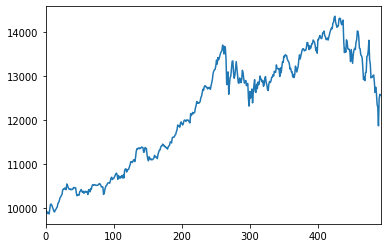

*-----Episode: 597, Reward:125.583271%-----*


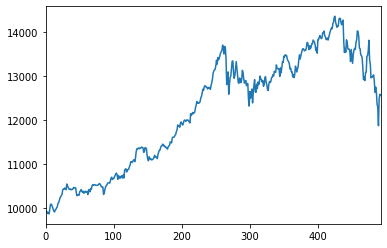

*-----Episode: 598, Reward:125.617621%-----*


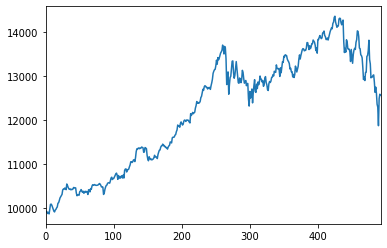

*-----Episode: 599, Reward:125.654731%-----*


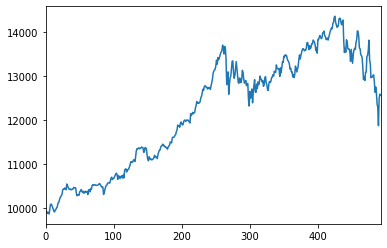

*-----Episode: 600, Reward:125.689067%-----*


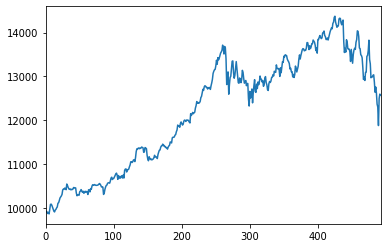

*-----Episode: 601, Reward:125.724553%-----*


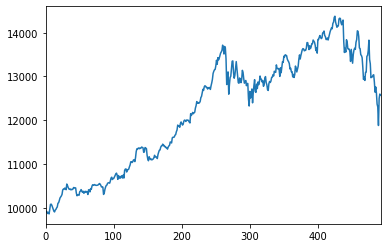

*-----Episode: 602, Reward:125.759112%-----*


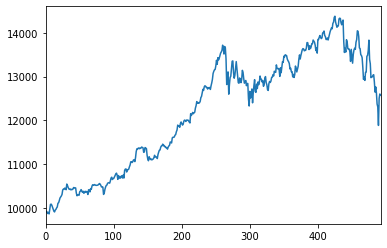

*-----Episode: 603, Reward:125.795512%-----*


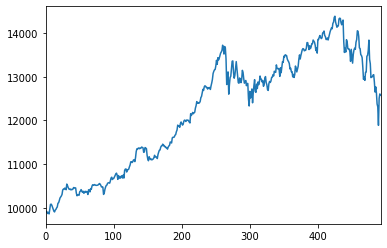

*-----Episode: 604, Reward:125.834909%-----*


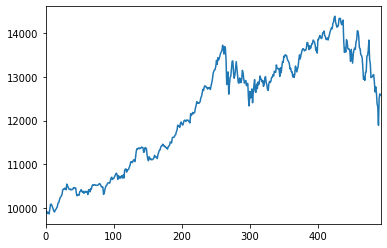

*-----Episode: 605, Reward:125.871302%-----*


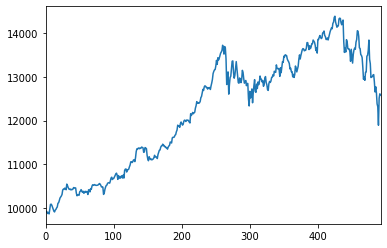

*-----Episode: 606, Reward:125.904688%-----*


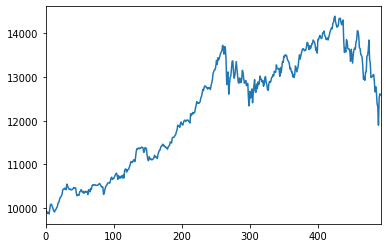

*-----Episode: 607, Reward:125.946157%-----*


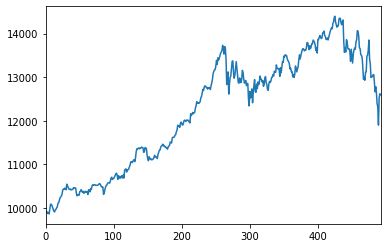

*-----Episode: 608, Reward:125.975139%-----*


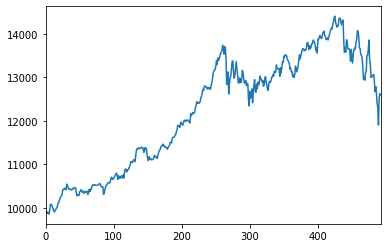

*-----Episode: 609, Reward:126.011283%-----*


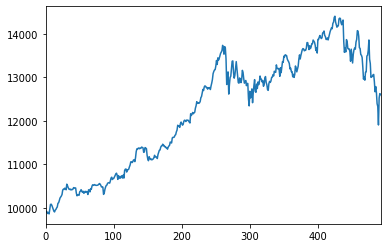

*-----Episode: 610, Reward:126.047193%-----*


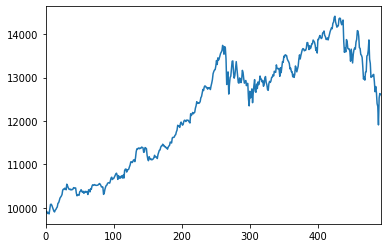

*-----Episode: 611, Reward:126.088422%-----*


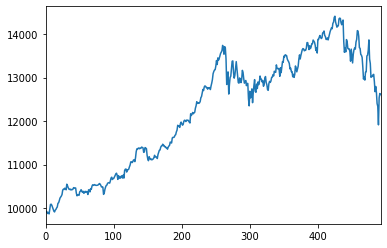

*-----Episode: 612, Reward:126.118308%-----*


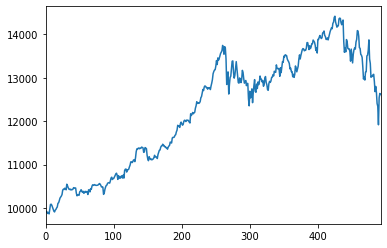

*-----Episode: 613, Reward:126.152354%-----*


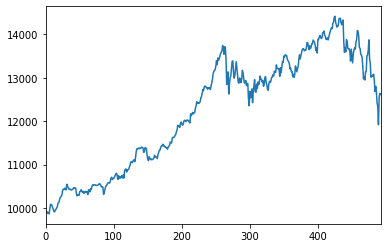

*-----Episode: 614, Reward:126.194501%-----*


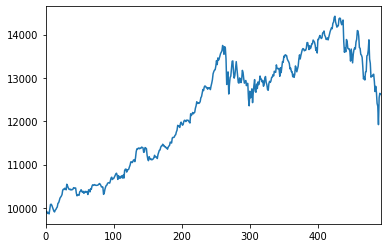

*-----Episode: 615, Reward:126.230161%-----*


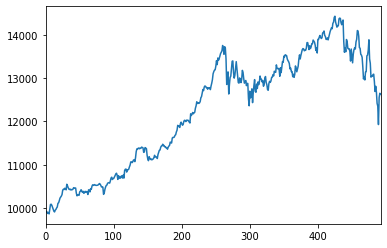

*-----Episode: 616, Reward:126.266282%-----*


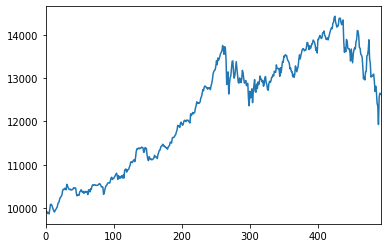

*-----Episode: 617, Reward:126.297529%-----*


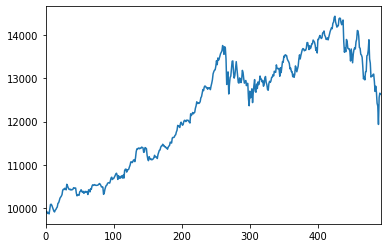

*-----Episode: 618, Reward:126.335265%-----*


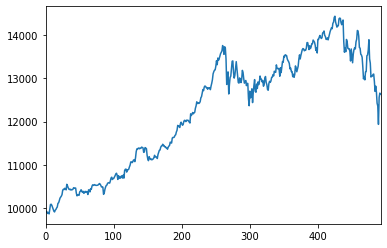

*-----Episode: 619, Reward:126.368589%-----*


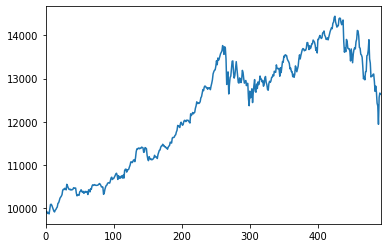

*-----Episode: 620, Reward:126.405390%-----*


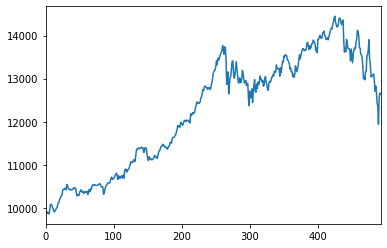

*-----Episode: 621, Reward:126.440795%-----*


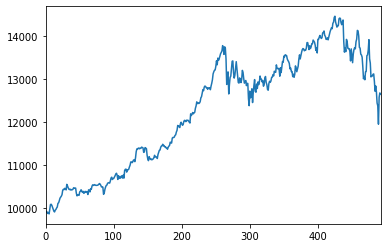

*-----Episode: 622, Reward:126.481302%-----*


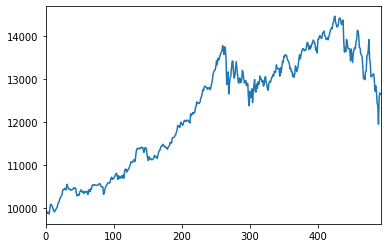

*-----Episode: 623, Reward:126.522271%-----*


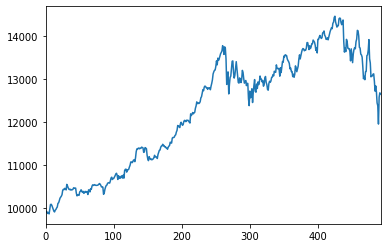

*-----Episode: 624, Reward:126.550000%-----*


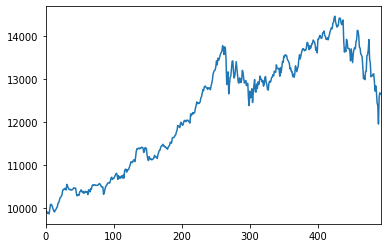

*-----Episode: 625, Reward:126.586085%-----*


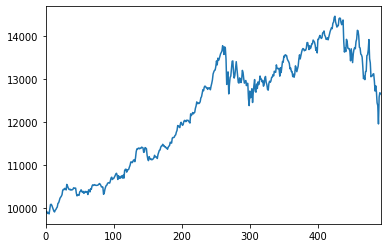

*-----Episode: 626, Reward:126.621704%-----*


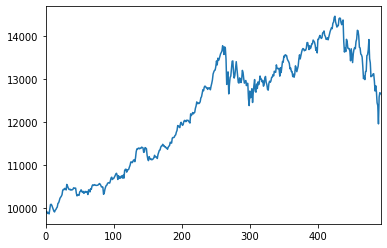

*-----Episode: 627, Reward:126.655922%-----*


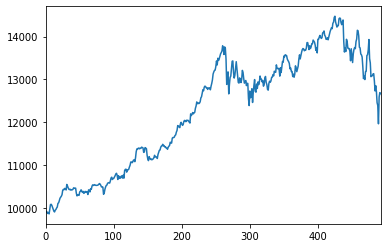

*-----Episode: 628, Reward:126.698275%-----*


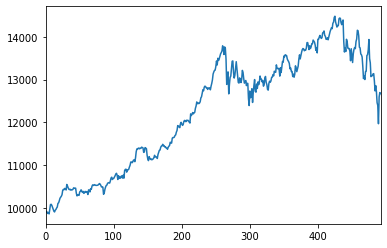

*-----Episode: 629, Reward:126.734117%-----*


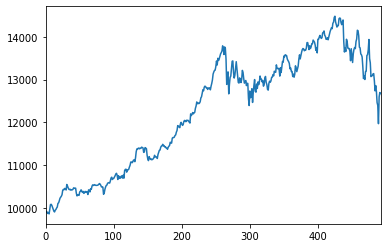

*-----Episode: 630, Reward:126.764603%-----*


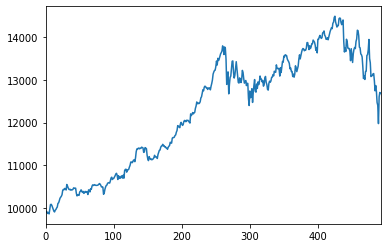

*-----Episode: 631, Reward:126.806023%-----*


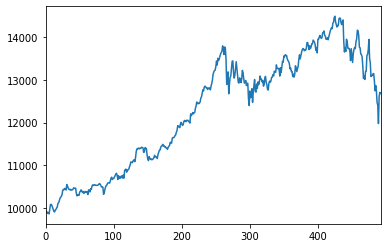

*-----Episode: 632, Reward:126.832774%-----*


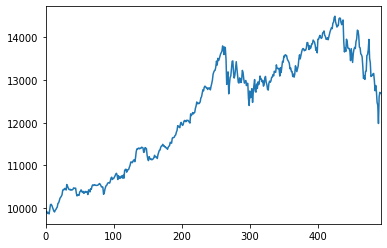

*-----Episode: 633, Reward:126.870464%-----*


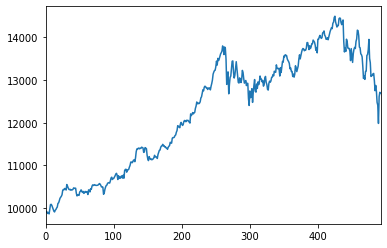

*-----Episode: 634, Reward:126.905356%-----*


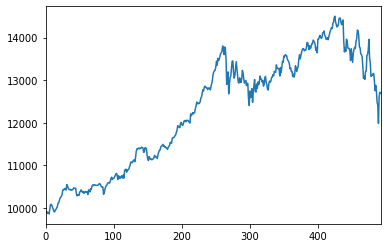

*-----Episode: 635, Reward:126.944895%-----*


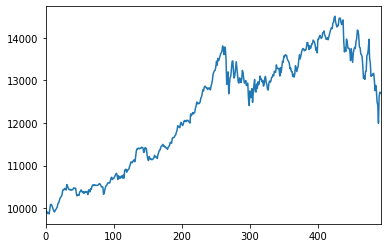

*-----Episode: 636, Reward:126.980002%-----*


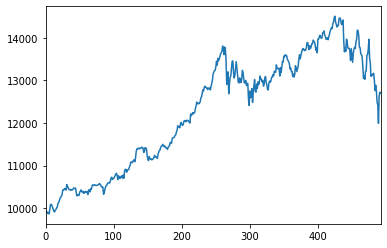

*-----Episode: 637, Reward:127.016966%-----*


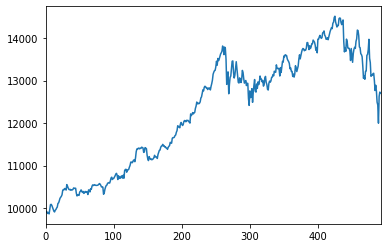

*-----Episode: 638, Reward:127.054159%-----*


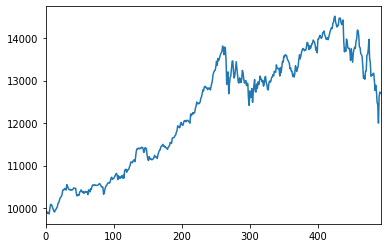

*-----Episode: 639, Reward:127.093680%-----*


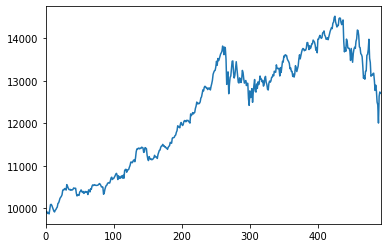

*-----Episode: 640, Reward:127.125501%-----*


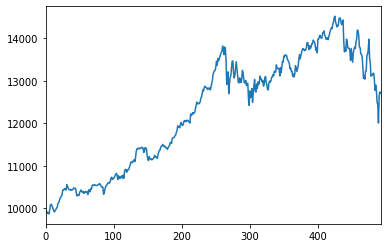

*-----Episode: 641, Reward:127.159650%-----*


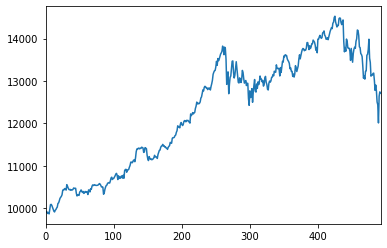

*-----Episode: 642, Reward:127.195659%-----*


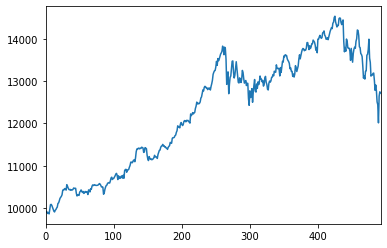

*-----Episode: 643, Reward:127.237268%-----*


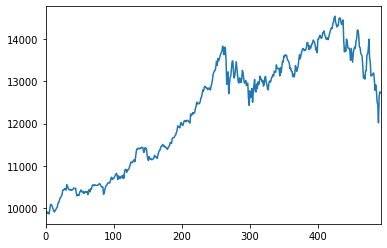

*-----Episode: 644, Reward:127.270002%-----*


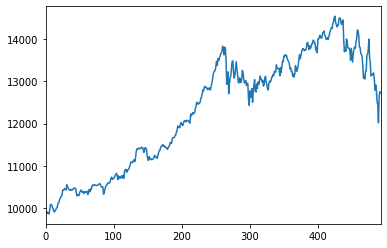

*-----Episode: 645, Reward:127.305065%-----*


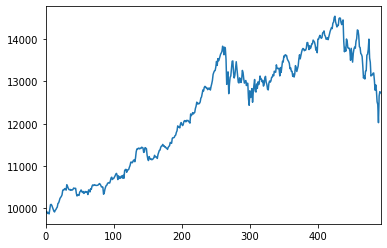

*-----Episode: 646, Reward:127.342463%-----*


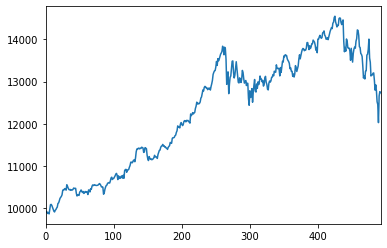

*-----Episode: 647, Reward:127.370738%-----*


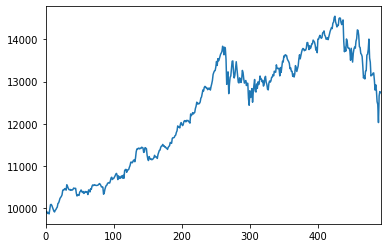

*-----Episode: 648, Reward:127.406957%-----*


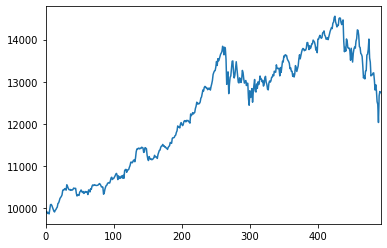

*-----Episode: 649, Reward:127.447851%-----*


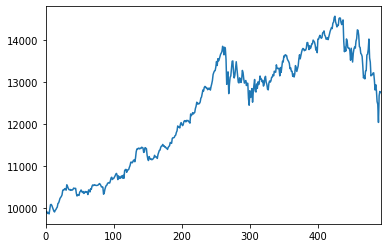

*-----Episode: 650, Reward:127.484064%-----*


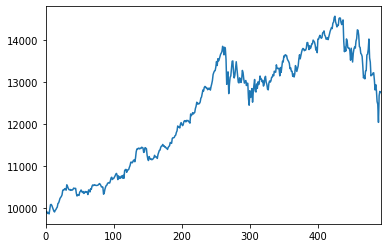

*-----Episode: 651, Reward:127.517699%-----*


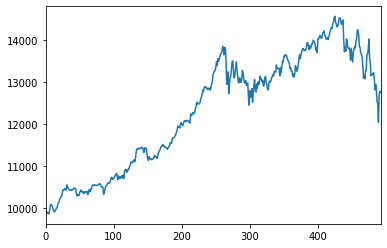

*-----Episode: 652, Reward:127.560224%-----*


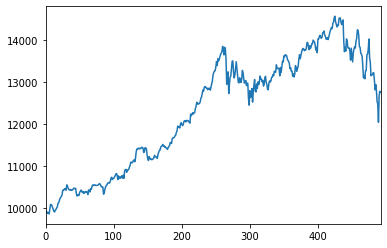

*-----Episode: 653, Reward:127.591742%-----*


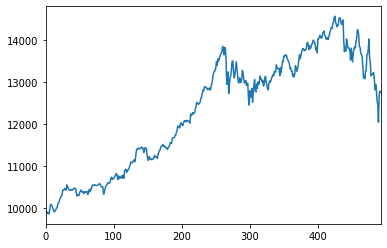

*-----Episode: 654, Reward:127.625600%-----*


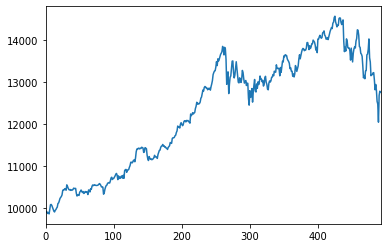

*-----Episode: 655, Reward:127.655229%-----*


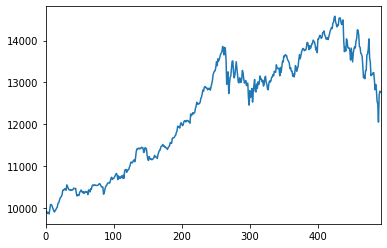

*-----Episode: 656, Reward:127.697509%-----*


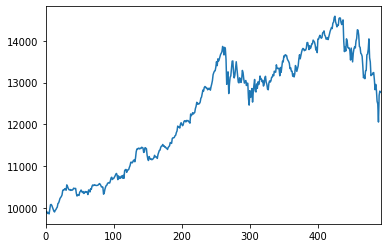

*-----Episode: 657, Reward:127.725957%-----*


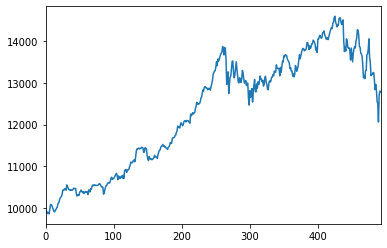

*-----Episode: 658, Reward:127.770813%-----*


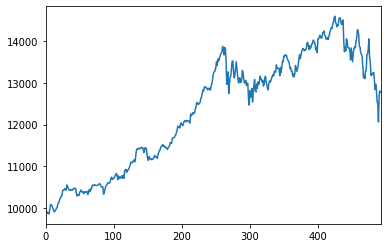

*-----Episode: 659, Reward:127.799017%-----*


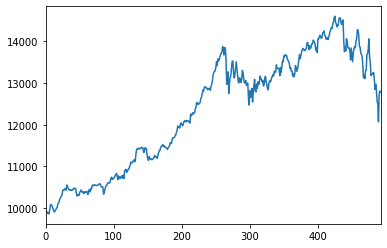

*-----Episode: 660, Reward:127.836128%-----*


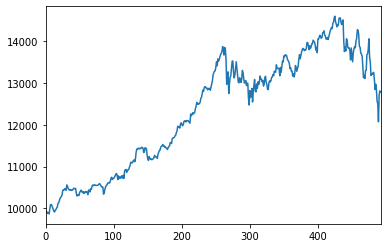

*-----Episode: 661, Reward:127.874878%-----*


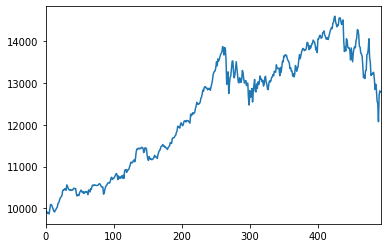

*-----Episode: 662, Reward:127.912925%-----*


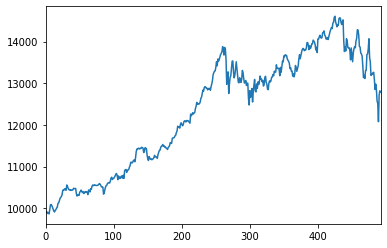

*-----Episode: 663, Reward:127.942045%-----*


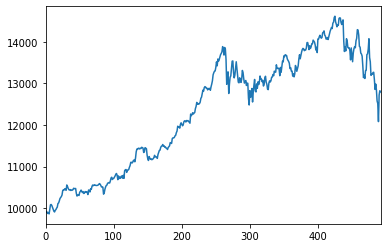

*-----Episode: 664, Reward:127.981963%-----*


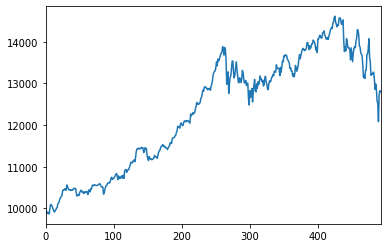

*-----Episode: 665, Reward:128.018355%-----*


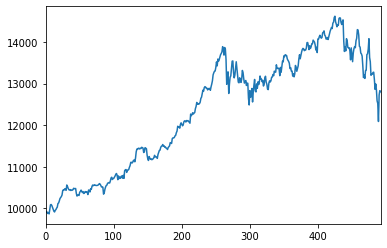

*-----Episode: 666, Reward:128.054272%-----*


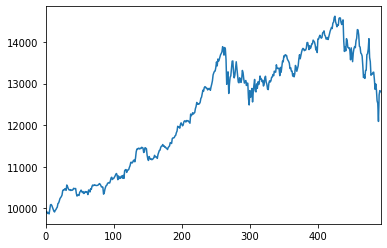

*-----Episode: 667, Reward:128.091834%-----*


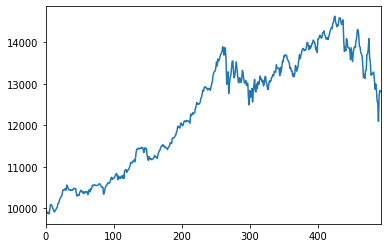

*-----Episode: 668, Reward:128.119985%-----*


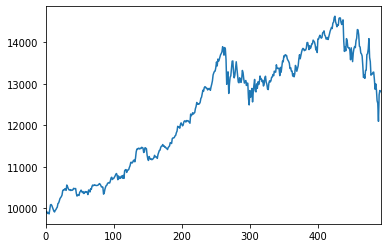

*-----Episode: 669, Reward:128.159655%-----*


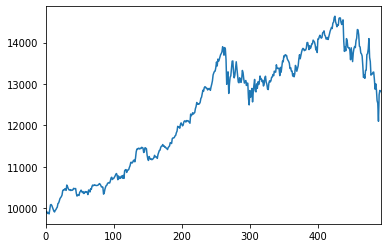

*-----Episode: 670, Reward:128.200499%-----*


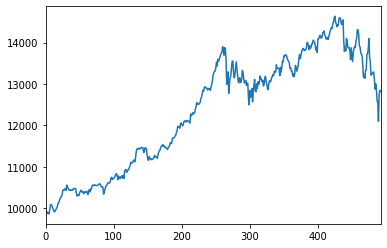

*-----Episode: 671, Reward:128.229340%-----*


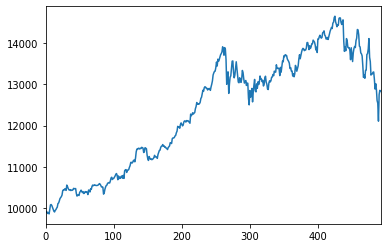

*-----Episode: 672, Reward:128.269471%-----*


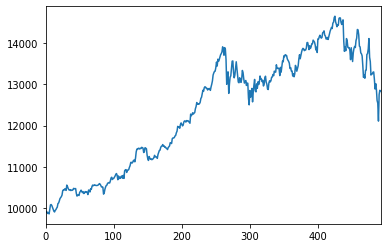

*-----Episode: 673, Reward:128.305835%-----*


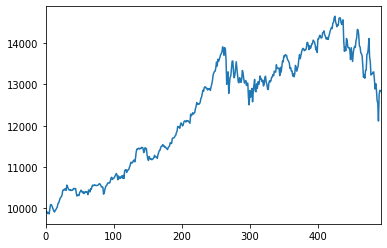

*-----Episode: 674, Reward:128.340547%-----*


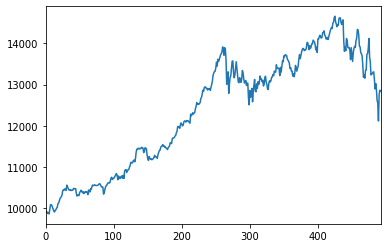

*-----Episode: 675, Reward:128.379258%-----*


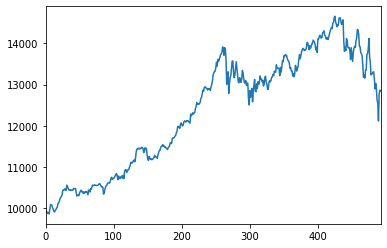

*-----Episode: 676, Reward:128.410188%-----*


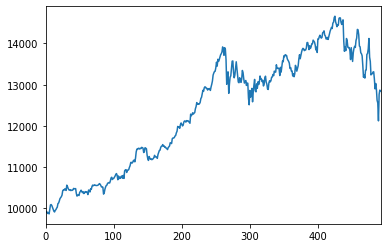

*-----Episode: 677, Reward:128.449837%-----*


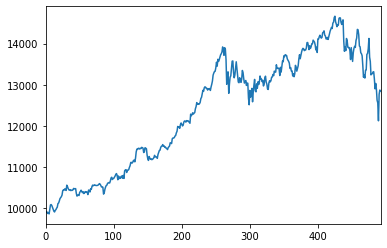

*-----Episode: 678, Reward:128.486182%-----*


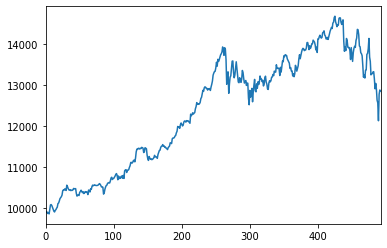

*-----Episode: 679, Reward:128.521108%-----*


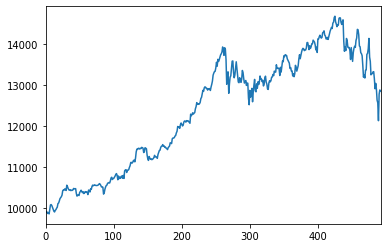

*-----Episode: 680, Reward:128.553199%-----*


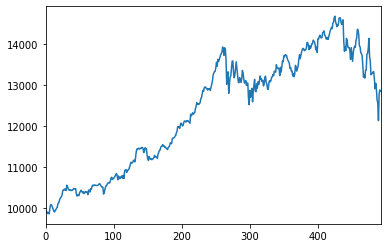

*-----Episode: 681, Reward:128.589766%-----*


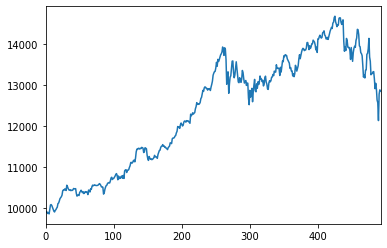

*-----Episode: 682, Reward:128.625386%-----*


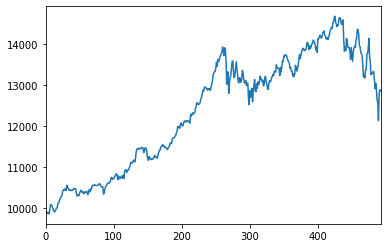

*-----Episode: 683, Reward:128.665252%-----*


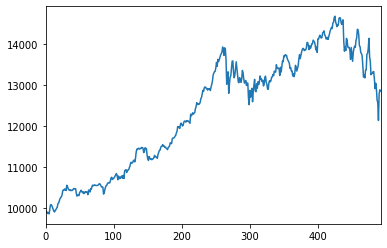

*-----Episode: 684, Reward:128.691652%-----*


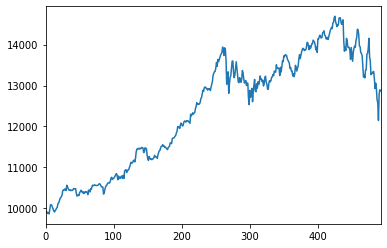

*-----Episode: 685, Reward:128.730331%-----*


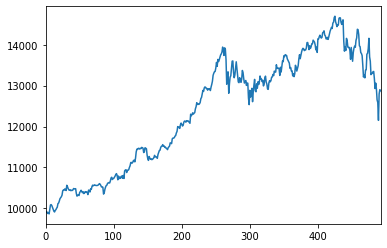

*-----Episode: 686, Reward:128.763099%-----*


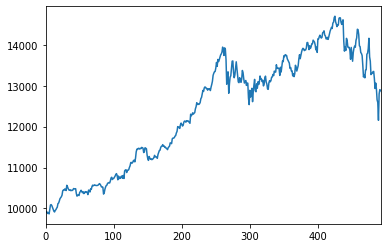

*-----Episode: 687, Reward:128.803423%-----*


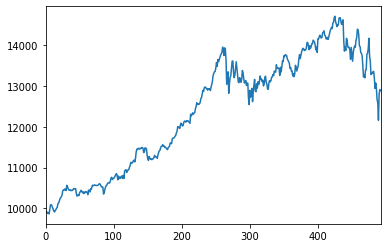

*-----Episode: 688, Reward:128.836418%-----*


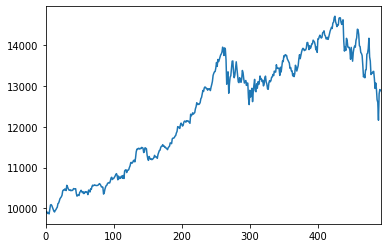

*-----Episode: 689, Reward:128.872717%-----*


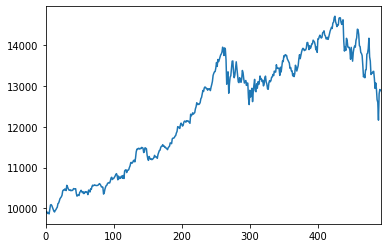

*-----Episode: 690, Reward:128.909013%-----*


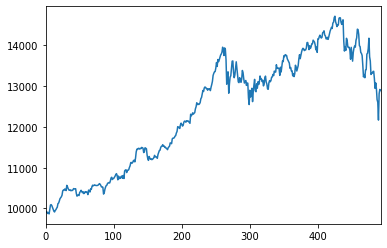

*-----Episode: 691, Reward:128.945305%-----*


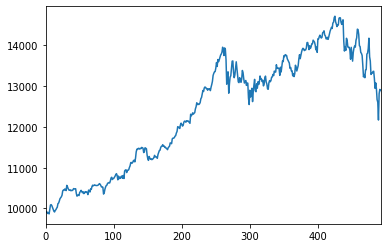

*-----Episode: 692, Reward:128.974016%-----*


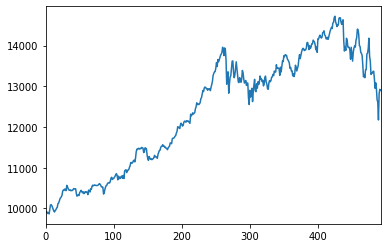

*-----Episode: 693, Reward:129.014798%-----*


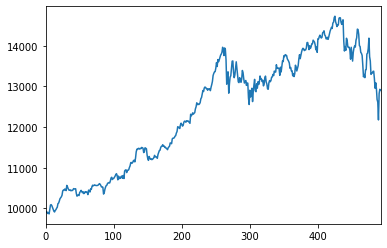

*-----Episode: 694, Reward:129.052024%-----*


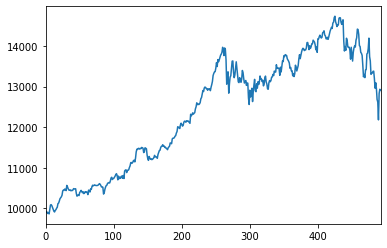

*-----Episode: 695, Reward:129.086167%-----*


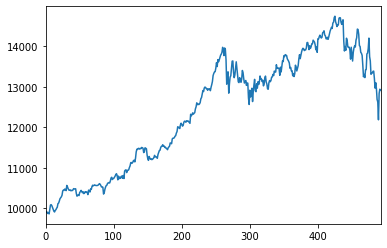

*-----Episode: 696, Reward:129.127415%-----*


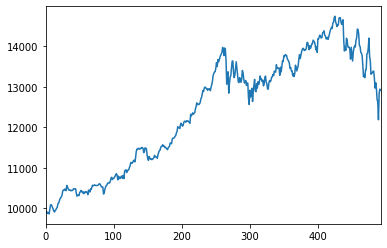

*-----Episode: 697, Reward:129.155385%-----*


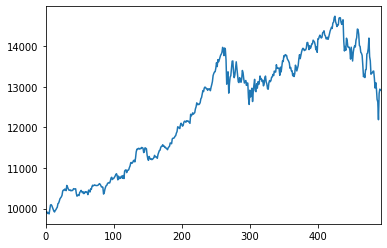

*-----Episode: 698, Reward:129.189987%-----*


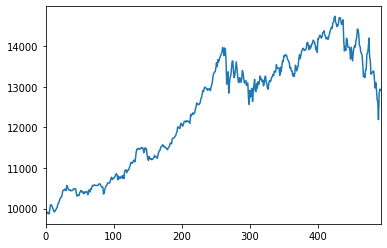

*-----Episode: 699, Reward:129.226956%-----*


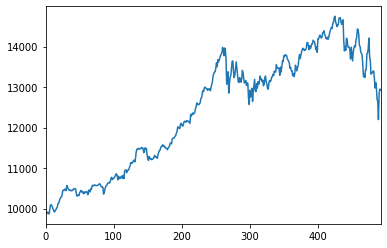

*-----Episode: 700, Reward:129.267479%-----*


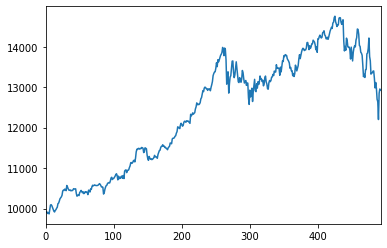

*-----Episode: 701, Reward:129.300881%-----*


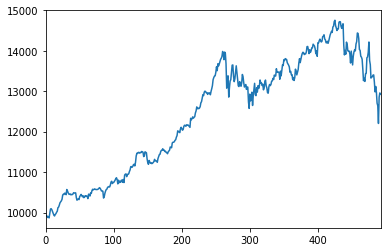

*-----Episode: 702, Reward:129.344249%-----*


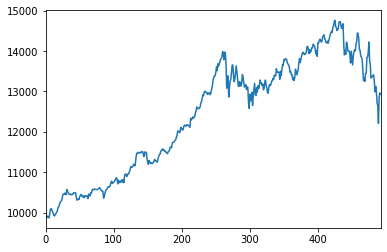

*-----Episode: 703, Reward:129.367670%-----*


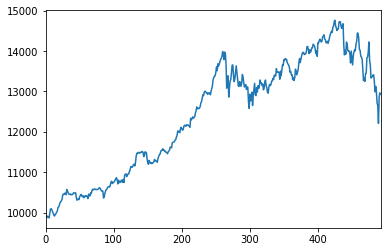

*-----Episode: 704, Reward:129.409841%-----*


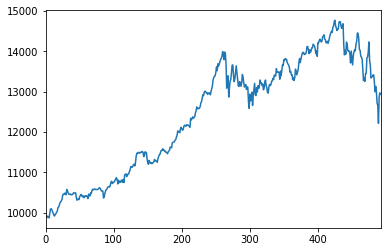

*-----Episode: 705, Reward:129.438234%-----*


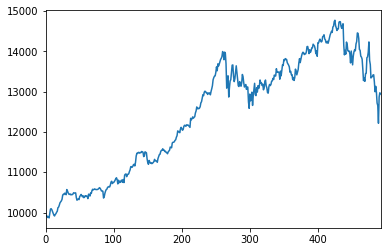

*-----Episode: 706, Reward:129.474696%-----*


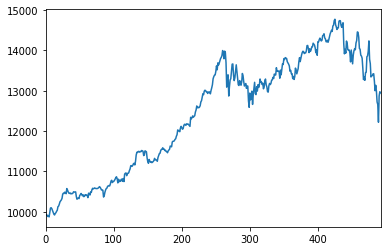

*-----Episode: 707, Reward:129.512103%-----*


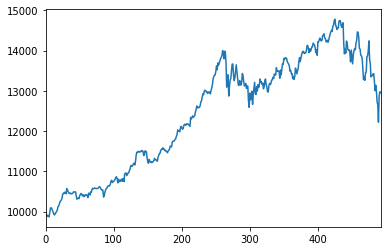

*-----Episode: 708, Reward:129.549020%-----*


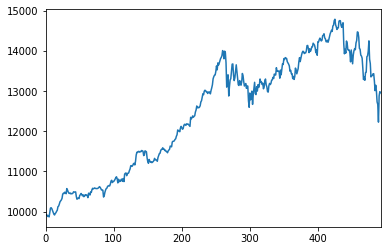

*-----Episode: 709, Reward:129.578321%-----*


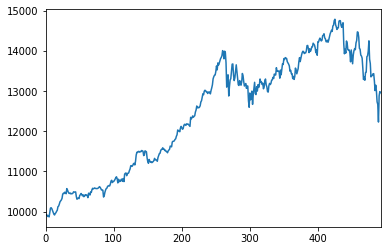

*-----Episode: 710, Reward:129.622836%-----*


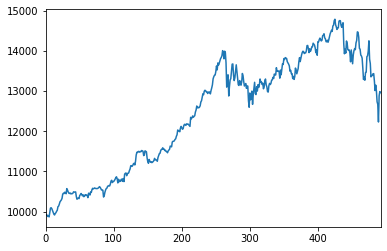

*-----Episode: 711, Reward:129.651640%-----*


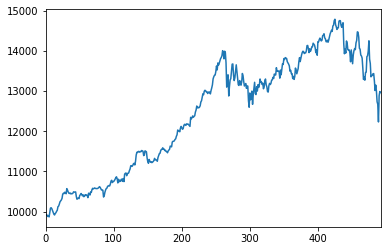

*-----Episode: 712, Reward:129.692099%-----*


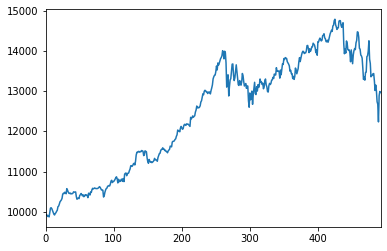

*-----Episode: 713, Reward:129.726602%-----*


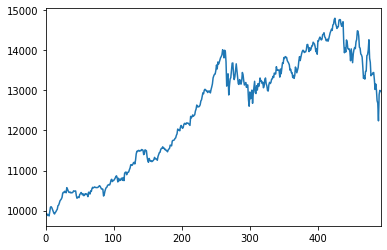

*-----Episode: 714, Reward:129.764435%-----*


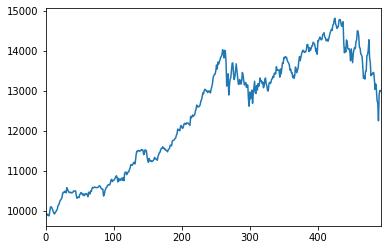

*-----Episode: 715, Reward:129.796305%-----*


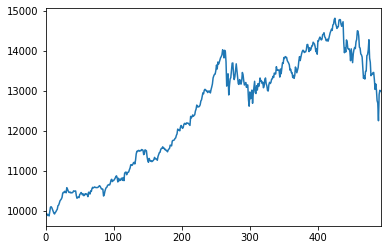

*-----Episode: 716, Reward:129.834603%-----*


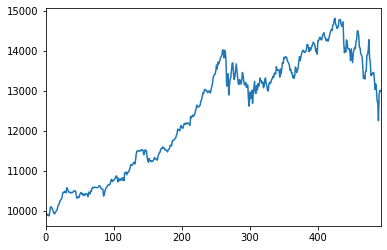

*-----Episode: 717, Reward:129.865983%-----*


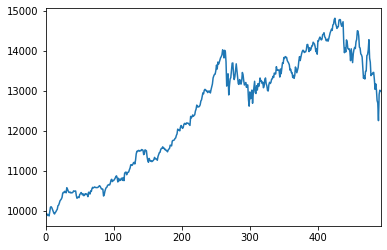

*-----Episode: 718, Reward:129.901410%-----*


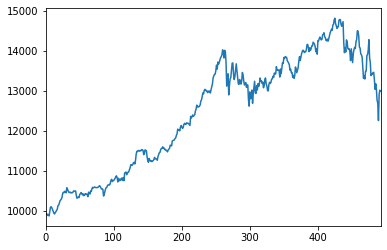

*-----Episode: 719, Reward:129.935637%-----*


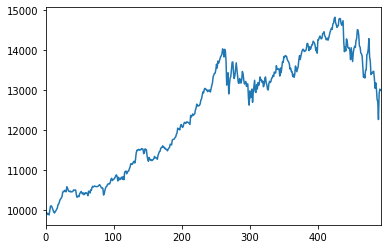

*-----Episode: 720, Reward:129.974870%-----*


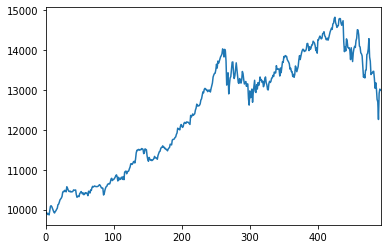

*-----Episode: 721, Reward:130.007415%-----*


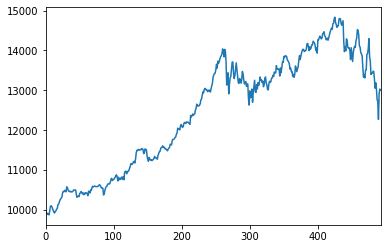

*-----Episode: 722, Reward:130.048306%-----*


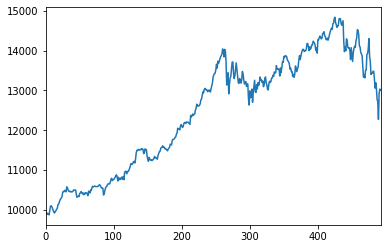

*-----Episode: 723, Reward:130.078211%-----*


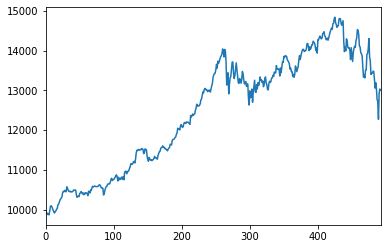

*-----Episode: 724, Reward:130.112408%-----*


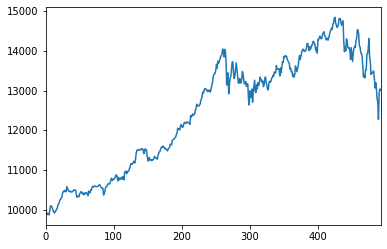

*-----Episode: 725, Reward:130.150182%-----*


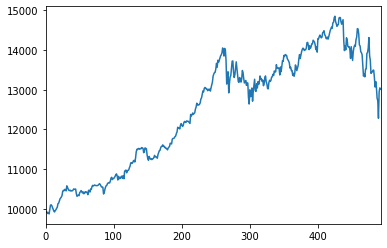

*-----Episode: 726, Reward:130.186758%-----*


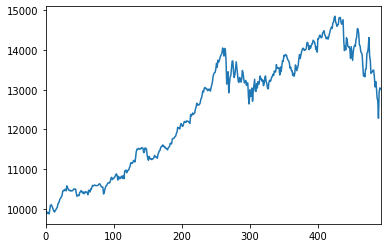

*-----Episode: 727, Reward:130.222851%-----*


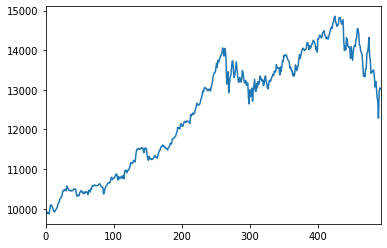

*-----Episode: 728, Reward:130.255592%-----*


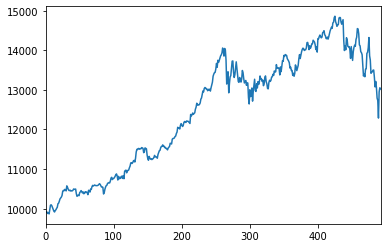

*-----Episode: 729, Reward:130.289522%-----*


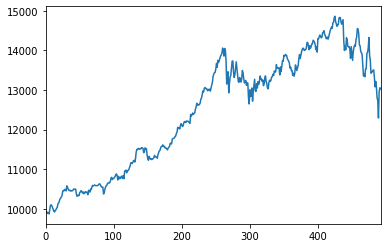

*-----Episode: 730, Reward:130.325360%-----*


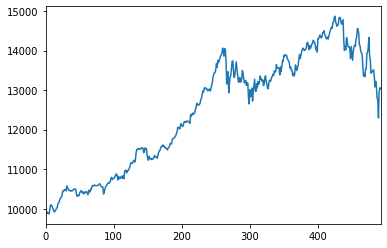

*-----Episode: 731, Reward:130.364063%-----*


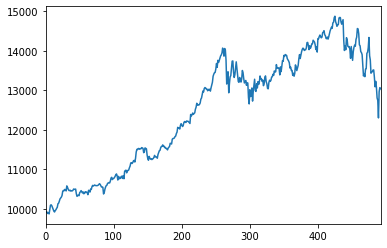

*-----Episode: 732, Reward:130.401328%-----*


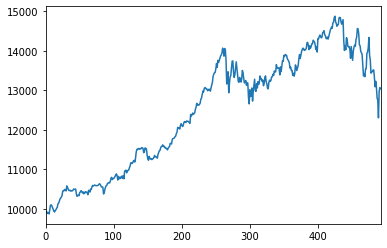

*-----Episode: 733, Reward:130.429491%-----*


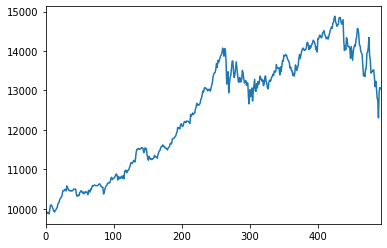

*-----Episode: 734, Reward:130.469138%-----*


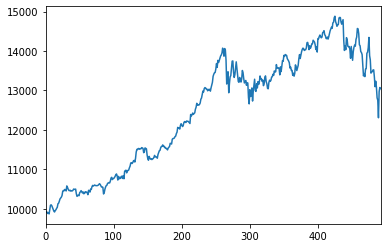

*-----Episode: 735, Reward:130.501837%-----*


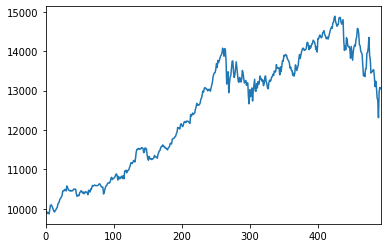

*-----Episode: 736, Reward:130.539800%-----*


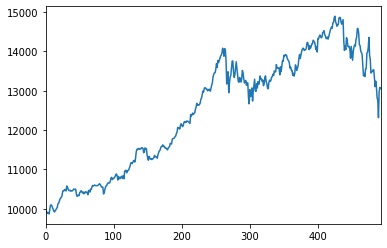

*-----Episode: 737, Reward:130.577519%-----*


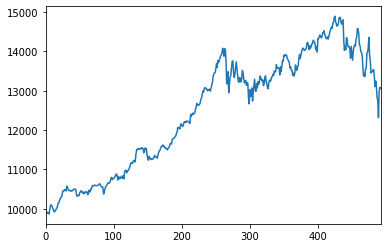

*-----Episode: 738, Reward:130.606844%-----*


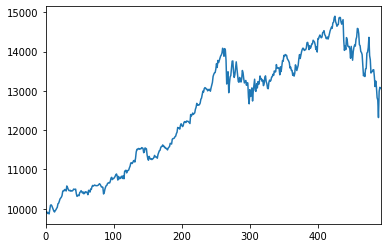

*-----Episode: 739, Reward:130.647187%-----*


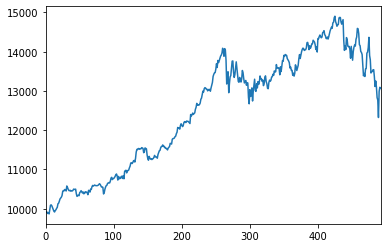

*-----Episode: 740, Reward:130.682485%-----*


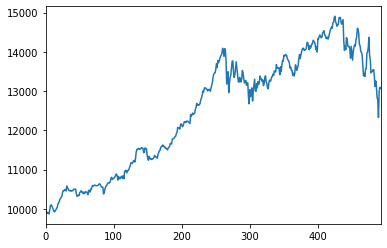

*-----Episode: 741, Reward:130.709861%-----*


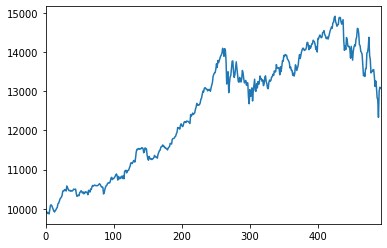

*-----Episode: 742, Reward:130.755702%-----*


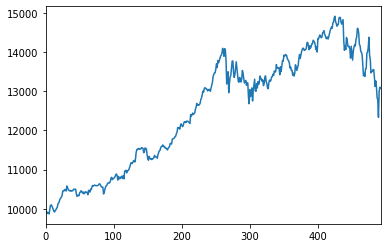

*-----Episode: 743, Reward:130.790024%-----*


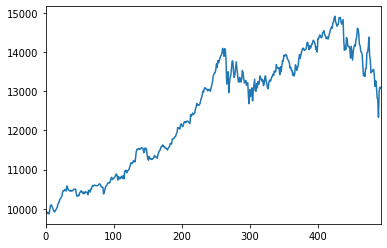

*-----Episode: 744, Reward:130.819778%-----*


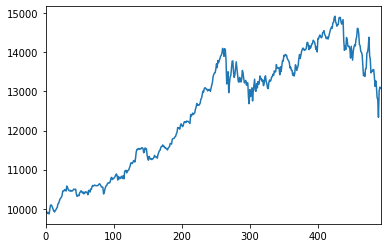

*-----Episode: 745, Reward:130.856485%-----*


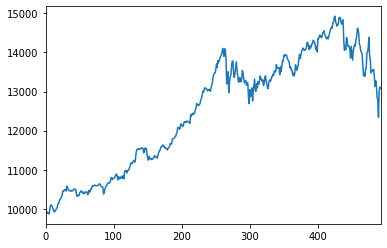

*-----Episode: 746, Reward:130.895350%-----*


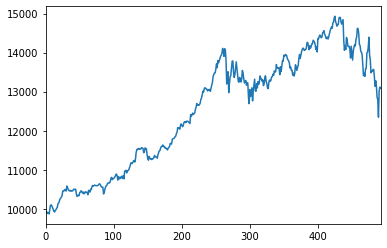

*-----Episode: 747, Reward:130.928446%-----*


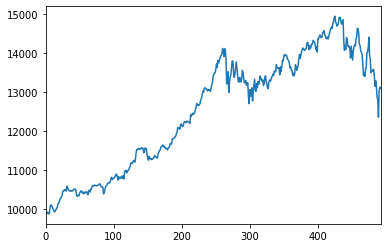

*-----Episode: 748, Reward:130.964179%-----*


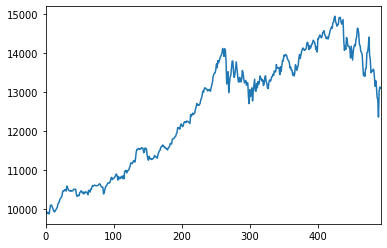

*-----Episode: 749, Reward:131.001587%-----*


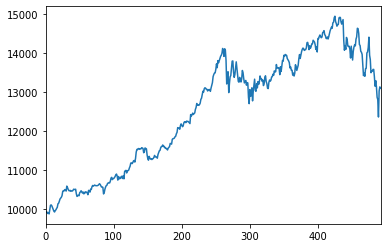

*-----Episode: 750, Reward:131.032979%-----*


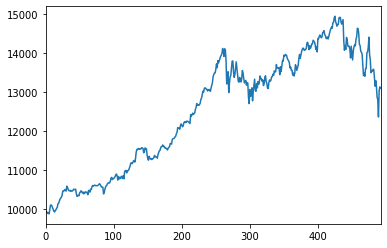

*-----Episode: 751, Reward:131.071097%-----*


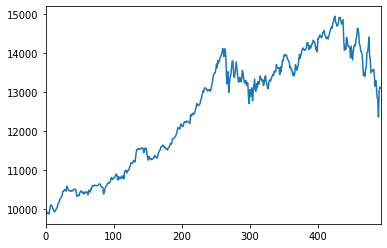

*-----Episode: 752, Reward:131.101033%-----*


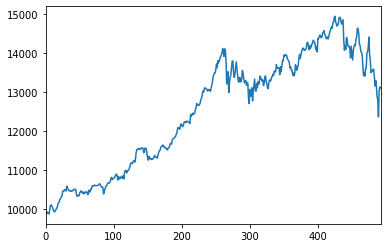

*-----Episode: 753, Reward:131.137455%-----*


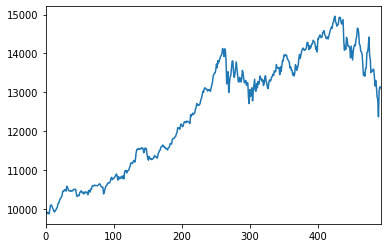

*-----Episode: 754, Reward:131.172189%-----*


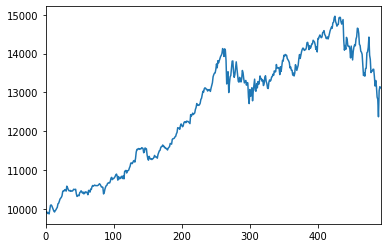

*-----Episode: 755, Reward:131.208119%-----*


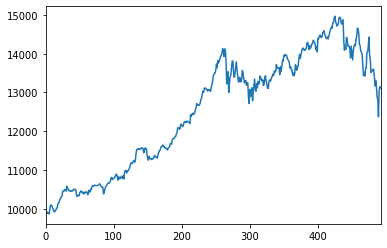

*-----Episode: 756, Reward:131.248139%-----*


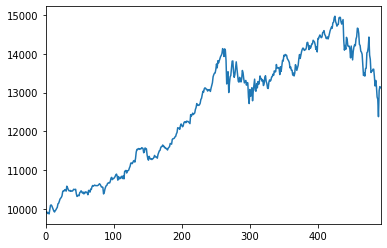

*-----Episode: 757, Reward:131.281408%-----*


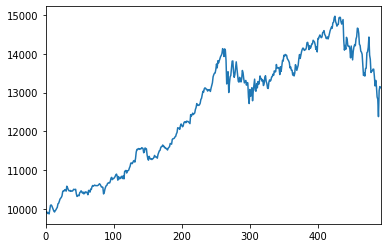

*-----Episode: 758, Reward:131.316358%-----*


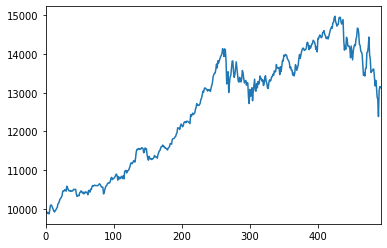

*-----Episode: 759, Reward:131.353470%-----*


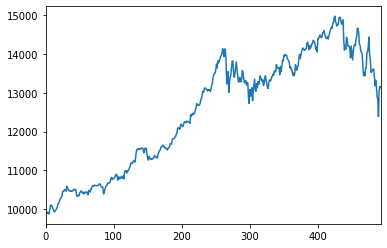

*-----Episode: 760, Reward:131.387203%-----*


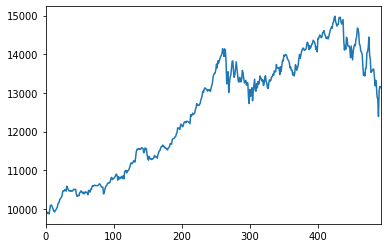

*-----Episode: 761, Reward:131.415138%-----*


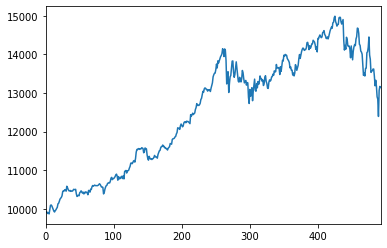

*-----Episode: 762, Reward:131.454162%-----*


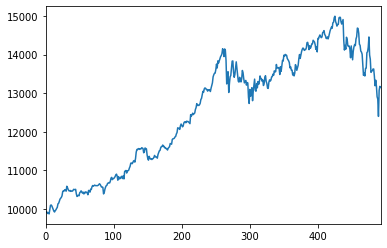

*-----Episode: 763, Reward:131.491973%-----*


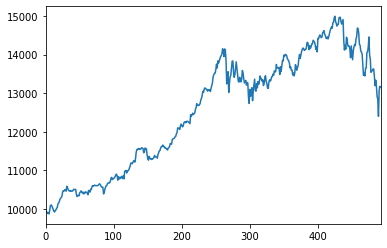

*-----Episode: 764, Reward:131.530023%-----*


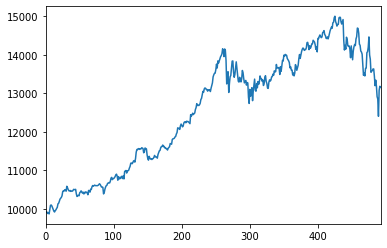

*-----Episode: 765, Reward:131.563239%-----*


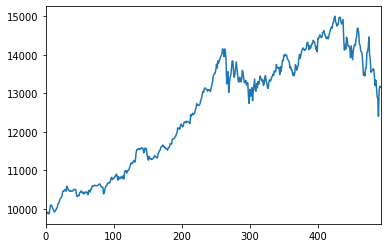

*-----Episode: 766, Reward:131.596445%-----*


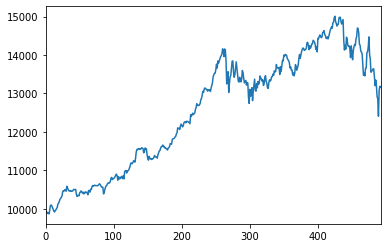

*-----Episode: 767, Reward:131.630853%-----*


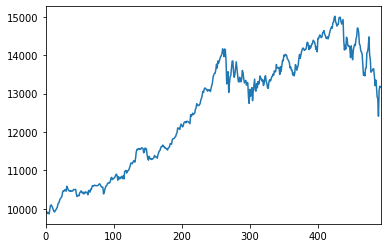

*-----Episode: 768, Reward:131.667911%-----*


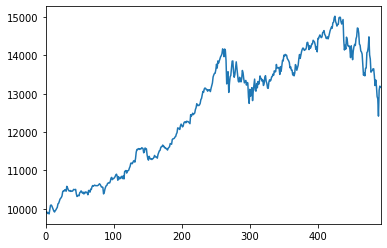

*-----Episode: 769, Reward:131.705690%-----*


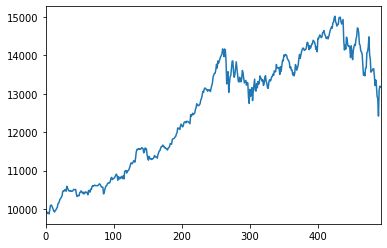

*-----Episode: 770, Reward:131.741045%-----*


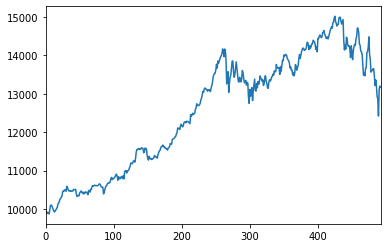

*-----Episode: 771, Reward:131.772524%-----*


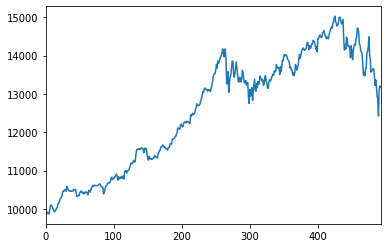

*-----Episode: 772, Reward:131.807141%-----*


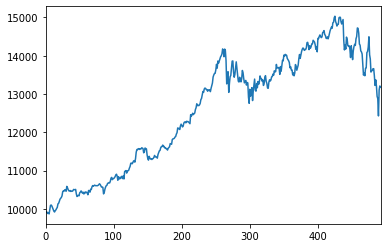

*-----Episode: 773, Reward:131.847677%-----*


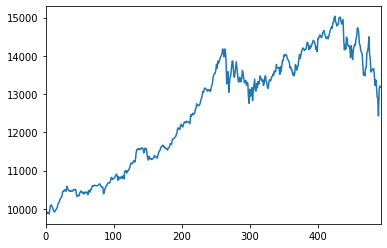

*-----Episode: 774, Reward:131.876713%-----*


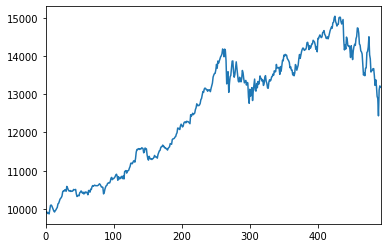

*-----Episode: 775, Reward:131.914696%-----*


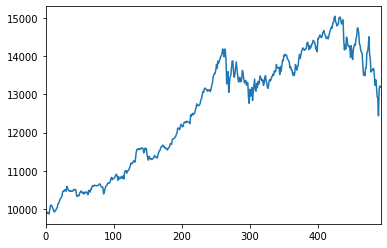

*-----Episode: 776, Reward:131.949406%-----*


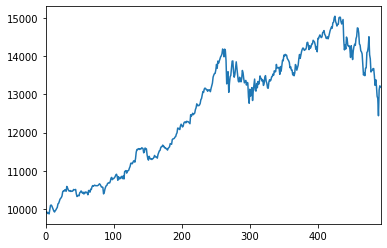

*-----Episode: 777, Reward:131.984591%-----*


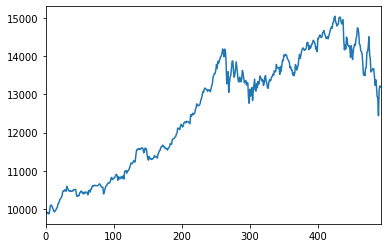

*-----Episode: 778, Reward:132.013344%-----*


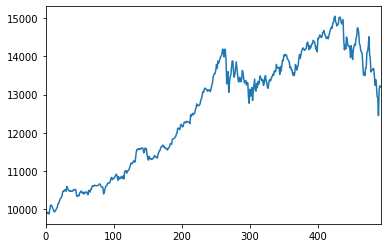

*-----Episode: 779, Reward:132.050206%-----*


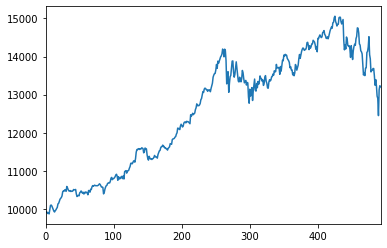

*-----Episode: 780, Reward:132.083426%-----*


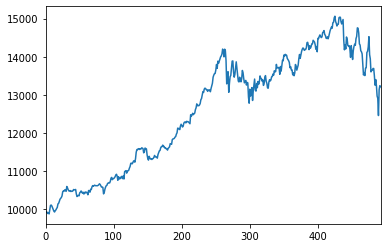

*-----Episode: 781, Reward:132.129491%-----*


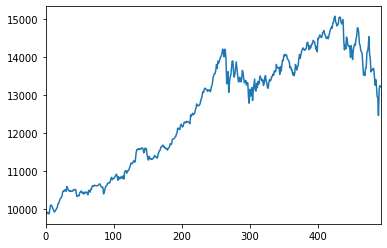

*-----Episode: 782, Reward:132.163066%-----*


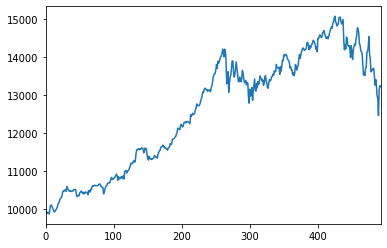

*-----Episode: 783, Reward:132.188868%-----*


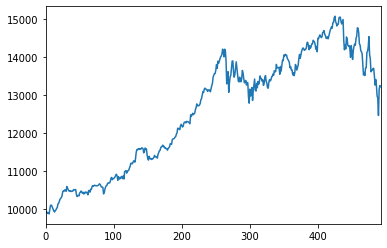

*-----Episode: 784, Reward:132.227034%-----*


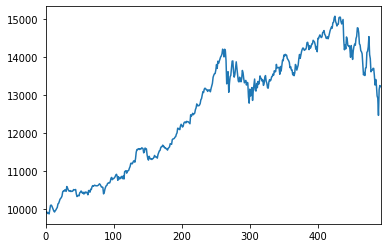

*-----Episode: 785, Reward:132.258763%-----*


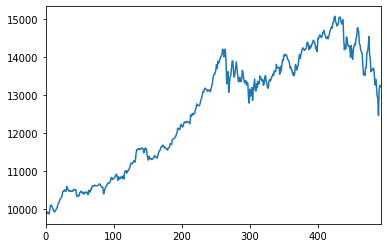

*-----Episode: 786, Reward:132.295463%-----*


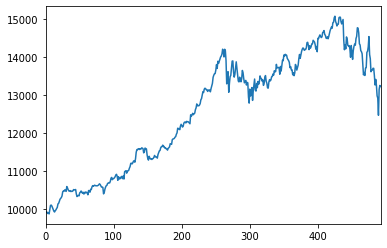

*-----Episode: 787, Reward:132.334828%-----*


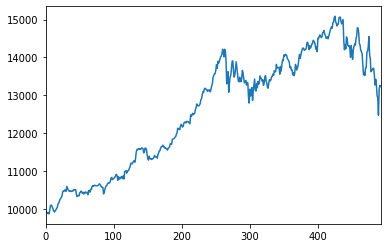

*-----Episode: 788, Reward:132.368479%-----*


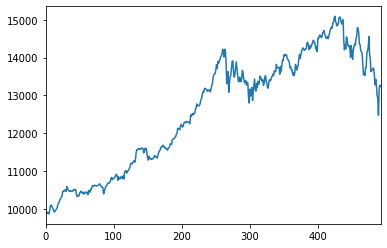

*-----Episode: 789, Reward:132.403214%-----*


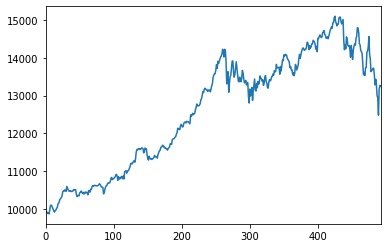

*-----Episode: 790, Reward:132.438179%-----*


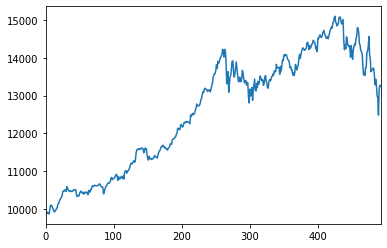

*-----Episode: 791, Reward:132.470097%-----*


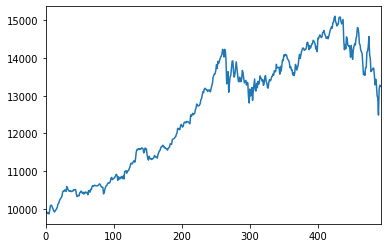

*-----Episode: 792, Reward:132.509668%-----*


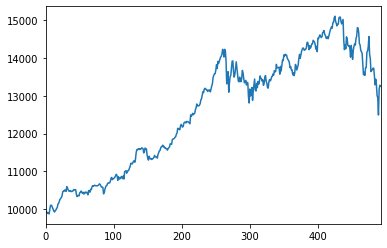

*-----Episode: 793, Reward:132.547407%-----*


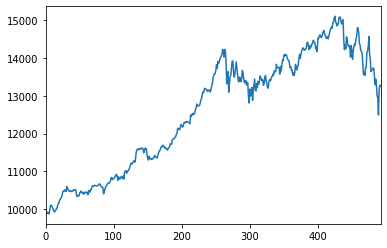

*-----Episode: 794, Reward:132.578324%-----*


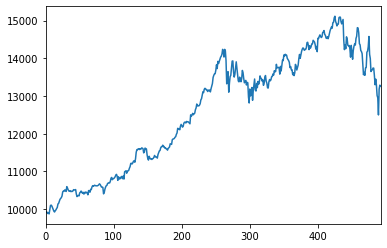

*-----Episode: 795, Reward:132.613000%-----*


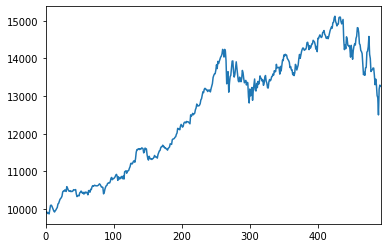

*-----Episode: 796, Reward:132.642924%-----*


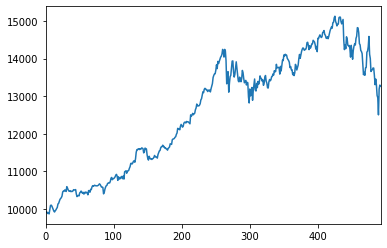

*-----Episode: 797, Reward:132.680506%-----*


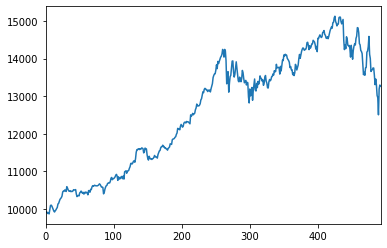

*-----Episode: 798, Reward:132.718692%-----*


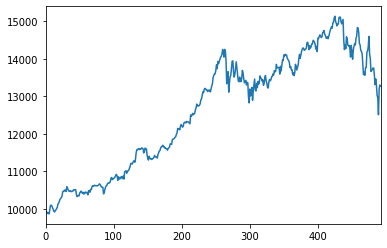

*-----Episode: 799, Reward:132.749562%-----*


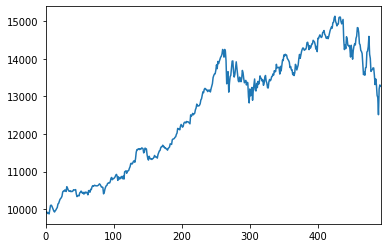

*-----Episode: 800, Reward:132.794067%-----*


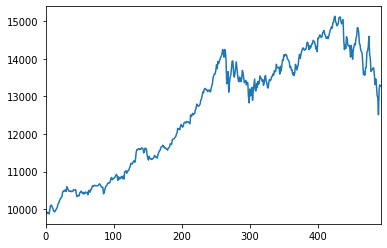

*-----Episode: 801, Reward:132.816749%-----*


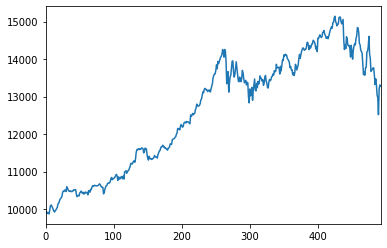

*-----Episode: 802, Reward:132.853559%-----*


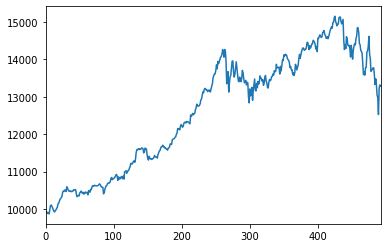

*-----Episode: 803, Reward:132.892800%-----*


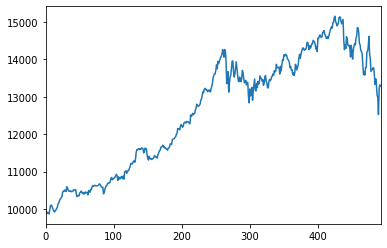

*-----Episode: 804, Reward:132.920446%-----*


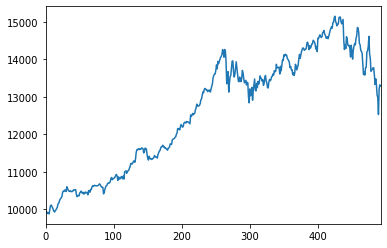

*-----Episode: 805, Reward:132.959061%-----*


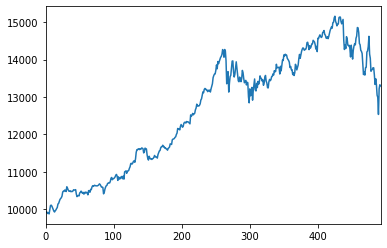

*-----Episode: 806, Reward:132.992301%-----*


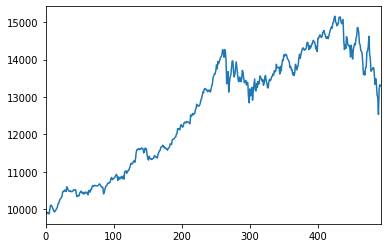

*-----Episode: 807, Reward:133.026509%-----*


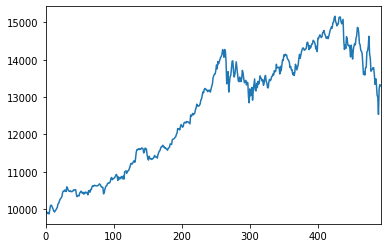

*-----Episode: 808, Reward:133.065348%-----*


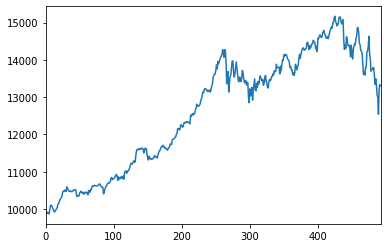

*-----Episode: 809, Reward:133.105157%-----*


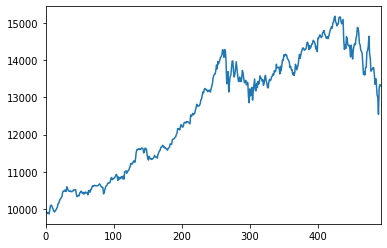

*-----Episode: 810, Reward:133.133598%-----*


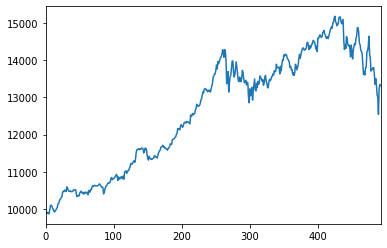

*-----Episode: 811, Reward:133.171071%-----*


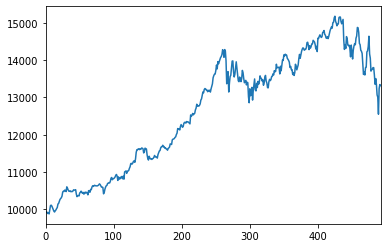

*-----Episode: 812, Reward:133.205237%-----*


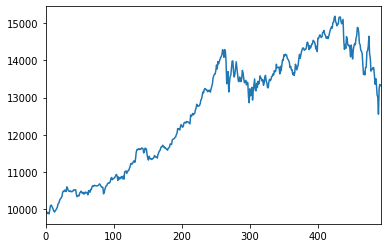

*-----Episode: 813, Reward:133.235603%-----*


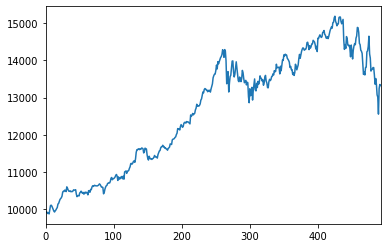

*-----Episode: 814, Reward:133.273297%-----*


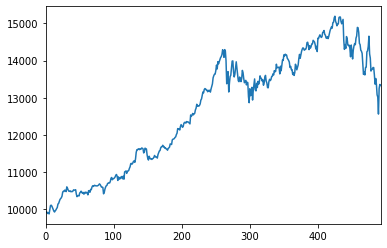

*-----Episode: 815, Reward:133.308049%-----*


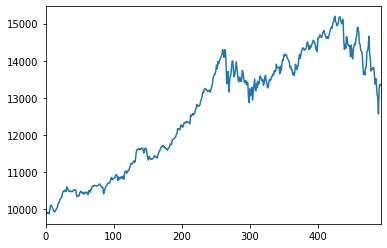

*-----Episode: 816, Reward:133.345115%-----*


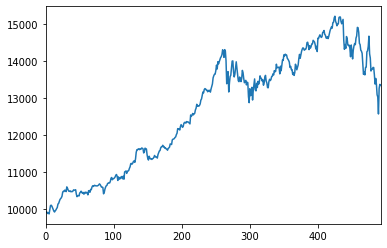

*-----Episode: 817, Reward:133.381198%-----*


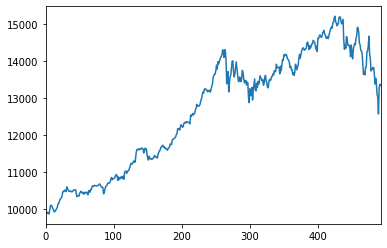

*-----Episode: 818, Reward:133.415556%-----*


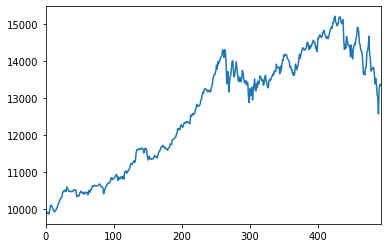

*-----Episode: 819, Reward:133.448560%-----*


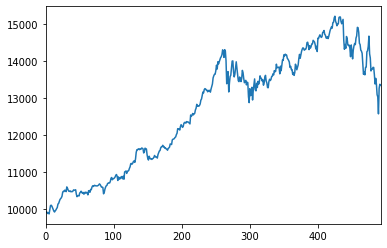

*-----Episode: 820, Reward:133.480943%-----*


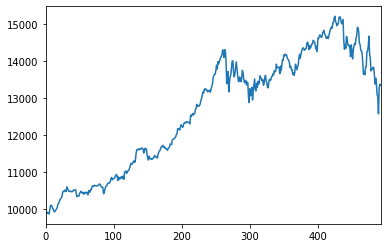

*-----Episode: 821, Reward:133.519073%-----*


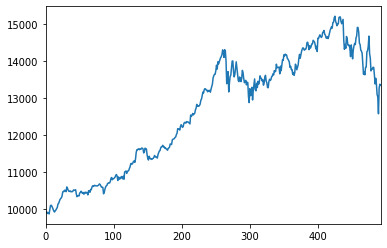

*-----Episode: 822, Reward:133.554380%-----*


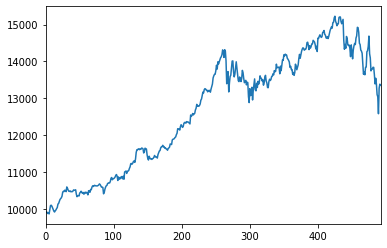

*-----Episode: 823, Reward:133.584283%-----*


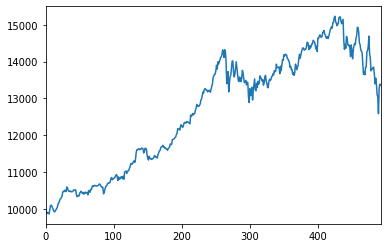

*-----Episode: 824, Reward:133.626928%-----*


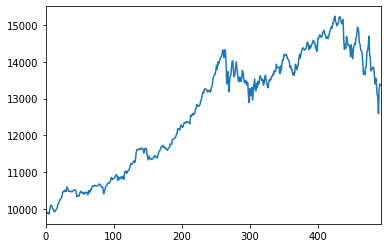

*-----Episode: 825, Reward:133.660246%-----*


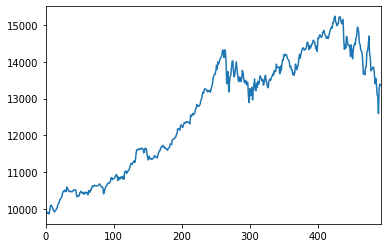

*-----Episode: 826, Reward:133.698219%-----*


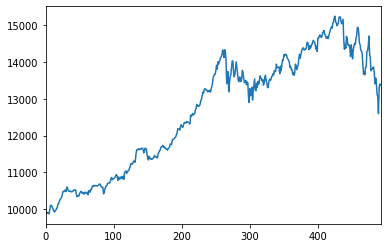

*-----Episode: 827, Reward:133.728082%-----*


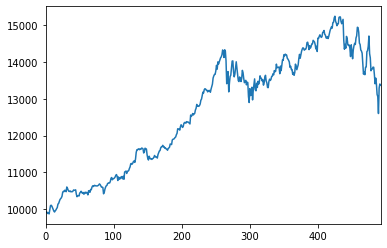

*-----Episode: 828, Reward:133.754624%-----*


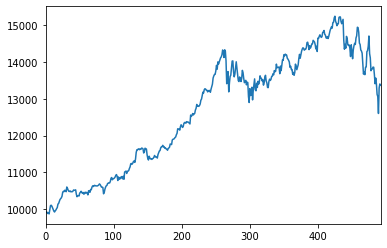

*-----Episode: 829, Reward:133.794163%-----*


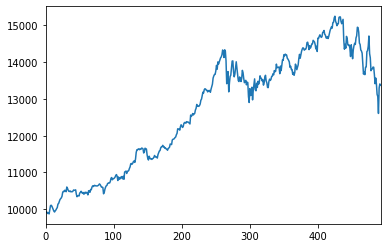

*-----Episode: 830, Reward:133.823261%-----*


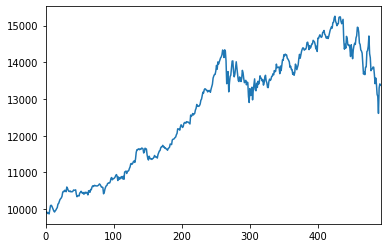

*-----Episode: 831, Reward:133.862175%-----*


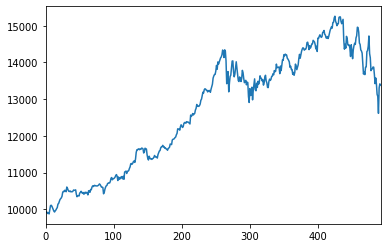

*-----Episode: 832, Reward:133.896903%-----*


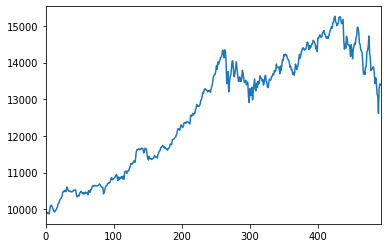

*-----Episode: 833, Reward:133.930516%-----*


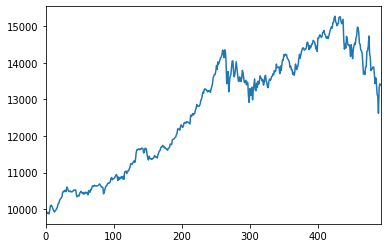

*-----Episode: 834, Reward:133.969899%-----*


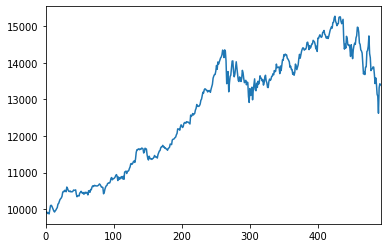

*-----Episode: 835, Reward:134.001032%-----*


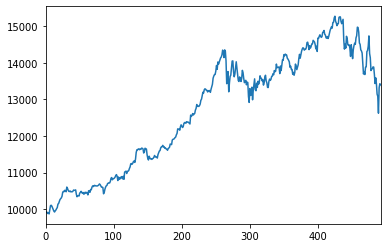

*-----Episode: 836, Reward:134.039039%-----*


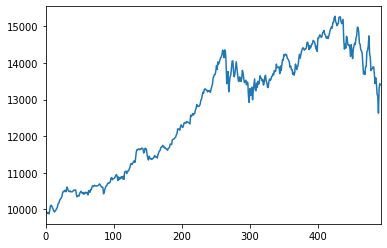

*-----Episode: 837, Reward:134.069781%-----*


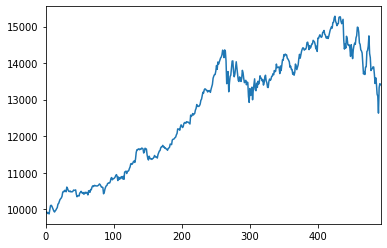

*-----Episode: 838, Reward:134.103340%-----*


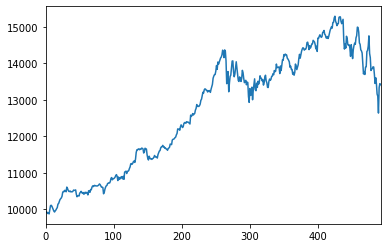

*-----Episode: 839, Reward:134.139970%-----*


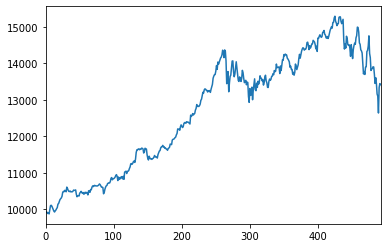

*-----Episode: 840, Reward:134.179421%-----*


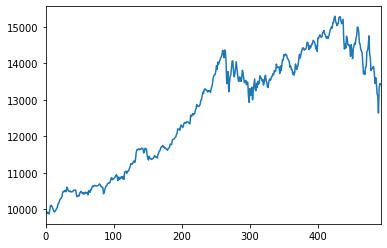

*-----Episode: 841, Reward:134.211108%-----*


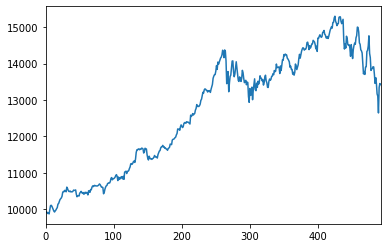

*-----Episode: 842, Reward:134.245000%-----*


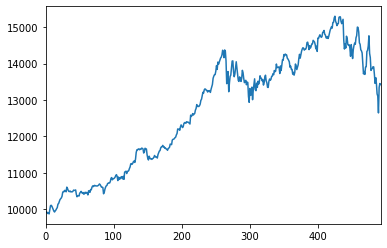

*-----Episode: 843, Reward:134.273954%-----*


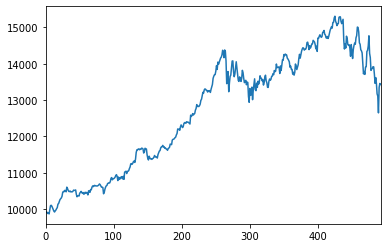

*-----Episode: 844, Reward:134.313002%-----*


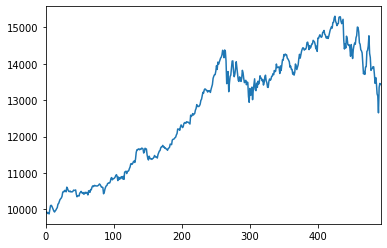

*-----Episode: 845, Reward:134.342921%-----*


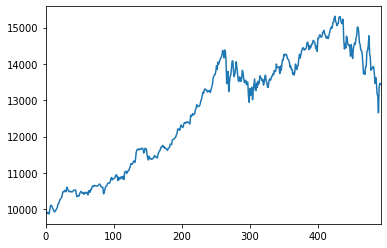

*-----Episode: 846, Reward:134.382445%-----*


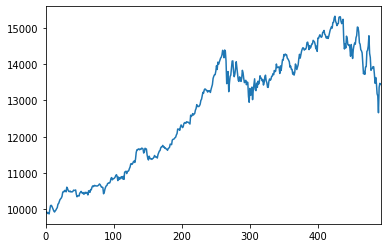

*-----Episode: 847, Reward:134.416903%-----*


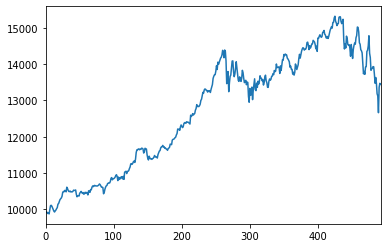

*-----Episode: 848, Reward:134.447032%-----*


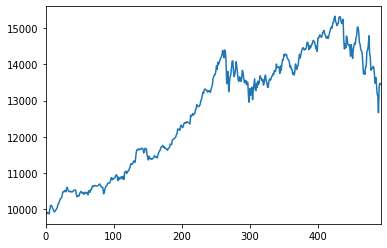

*-----Episode: 849, Reward:134.482456%-----*


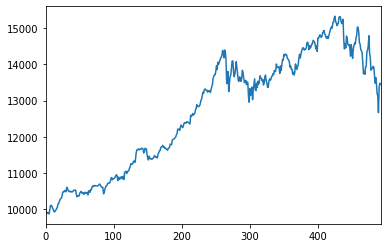

*-----Episode: 850, Reward:134.528611%-----*


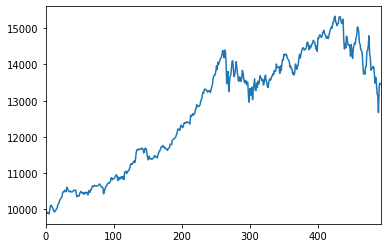

*-----Episode: 851, Reward:134.551302%-----*


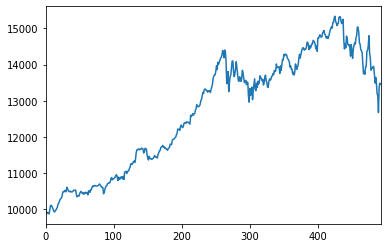

*-----Episode: 852, Reward:134.591639%-----*


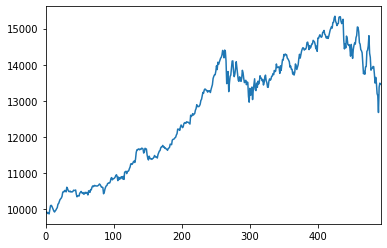

*-----Episode: 853, Reward:134.621220%-----*


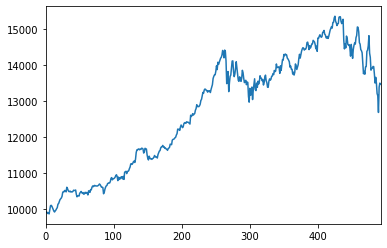

*-----Episode: 854, Reward:134.660056%-----*


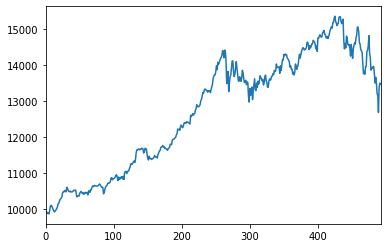

*-----Episode: 855, Reward:134.690854%-----*


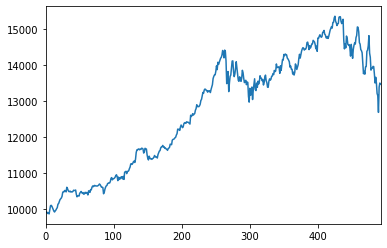

*-----Episode: 856, Reward:134.726212%-----*


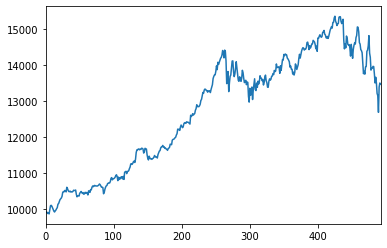

*-----Episode: 857, Reward:134.760201%-----*


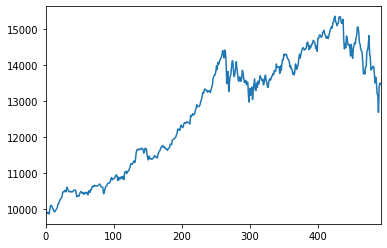

*-----Episode: 858, Reward:134.798632%-----*


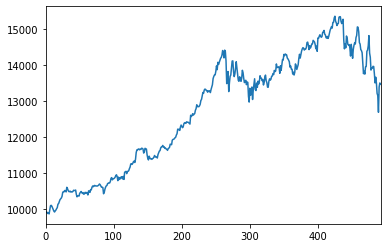

*-----Episode: 859, Reward:134.823200%-----*


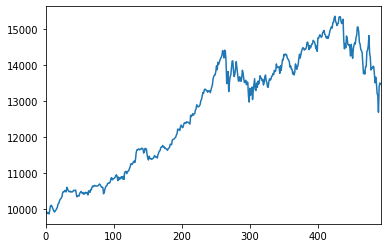

*-----Episode: 860, Reward:134.864582%-----*


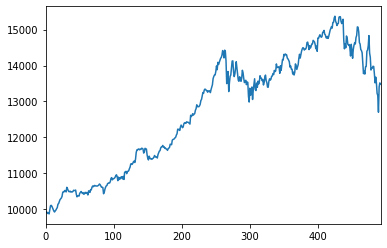

*-----Episode: 861, Reward:134.897542%-----*


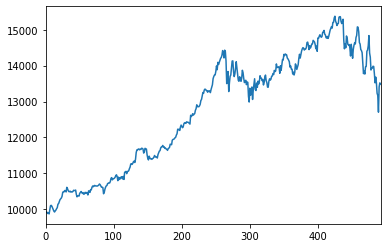

*-----Episode: 862, Reward:134.927893%-----*


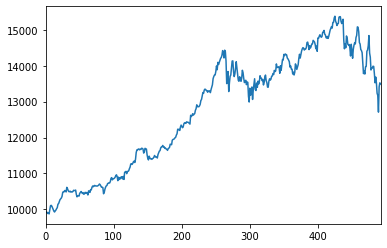

*-----Episode: 863, Reward:134.966652%-----*


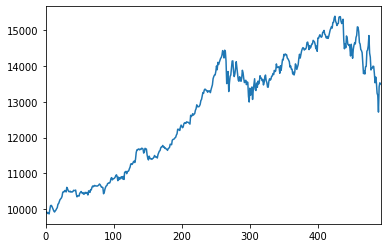

*-----Episode: 864, Reward:134.996485%-----*


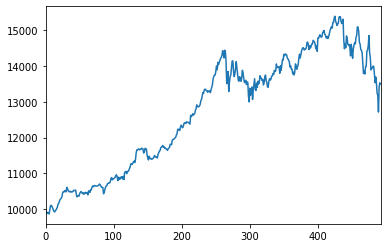

*-----Episode: 865, Reward:135.033245%-----*


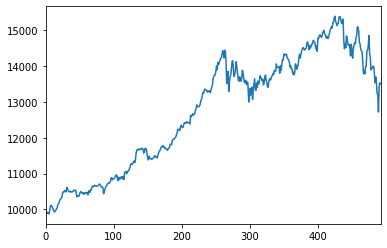

*-----Episode: 866, Reward:135.064913%-----*


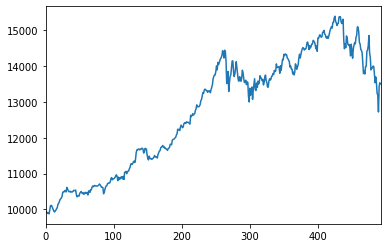

*-----Episode: 867, Reward:135.102151%-----*


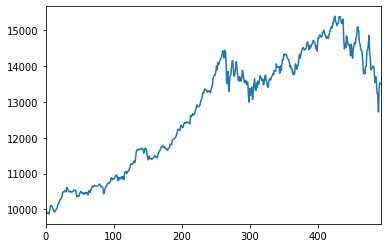

*-----Episode: 868, Reward:135.139255%-----*


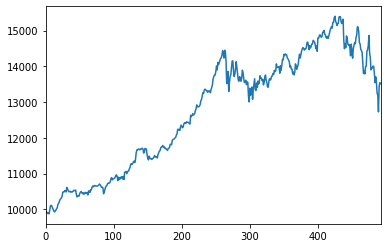

*-----Episode: 869, Reward:135.175856%-----*


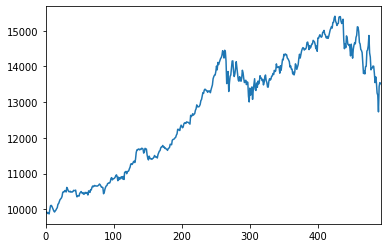

*-----Episode: 870, Reward:135.206119%-----*


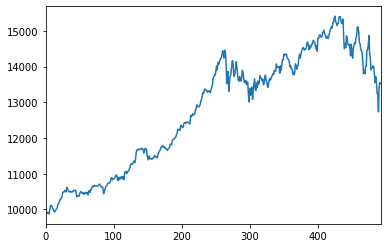

*-----Episode: 871, Reward:135.241956%-----*


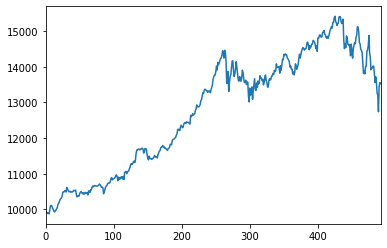

*-----Episode: 872, Reward:135.277039%-----*


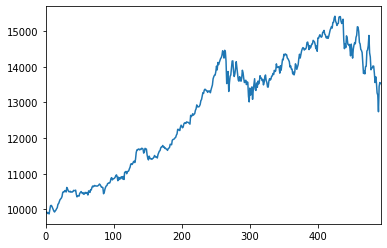

*-----Episode: 873, Reward:135.310747%-----*


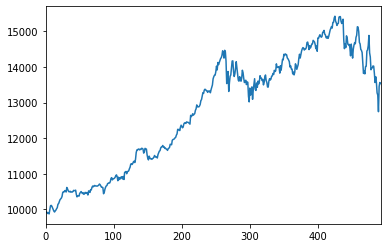

*-----Episode: 874, Reward:135.343823%-----*


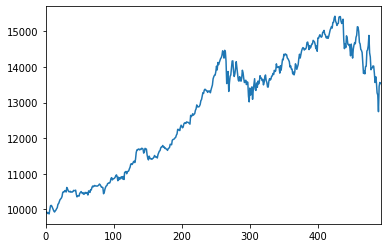

*-----Episode: 875, Reward:135.373906%-----*


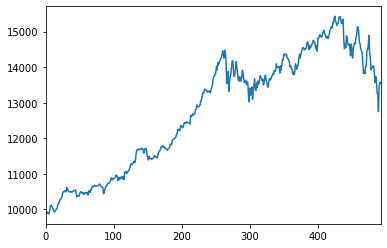

*-----Episode: 876, Reward:135.415783%-----*


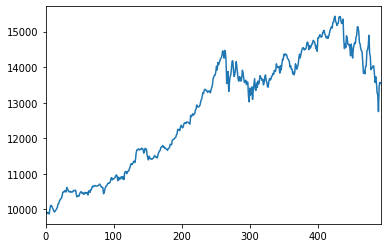

*-----Episode: 877, Reward:135.447089%-----*


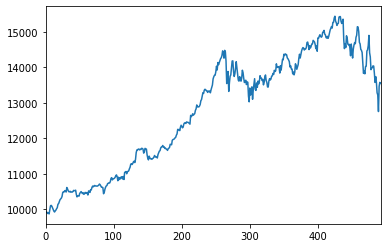

*-----Episode: 878, Reward:135.475767%-----*


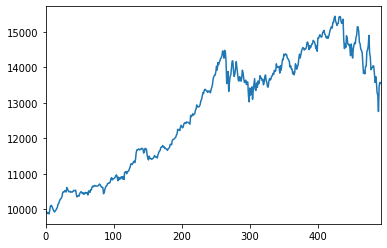

*-----Episode: 879, Reward:135.512890%-----*


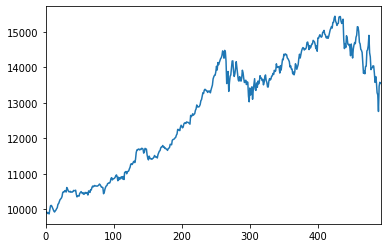

*-----Episode: 880, Reward:135.550003%-----*


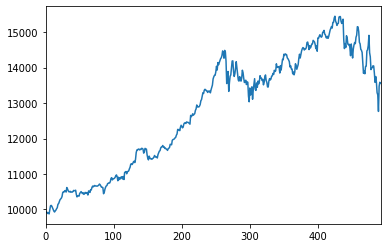

*-----Episode: 881, Reward:135.587732%-----*


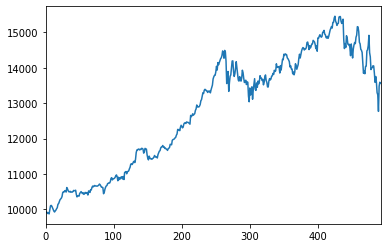

*-----Episode: 882, Reward:135.626940%-----*


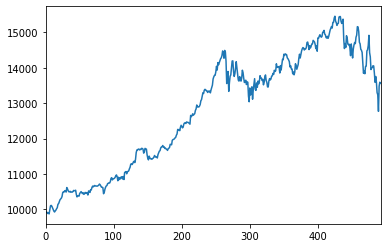

*-----Episode: 883, Reward:135.654935%-----*


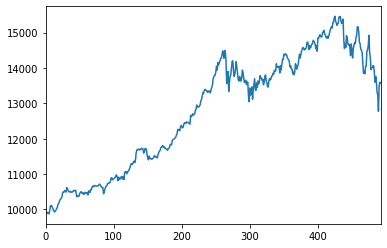

*-----Episode: 884, Reward:135.689269%-----*


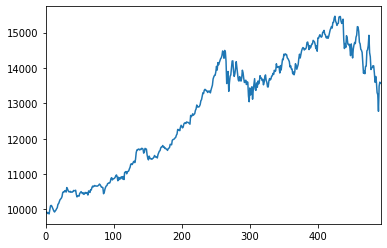

*-----Episode: 885, Reward:135.716491%-----*


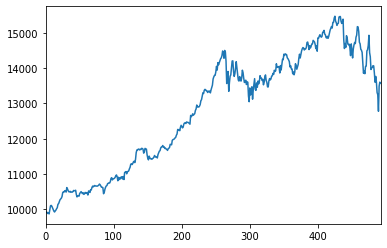

*-----Episode: 886, Reward:135.747187%-----*


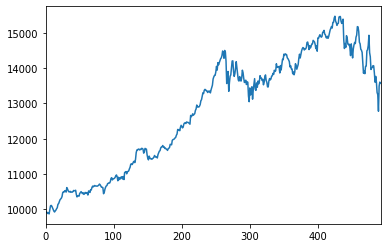

*-----Episode: 887, Reward:135.785100%-----*


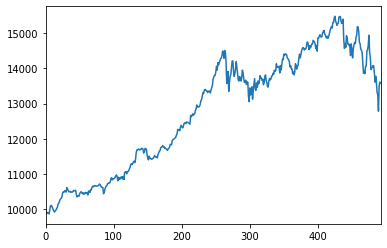

*-----Episode: 888, Reward:135.817395%-----*


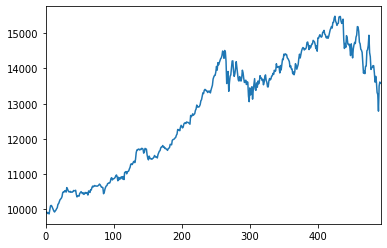

*-----Episode: 889, Reward:135.860150%-----*


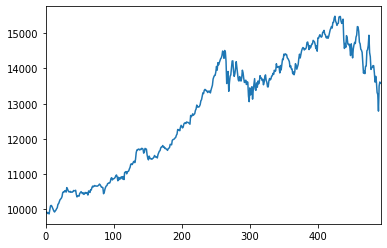

*-----Episode: 890, Reward:135.888810%-----*


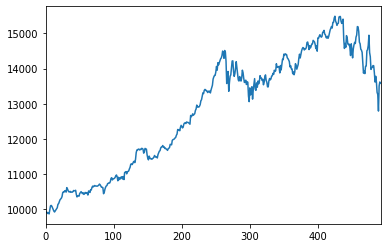

*-----Episode: 891, Reward:135.926687%-----*


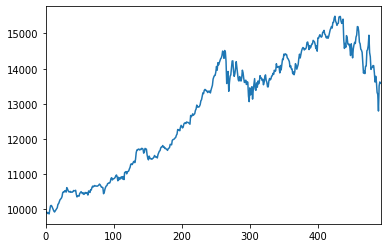

*-----Episode: 892, Reward:135.953449%-----*


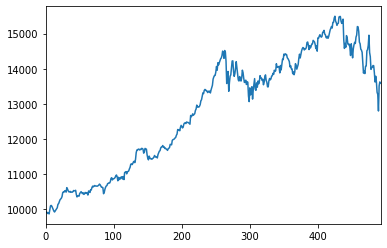

*-----Episode: 893, Reward:135.993801%-----*


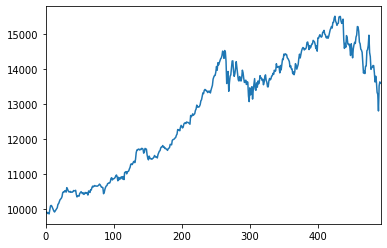

*-----Episode: 894, Reward:136.027155%-----*


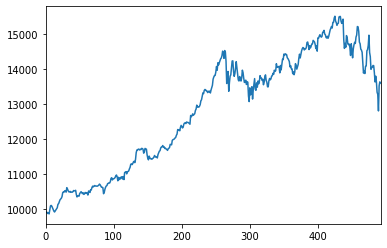

*-----Episode: 895, Reward:136.063121%-----*


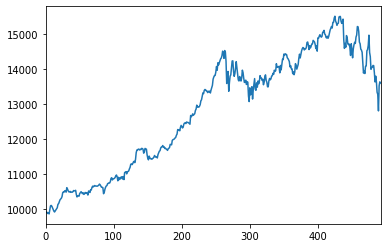

*-----Episode: 896, Reward:136.090833%-----*


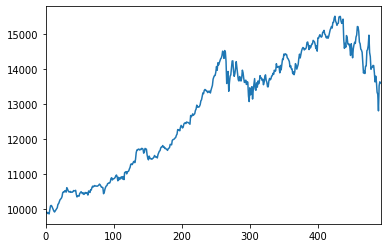

*-----Episode: 897, Reward:136.124153%-----*


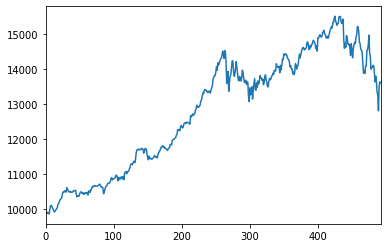

*-----Episode: 898, Reward:136.162710%-----*


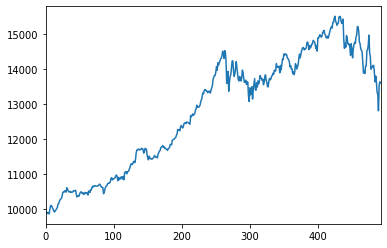

*-----Episode: 899, Reward:136.193509%-----*


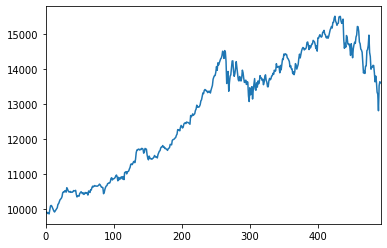

*-----Episode: 900, Reward:136.233049%-----*


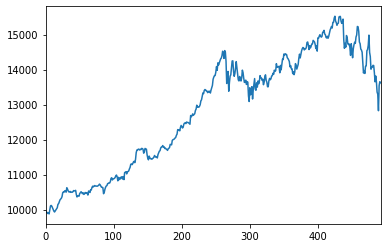

*-----Episode: 901, Reward:136.259326%-----*


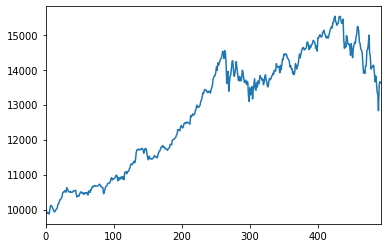

*-----Episode: 902, Reward:136.293344%-----*


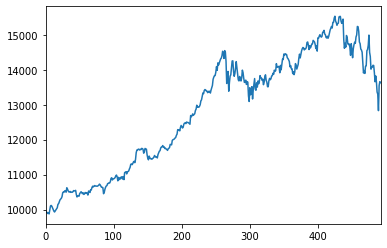

*-----Episode: 903, Reward:136.329979%-----*


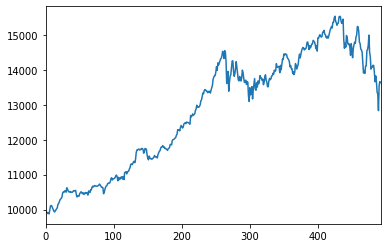

*-----Episode: 904, Reward:136.367231%-----*


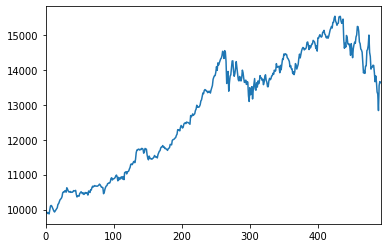

*-----Episode: 905, Reward:136.398716%-----*


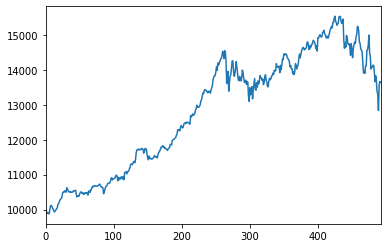

*-----Episode: 906, Reward:136.430315%-----*


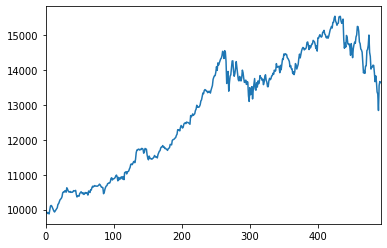

*-----Episode: 907, Reward:136.465408%-----*


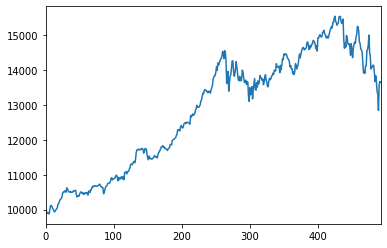

*-----Episode: 908, Reward:136.500742%-----*


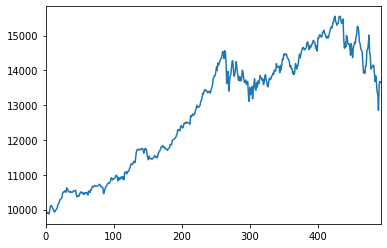

*-----Episode: 909, Reward:136.539825%-----*


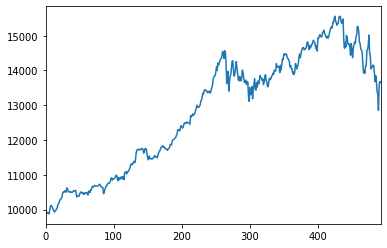

*-----Episode: 910, Reward:136.566867%-----*


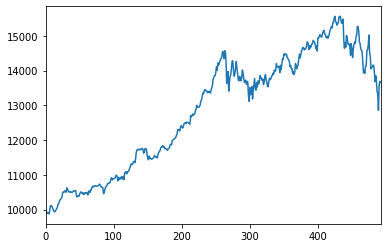

*-----Episode: 911, Reward:136.599410%-----*


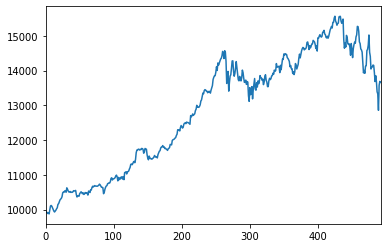

*-----Episode: 912, Reward:136.632820%-----*


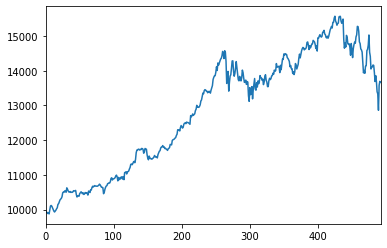

*-----Episode: 913, Reward:136.672236%-----*


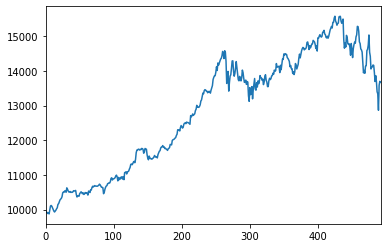

*-----Episode: 914, Reward:136.696464%-----*


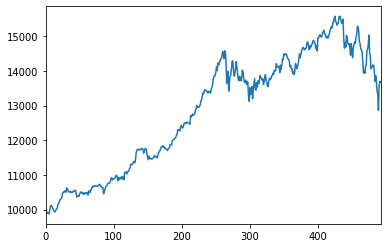

*-----Episode: 915, Reward:136.733844%-----*


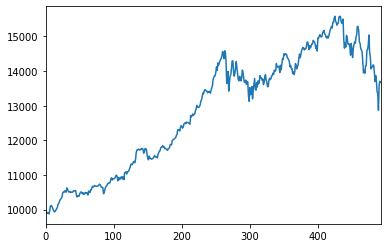

*-----Episode: 916, Reward:136.768707%-----*


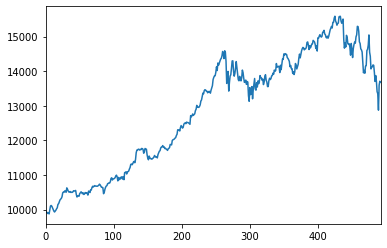

*-----Episode: 917, Reward:136.799163%-----*


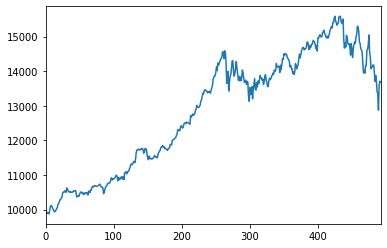

*-----Episode: 918, Reward:136.832869%-----*


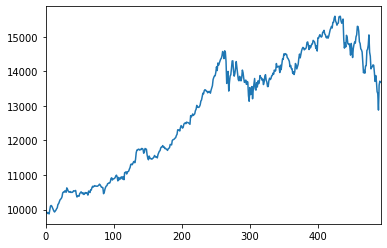

*-----Episode: 919, Reward:136.868074%-----*


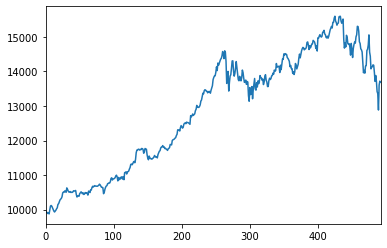

*-----Episode: 920, Reward:136.908416%-----*


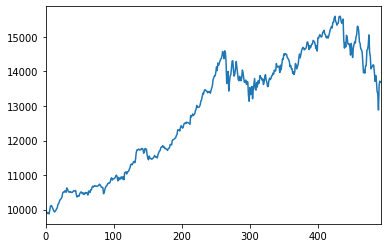

*-----Episode: 921, Reward:136.932167%-----*


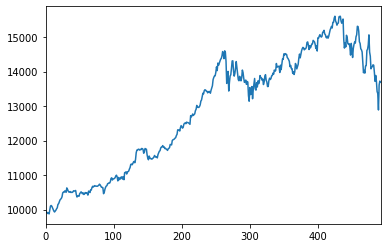

*-----Episode: 922, Reward:136.970348%-----*


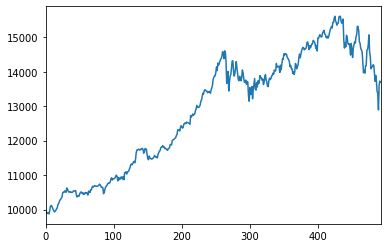

*-----Episode: 923, Reward:137.004623%-----*


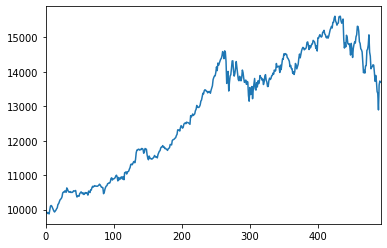

*-----Episode: 924, Reward:137.033104%-----*


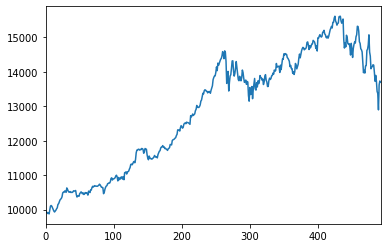

*-----Episode: 925, Reward:137.074779%-----*


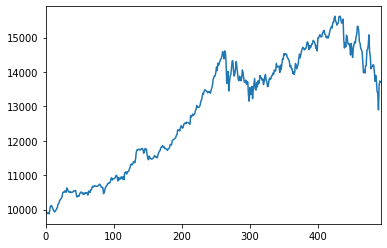

*-----Episode: 926, Reward:137.105879%-----*


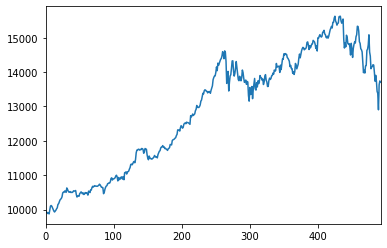

*-----Episode: 927, Reward:137.142377%-----*


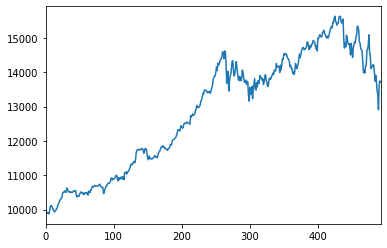

*-----Episode: 928, Reward:137.170936%-----*


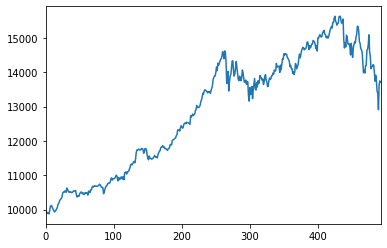

*-----Episode: 929, Reward:137.209050%-----*


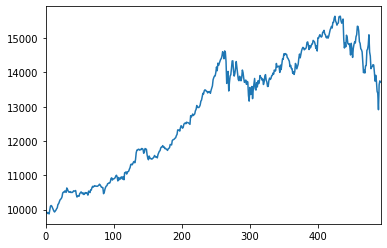

*-----Episode: 930, Reward:137.237079%-----*


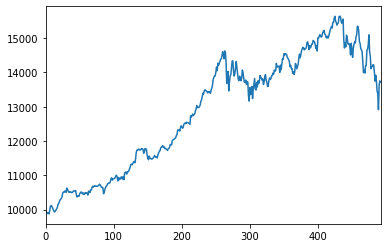

*-----Episode: 931, Reward:137.270891%-----*


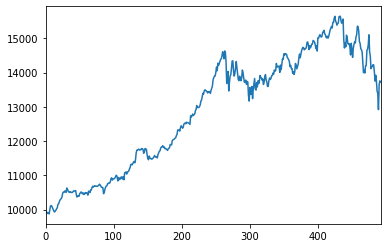

*-----Episode: 932, Reward:137.307967%-----*


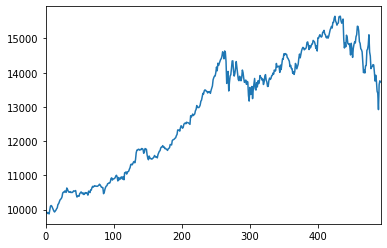

*-----Episode: 933, Reward:137.339616%-----*


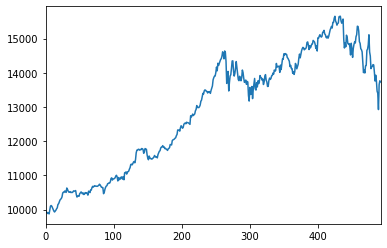

*-----Episode: 934, Reward:137.377933%-----*


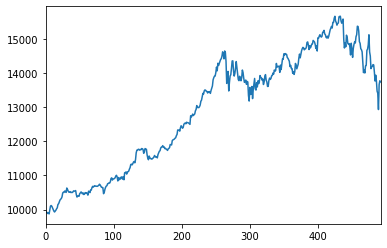

*-----Episode: 935, Reward:137.404517%-----*


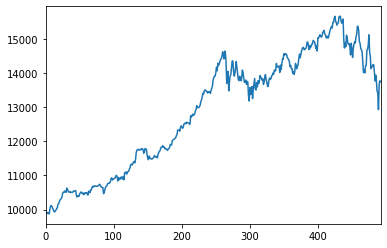

*-----Episode: 936, Reward:137.441427%-----*


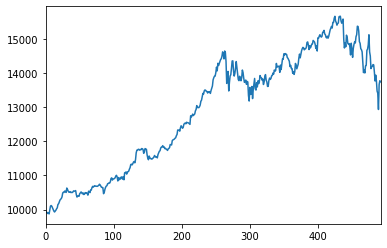

*-----Episode: 937, Reward:137.474544%-----*


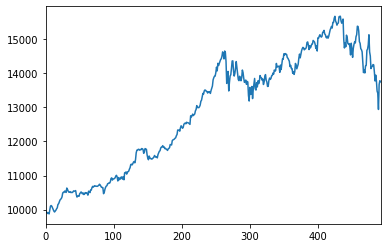

*-----Episode: 938, Reward:137.506767%-----*


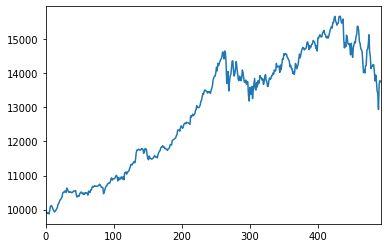

*-----Episode: 939, Reward:137.545543%-----*


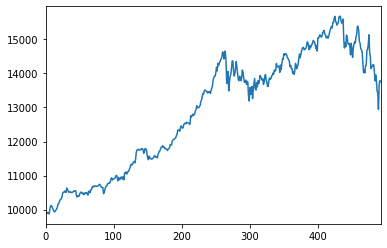

*-----Episode: 940, Reward:137.576988%-----*


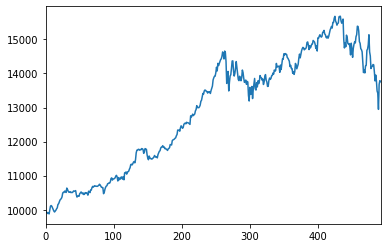

*-----Episode: 941, Reward:137.607032%-----*


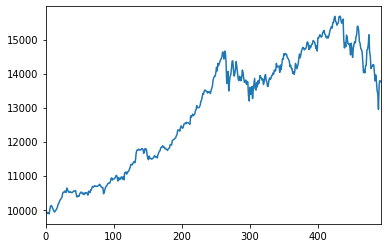

*-----Episode: 942, Reward:137.645273%-----*


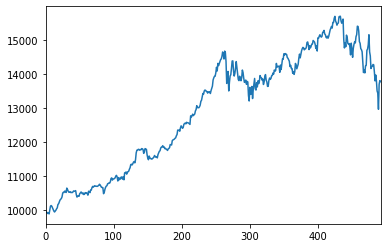

*-----Episode: 943, Reward:137.681484%-----*


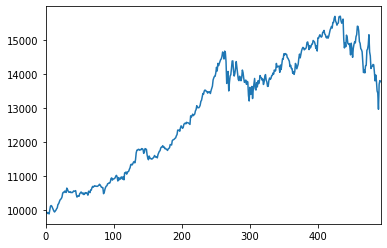

*-----Episode: 944, Reward:137.707956%-----*


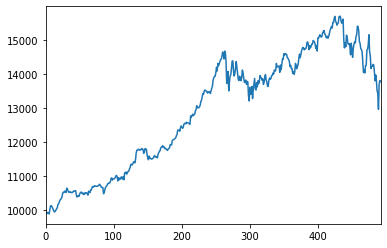

*-----Episode: 945, Reward:137.740985%-----*


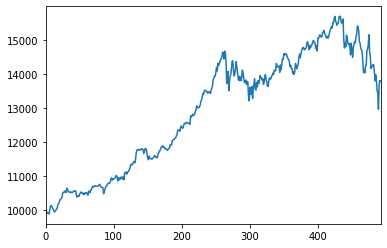

*-----Episode: 946, Reward:137.777795%-----*


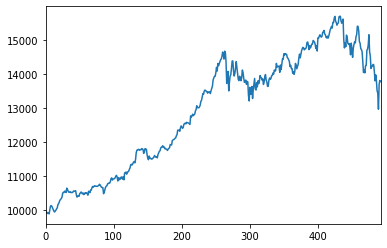

*-----Episode: 947, Reward:137.818011%-----*


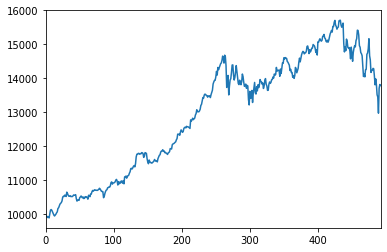

*-----Episode: 948, Reward:137.843420%-----*


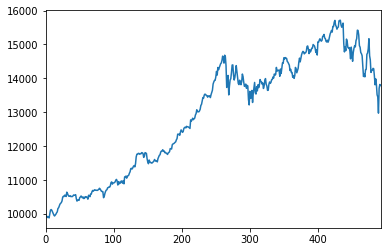

*-----Episode: 949, Reward:137.878809%-----*


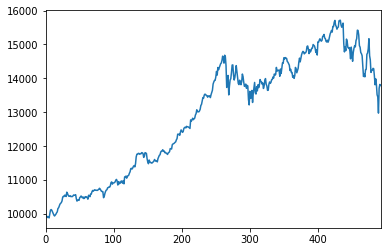

*-----Episode: 950, Reward:137.913302%-----*


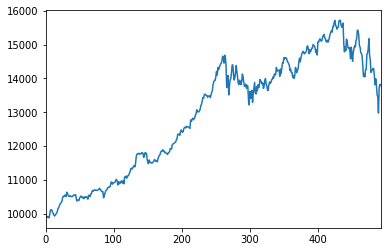

*-----Episode: 951, Reward:137.939810%-----*


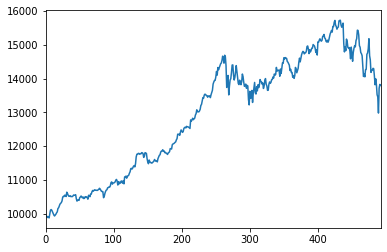

*-----Episode: 952, Reward:137.969974%-----*


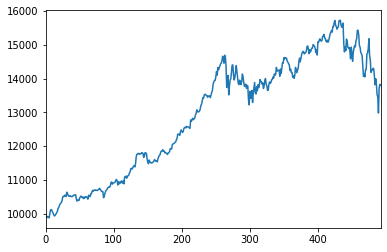

*-----Episode: 953, Reward:138.011525%-----*


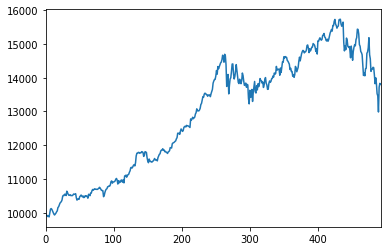

*-----Episode: 954, Reward:138.042682%-----*


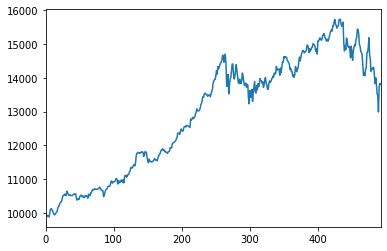

*-----Episode: 955, Reward:138.075092%-----*


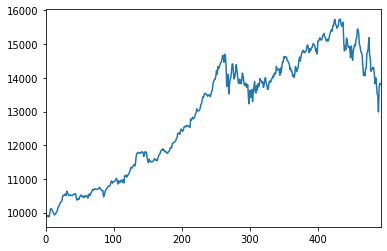

*-----Episode: 956, Reward:138.105211%-----*


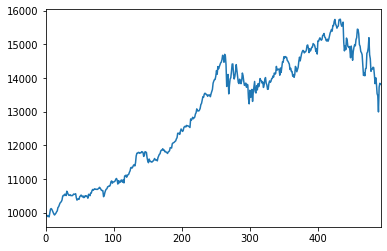

*-----Episode: 957, Reward:138.143051%-----*


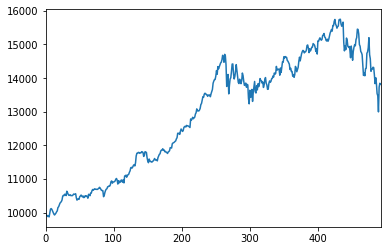

*-----Episode: 958, Reward:138.181514%-----*


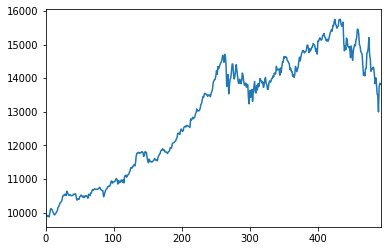

*-----Episode: 959, Reward:138.205636%-----*


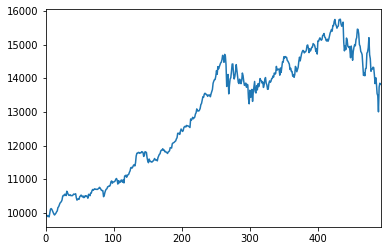

*-----Episode: 960, Reward:138.239007%-----*


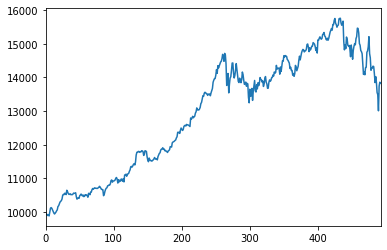

*-----Episode: 961, Reward:138.277945%-----*


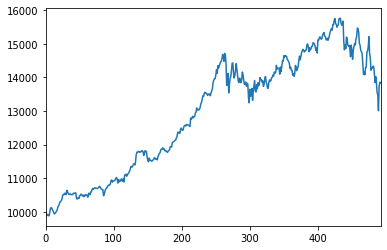

*-----Episode: 962, Reward:138.310278%-----*


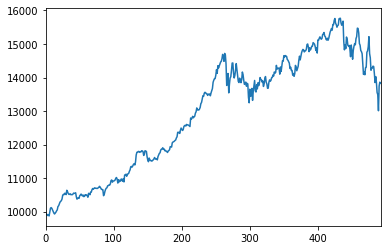

*-----Episode: 963, Reward:138.341202%-----*


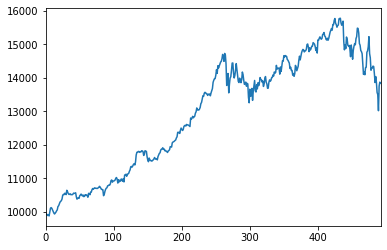

*-----Episode: 964, Reward:138.381129%-----*


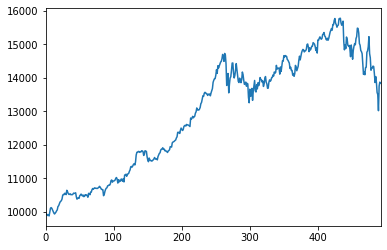

*-----Episode: 965, Reward:138.404282%-----*


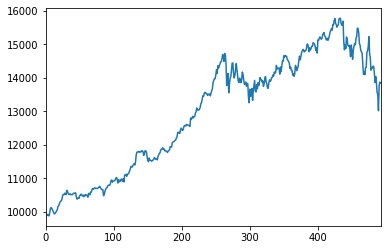

*-----Episode: 966, Reward:138.441142%-----*


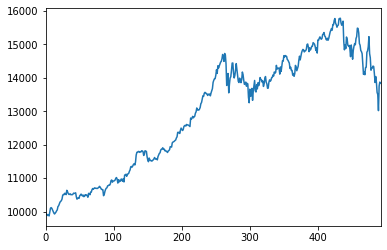

*-----Episode: 967, Reward:138.471760%-----*


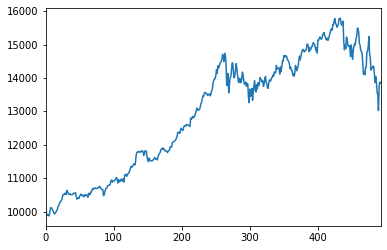

*-----Episode: 968, Reward:138.510754%-----*


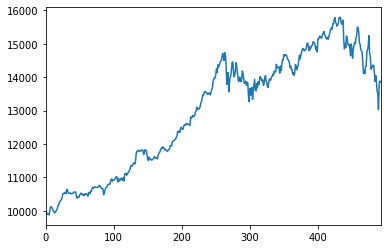

*-----Episode: 969, Reward:138.543638%-----*


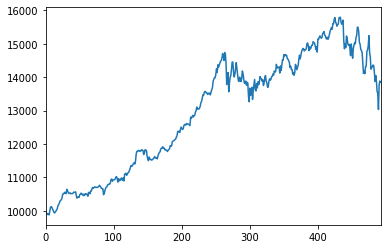

*-----Episode: 970, Reward:138.574858%-----*


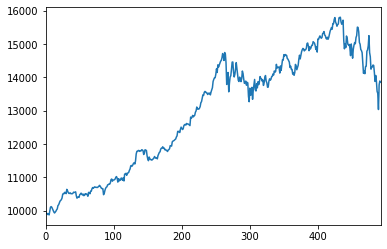

*-----Episode: 971, Reward:138.603140%-----*


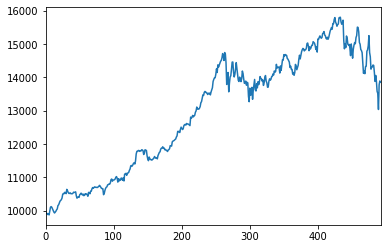

*-----Episode: 972, Reward:138.638152%-----*


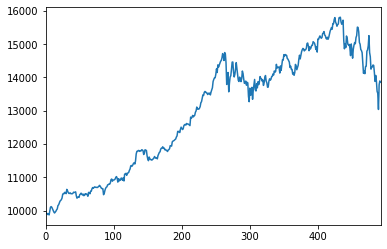

*-----Episode: 973, Reward:138.671501%-----*


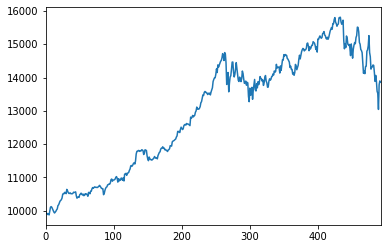

*-----Episode: 974, Reward:138.711329%-----*


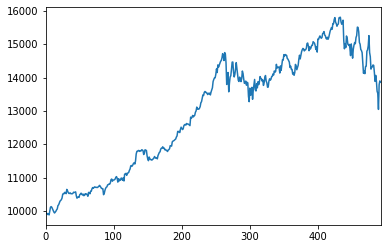

*-----Episode: 975, Reward:138.741728%-----*


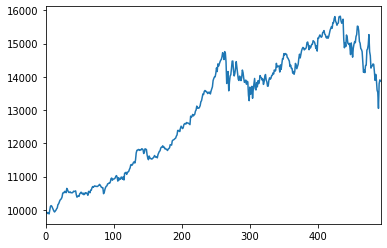

*-----Episode: 976, Reward:138.773390%-----*


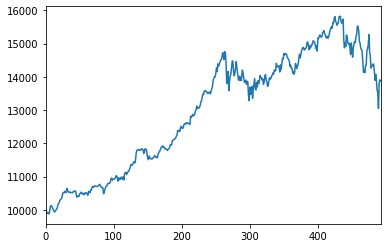

*-----Episode: 977, Reward:138.803129%-----*


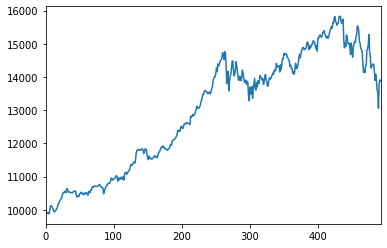

*-----Episode: 978, Reward:138.835529%-----*


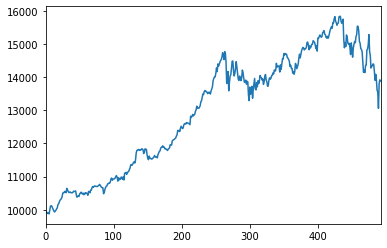

*-----Episode: 979, Reward:138.869322%-----*


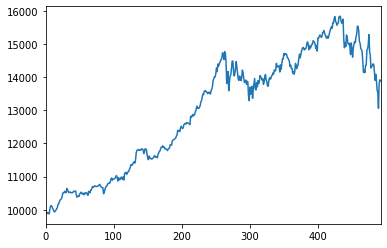

*-----Episode: 980, Reward:138.899660%-----*


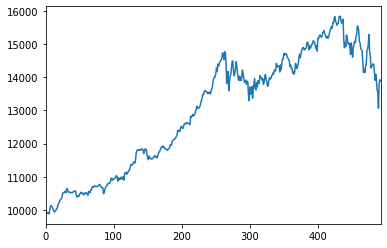

*-----Episode: 981, Reward:138.939550%-----*


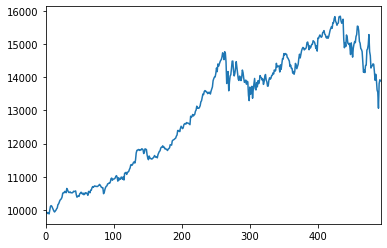

*-----Episode: 982, Reward:138.975606%-----*


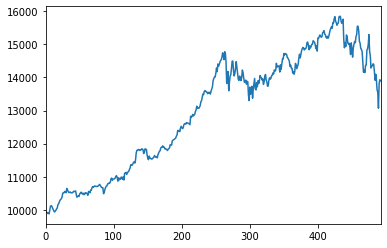

*-----Episode: 983, Reward:139.008590%-----*


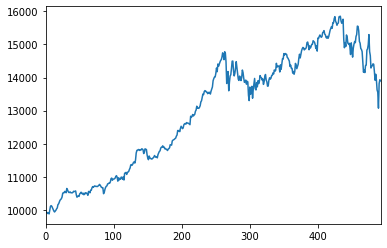

*-----Episode: 984, Reward:139.036971%-----*


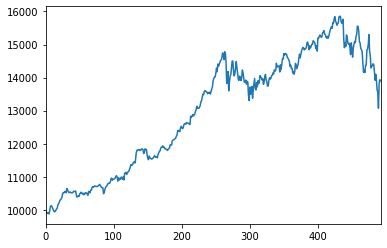

*-----Episode: 985, Reward:139.066742%-----*


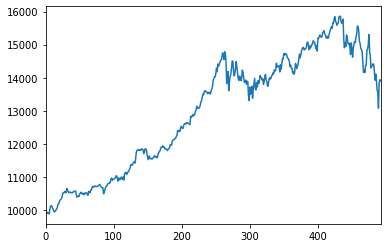

*-----Episode: 986, Reward:139.099690%-----*


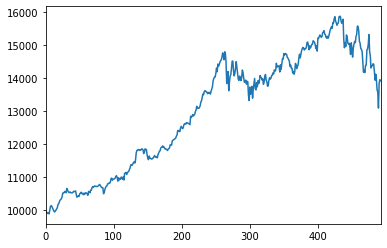

*-----Episode: 987, Reward:139.138247%-----*


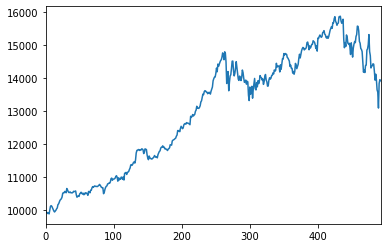

*-----Episode: 988, Reward:139.167343%-----*


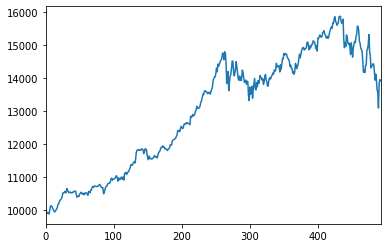

*-----Episode: 989, Reward:139.198598%-----*


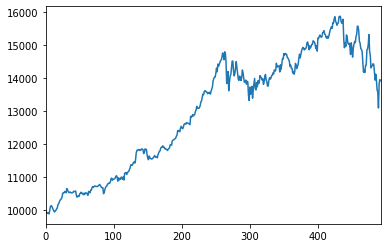

*-----Episode: 990, Reward:139.229587%-----*


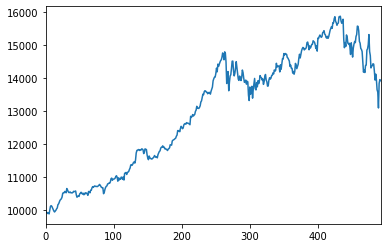

*-----Episode: 991, Reward:139.269765%-----*


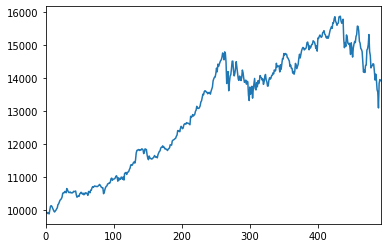

*-----Episode: 992, Reward:139.307122%-----*


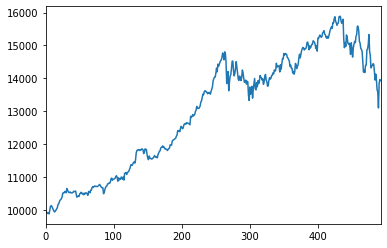

*-----Episode: 993, Reward:139.332706%-----*


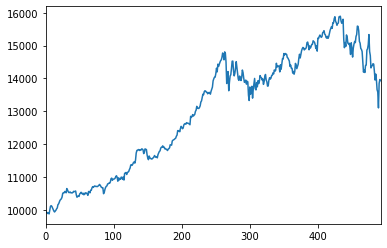

*-----Episode: 994, Reward:139.361726%-----*


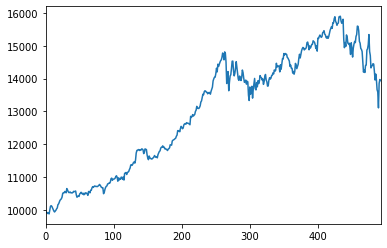

*-----Episode: 995, Reward:139.398536%-----*


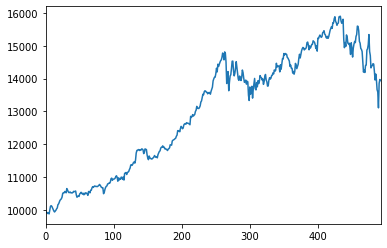

*-----Episode: 996, Reward:139.428939%-----*


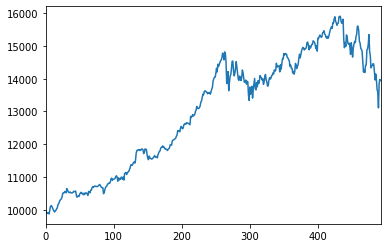

*-----Episode: 997, Reward:139.464064%-----*


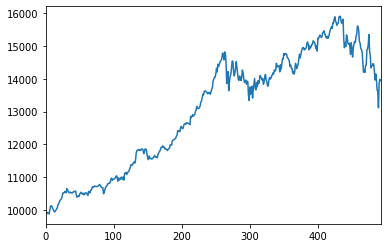

*-----Episode: 998, Reward:139.499562%-----*


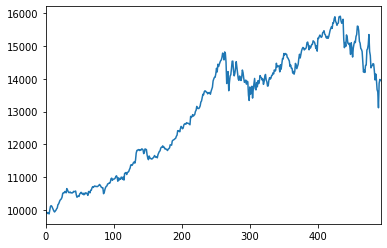

*-----Episode: 999, Reward:139.527114%-----*


In [8]:
if reload_flag == 'False':
    print("Training with {:d}".format(int(epochs)))
    # For each Epoch
    for epoch in range(epochs):

        rl.traversal(stocktrader, agent, env, epoch, trainable)

        if record_flag == 'True':
            stocktrader.write(map(lambda x: str(x), env.get_codes()), PATH_prefix)

        if plot_flag == 'True':
            stocktrader.plot_result()

        agent.reset_buffer()
        stocktrader.print_result(epoch, agent)
        stocktrader.reset()
    agent.close()
    del agent

## Test

In [9]:
with open("result/ai/PG/" + str(attempt_num) + '/config.json', 'r') as f:
    dict_data = json.load(f)

test_start_date = datetime.datetime.strptime(dict_data['test_start_date'], '%Y-%m-%d')
test_end_date = datetime.datetime.strptime(dict_data['test_end_date'], '%Y-%m-%d')
codes = dict_data['codes']

print("test_start_date: " + str(test_start_date))
print("test_end_date: " + str(test_end_date))
print("codes: " + str(codes))
print("window_length: " + str(window_length))

env.get_data(test_start_date, test_end_date, codes, features, window_length)

test_start_date: 2019-01-02 00:00:00
test_end_date: 2019-12-31 00:00:00
codes: ['KO', 'MSFT', 'GE', 'JPM', 'BA', 'F', 'IBM', 'WMT', 'XOM', 'NKE']
window_length: 3
Date set count: 252


#### Get Returns and Cumulative Returns from Backtest

In [10]:
returns, cumulative_returns = rl.backtest(
    PG(len(codes) + 1, int(window_length), len(features), nn_name, 'False', 'True', attempt_num, lr=learning_rate
    ), env, PATH_prefix, initial_investment)

#### Returns Dataframe

In [11]:
to_remove = len(env.date_set) - len(cumulative_returns)
dates = sorted(list(env.date_set))[to_remove:]

df = pd.DataFrame()
df["Date"] = dates
df["Cumulative Returns"] = cumulative_returns
df["Returns"] = [0] + returns
df.set_index('Date', inplace=True)

df.head()

,Cumulative Returns,Returns
Date,,
2019-01-14,1.000000,0.000000
2019-01-15,0.990760,-0.009240
2019-01-16,0.996499,0.005793
2019-01-17,0.992936,-0.003576
2019-01-18,1.001455,0.008580


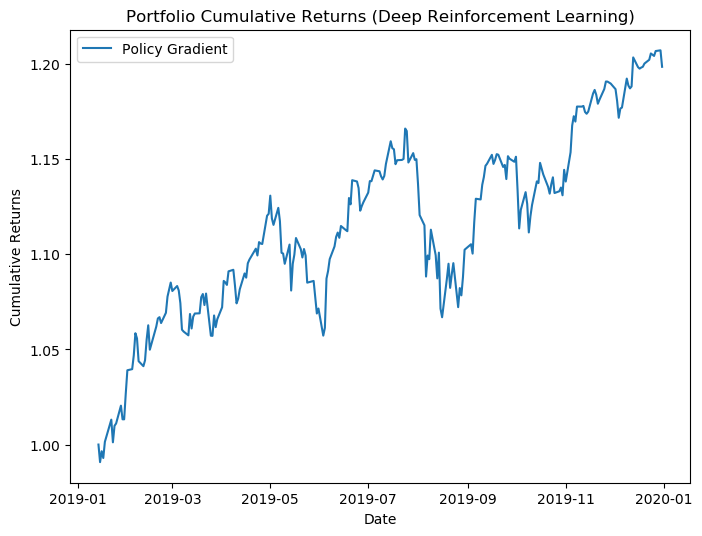

In [12]:
# PLOT
plt.figure(figsize=(8, 6), dpi=100)
plt.plot(df["Cumulative Returns"], label="Policy Gradient")
plt.title('Portfolio Cumulative Returns (Deep Reinforcement Learning)')
plt.xlabel('Date')
plt.ylabel('Cumulative Returns')
plt.legend()
plt.show()

#### Results

In [13]:
rl.ReturnsResultsTable(returns)

,Portfolio,Average Daily Yield,Sharpe Ratio,Maximum Drawdown
0,Policy Gradient,0.078,1.585,5.614


--------------------
### What about if we had NO TRANSACTION COST?

In [14]:
# Set Fixed Transaction Cost
env.set_transaction_cost(0)
# Perform the Backtest again
returns_no_tc, cumulative_returns_no_tc = rl.backtest(
    PG(len(codes) + 1, int(window_length), len(features), nn_name, 'False', 'True', attempt_num, lr=learning_rate
    ), env, PATH_prefix, initial_investment)

In [15]:
df["Cumulative Returns No Tc"] = cumulative_returns_no_tc
df["Returns No Tc"] = [0] + returns_no_tc
df.head()

,Cumulative Returns,Returns,Cumulative Returns No Tc,Returns No Tc
Date,,,,
2019-01-14,1.000000,0.000000,1.000000,0.000000
2019-01-15,0.990760,-0.009240,0.999851,-0.000149
2019-01-16,0.996499,0.005793,1.005643,0.005794
2019-01-17,0.992936,-0.003576,1.002076,-0.003547
2019-01-18,1.001455,0.008580,1.010692,0.008598


In [16]:
rl.ReturnsResultsTable(returns_no_tc)

,Portfolio,Average Daily Yield,Sharpe Ratio,Maximum Drawdown
0,Policy Gradient,0.084,1.727,5.602


--------------------
### Let's Plot these against eachother!

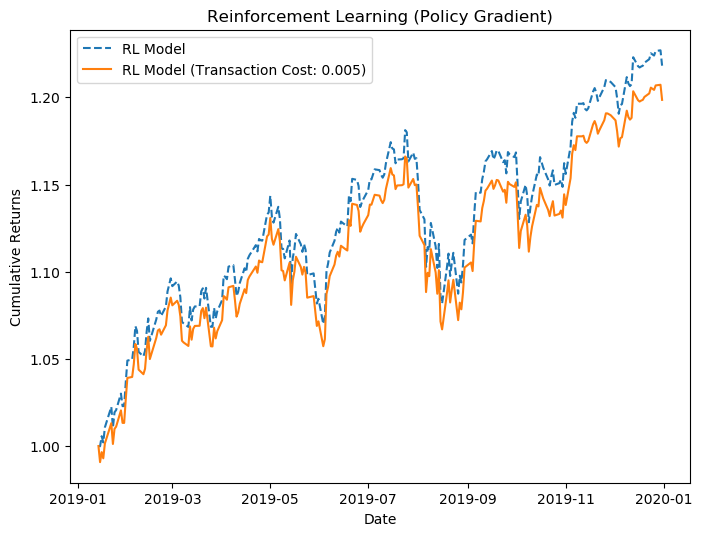

In [17]:
plt.figure(figsize=(8, 6), dpi=100)
plt.plot(df["Cumulative Returns No Tc"], label="RL Model", linestyle='--')
plt.plot(df["Cumulative Returns"], label="RL Model (Transaction Cost: " + str(fixed_transaction_cost) + ")")

plt.title('Reinforcement Learning (Policy Gradient)')
plt.xlabel('Date')
plt.ylabel('Cumulative Returns')

plt.legend()
plt.show()